# Projet Machine Learning : Notebook Python

Nous analyserons durant ce projet les relations entre les variables du jeu de données " Global Data on Sustainable Energy" que nous avions à disposition, traitant de méta-données relatives à une centaine de pays du globe. Nous essaierons dans un premier temps de tirer une analyse descriptive des données puis nous nous attacherons à appliquer différents modèles afin de préduire les valeurs de la variable "Value-co2-emissions (metric tons per capita)".

Au cours du Notebook nous introduirons les noms de variables suivants:
- **data** : jeu de données initial
- **data_normalized** : jeu de données initial normalisé
- **data2** : transformation log sur toutes les var quantitatives
- **dataBoxCox** : transformation BoxCox sur les var quantitatives
- **data3** : transformation optimale, celui qu'on garde pour la suite
- **data3_full** : transformation optimale + variables qualitatives intégrées
- **col_quali** : variables qualitatives (entity, year)


- **X_train, X_test, Y_train, Y_test** : échantillons de tests et d'apprentissage
-**X_train_quanti, X_test_quanti** : échantillon sans variables quantitatives uniquemment





Au cours du Notebook nous introduirons les noms de variables suivants:
- **data** : jeu de données initial
- **data_normalized** : jeu de données initial normalisé
- **data_log** : transformation log sur toutes les var quantitatives
- **data_log_normalized** : transformation log sur toutes les var quantitatives
- **data_BoxCox** : transformation BoxCox sur les var quantitatives
- **data_log_full_continent** : transformation optimale, celui qu'on garde pour la suite
- **data_log_full** : transformation optimale + variables qualitatives intégrées
- **col_quali** : variables qualitatives (entity, year)


- **X_train, X_test, Y_train, Y_test** : échantillons de tests et d'apprentissage
-**X_train_quanti, X_test_quanti** : échantillon sans variables quantitatives uniquemment





# Importation des librairies utiles à notre jeu de données


In [ ]:
# Ajouter les modules qui ne sont pas installés sur la machine
# !pip install
!pip install country_converter
!pip install xgboost

import pandas as pd
from pandas.plotting import scatter_matrix
import numpy as np
import random as rd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.patches as mpatches
import matplotlib.colors as mcolors
import csv
import scipy.stats as stats
import pylab
import itertools
import time
import seaborn as sns
import statsmodels.api as sm
import plotly.express as px
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.svm import SVR
from sklearn.metrics import r2_score
from sklearn.metrics import roc_curve
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import plot_tree
from sklearn.neural_network import MLPRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import scale
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn import linear_model
from sklearn.linear_model import LinearRegression
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.impute import SimpleImputer
from sklearn.impute import KNNImputer
from ipywidgets import interact, Dropdown, IntSlider
from scipy.stats import boxcox
import country_converter as coco
import xgboost as xgb
sns.set_style('darkgrid')

# **I -Analyse exploratoire des données**




#  **1- Chargement du jeu de données**

# A- Mise en contexte

In [ ]:
data = pd.read_csv("data_kaggle.csv",sep = ",")
data.head()

,Entity,Year,Access to electricity (% of population),Access to clean fuels for cooking,Renewable-electricity-generating-capacity-per-capita,Financial flows to developing countries (US $),Renewable energy share in the total final energy consumption (%),Electricity from fossil fuels (TWh),Electricity from nuclear (TWh),Electricity from renewables (TWh),...,Primary energy consumption per capita (kWh/person),Energy intensity level of primary energy (MJ/$2017 PPP GDP),Value_co2_emissions_kt_by_country,Renewables (% equivalent primary energy),gdp_growth,gdp_per_capita,Density\n(P/Km2),Land Area(Km2),Latitude,Longitude
0,Afghanistan,2000,1.613591,6.2,9.22,20000.0,44.99,0.16,0.0,0.31,...,302.59482,1.64,760.000000,NaN,NaN,NaN,60.0,652230.0,33.93911,67.709953
1,Afghanistan,2001,4.074574,7.2,8.86,130000.0,45.60,0.09,0.0,0.50,...,236.89185,1.74,730.000000,NaN,NaN,NaN,60.0,652230.0,33.93911,67.709953
2,Afghanistan,2002,9.409158,8.2,8.47,3950000.0,37.83,0.13,0.0,0.56,...,210.86215,1.40,1029.999971,NaN,NaN,179.426579,60.0,652230.0,33.93911,67.709953
3,Afghanistan,2003,14.738506,9.5,8.09,25970000.0,36.66,0.31,0.0,0.63,...,229.96822,1.40,1220.000029,NaN,8.832278,190.683814,60.0,652230.0,33.93911,67.709953
4,Afghanistan,2004,20.064968,10.9,7.75,NaN,44.24,0.33,0.0,0.56,...,204.23125,1.20,1029.999971,NaN,1.414118,211.382074,60.0,652230.0,33.93911,67.709953


In [ ]:
data.shape

(3649, 21)

Nous avons à notre disposition un jeu de données intitulé " Global Data on Sustainable Energy" issu du site de concours d'apprentissage automatique KAGGLE. Ce jeu de données comprend 3649 observations et inclue 21 variables qui couvrent différentes caractéristiques liées à la consommation énergétique et à la géographie de 176 pays du monde entre les années 2000 et 2020.

Les variables sont les suivantes:
- **Entity**: Nom du pays ou de la région pour lequel les données sont rapportées.
- Year: Année pour laquelle les données sont communiquées, entre 2000 et 2020.
- **Access to electricity (% of population)**: Pourcentage de la population ayant accès à l’électricité.
- Access to clean fuels for cooking (% of population): Pourcentage de la population qui utilise
principalement des combustibles propres.
- **Renewable-electricity-generating-capacity-per-capita**: Capacité installée d’énergie renouvelable
par personne.
- **Financial flows to developing countries (US Dollars)**: Aide et assistance des pays développés pour
les projets d’énergie propre.
- Renewable energy share in total final energy consumption (%): Pourcentage d’énergie renouvelable dans la consommation d’énergie finale.
- **Electricity from fossil fuels (TWh)**: Électricité produite à partir de combustibles fossiles (charbon,
pétrole, gaz) en térawattheures.
- **Electricity from nuclear (TWh)**: Électricité produite à partir de l’énergie nucléaire en térawattheures.
- Electricity from renewables (TWh): Électricité produite à partir de sources renouvelables (hydroélectricité, énergie solaire, énergie éolienne, etc.) en térawattheures.
- Low-carbon electricity (% electricity): Pourcentage d’électricité provenant de sources à faible teneur
en carbone (nucléaire et énergies renouvelables).
- **Primary energy consumption per capita (kWh/person)**: Consommation d’énergie par personne
en kilowattheures.
- **Energy intensity level of primary energy (MJ/2011 PPP GDP)**: Consommation d’énergie par
unité de PIB à parité de pouvoir d’achat.
- **Value-co2-emissions (metric tons per capita)**: Émissions de dioxyde de carbone par personne en
tonnes métriques.
- **Renewables (% equivalent primary energy)**: Équivalent énergie primaire provenant de sources renouvelables.
- **GDP growth (annual %)**: Taux de croissance annuel du PIB en monnaie locale constante.
- **GDP per capita**: Produit intérieur brut (PIB) par personne.
- **Density (P/Km2)**: Densité de population en personnes par kilomètre carré.
- **Land Area (Km2)**: Surface terrestre totale en kilomètres carrés.
- **Latitude**: Latitude du centroïde du pays en degrés décimaux.
- **Longitude**: Longitude du centroïde du pays en degrés décimaux.

Le but de ce projet consistera à prédire à partir de l'ensemble des autres variables la valeur de la variable Value-co2-emissions, et d'estimer la performance des différents modèles que nous utiliserons.

Dans un premier temps, nous réaliserons une analyse exploratoire des données pour se familiariser avec les variables et transformer si nécessaire les données pour les rendre exploitables à notre étude. Pour déterminer cela, nous nous attacherons à effectuer une analyse descriptive unidimensionnelle et multidimensionnelle des données, ce qui nous aidera également à identifier des dépendances entre les variables.

# B- Vérification du type des variables

In [ ]:
data.dtypes

Entity                                                               object
Year                                                                  int64
Access to electricity (% of population)                             float64
Access to clean fuels for cooking                                   float64
Renewable-electricity-generating-capacity-per-capita                float64
Financial flows to developing countries (US $)                      float64
Renewable energy share in the total final energy consumption (%)    float64
Electricity from fossil fuels (TWh)                                 float64
Electricity from nuclear (TWh)                                      float64
Electricity from renewables (TWh)                                   float64
Low-carbon electricity (% electricity)                              float64
Primary energy consumption per capita (kWh/person)                  float64
Energy intensity level of primary energy (MJ/$2017 PPP GDP)         float64
Value_co2_em

In [ ]:
data.describe()

,Year,Access to electricity (% of population),Access to clean fuels for cooking,Renewable-electricity-generating-capacity-per-capita,Financial flows to developing countries (US $),Renewable energy share in the total final energy consumption (%),Electricity from fossil fuels (TWh),Electricity from nuclear (TWh),Electricity from renewables (TWh),Low-carbon electricity (% electricity),Primary energy consumption per capita (kWh/person),Energy intensity level of primary energy (MJ/$2017 PPP GDP),Value_co2_emissions_kt_by_country,Renewables (% equivalent primary energy),gdp_growth,gdp_per_capita,Density\n(P/Km2),Land Area(Km2),Latitude,Longitude
count,3649.000000,3639.000000,3480.000000,2718.000000,1.560000e+03,3455.000000,3628.000000,3523.000000,3628.000000,3607.000000,3649.000000,3442.000000,3.221000e+03,1512.000000,3332.000000,3367.000000,3648.000000,3.648000e+03,3648.000000,3648.000000
mean,2010.038367,78.933702,63.255287,113.137498,9.422400e+07,32.638165,70.365003,13.450190,23.968010,36.801182,25743.981745,5.307345,1.598665e+05,11.986707,3.441610,13283.774348,223.573191,6.332135e+05,18.246388,14.822695
std,6.054228,30.275541,39.043658,244.167256,2.981544e+08,29.894901,348.051866,73.006623,104.431085,34.314884,34773.221366,3.532020,7.736611e+05,14.994644,5.686720,19709.866716,683.463448,1.585519e+06,24.159232,66.348148
min,2000.000000,1.252269,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.110000,1.000000e+01,0.000000,-62.075920,111.927225,2.000000,2.100000e+01,-40.900557,-175.198242
25%,2005.000000,59.800890,23.175000,3.540000,2.600000e+05,6.515000,0.290000,0.000000,0.040000,2.877847,3116.737300,3.170000,2.020000e+03,2.137095,1.383302,1337.813437,34.000000,2.571300e+04,3.202778,-11.779889
50%,2010.000000,98.361570,83.150000,32.910000,5.665000e+06,23.300000,2.970000,0.000000,1.470000,27.865068,13120.570000,4.300000,1.050000e+04,6.290766,3.559855,4578.633208,87.000000,1.176000e+05,17.189877,19.145136
75%,2015.000000,100.000000,100.000000,112.210000,5.534750e+07,55.245000,26.837500,0.000000,9.600000,64.403792,33892.780000,6.027500,6.058000e+04,16.841638,5.830099,15768.615365,219.000000,5.131200e+05,38.969719,46.199616
max,2020.000000,100.000000,100.000000,3060.190000,5.202310e+09,96.040000,5184.130000,809.410000,2184.940000,100.000010,262585.700000,32.570000,1.070722e+07,86.836586,123.139555,123514.196700,8358.000000,9.984670e+06,64.963051,178.065032


 Nous commençons l'analyse exploratoire en identifiant le types des 18 variables que nous avons à notre disposition. Il convient donc d'identifier les variables qualitatives et les variables quantitatives pour notre étude. La variable Entity correspondant au nom du pays associé aux données relevées est une variable qualitative (car de type object). Toutefois, la variable Year est notée quantitative mais peut elle aussi être considérée comme une variable qualitative ordinale pouvant prendre 20 valeurs de '2000' à '2020'. C'est pourquoi nous allons la convertir en variable qualitative ci-après. D'autre part la variable "Density" représente une quantité de population au Km² et nécessiterait donc d'etre quantitative et non de type object. Toutes les autres variables sont des variables quantiatives de type 'sfloat64' ou 'int64'.


# C- Convertion de la variable 'Year' en variable qualitative

In [ ]:
data['Year'] = data['Year'].astype(str)
data.dtypes

Entity                                                               object
Year                                                                 object
Access to electricity (% of population)                             float64
Access to clean fuels for cooking                                   float64
Renewable-electricity-generating-capacity-per-capita                float64
Financial flows to developing countries (US $)                      float64
Renewable energy share in the total final energy consumption (%)    float64
Electricity from fossil fuels (TWh)                                 float64
Electricity from nuclear (TWh)                                      float64
Electricity from renewables (TWh)                                   float64
Low-carbon electricity (% electricity)                              float64
Primary energy consumption per capita (kWh/person)                  float64
Energy intensity level of primary energy (MJ/$2017 PPP GDP)         float64
Value_co2_em

Nous avons désormais converti la variable Year en variable qualitative. Dans la partie suivante, nous convertirons la variable Density en variable quantitative. Le type 'object' qui lui a été attribué est dû à un problème de séparateur, ce qui l'empêche d'être considéré comme une variable numérique. Nous allons ainsi remplacer le séparateur ',' par un '.' et la convertir en variable numérique.

# D- Correction sur la variable density

In [ ]:
data.iloc[:, 17] = pd.to_numeric(data.iloc[:, 17], errors = 'coerce')
data.dtypes

Entity                                                               object
Year                                                                 object
Access to electricity (% of population)                             float64
Access to clean fuels for cooking                                   float64
Renewable-electricity-generating-capacity-per-capita                float64
Financial flows to developing countries (US $)                      float64
Renewable energy share in the total final energy consumption (%)    float64
Electricity from fossil fuels (TWh)                                 float64
Electricity from nuclear (TWh)                                      float64
Electricity from renewables (TWh)                                   float64
Low-carbon electricity (% electricity)                              float64
Primary energy consumption per capita (kWh/person)                  float64
Energy intensity level of primary energy (MJ/$2017 PPP GDP)         float64
Value_co2_em

Maintenant que toutes les variables disposent du bon type, nous allons calculer le taux de valeurs manquantes par variables et supprimer les variables possédant un taux de valeurs manquantes trop important afin de garder un ensemble de variables exploitables.

# **2- Détermination du taux de valeurs manquantes**

In [ ]:
missing_values = data.isna().sum()
missing_values_num = data.isnull().sum()
missing_values_prop = (missing_values_num / len(data)).sort_values(ascending = False)
print(missing_values_prop[missing_values_prop > 0])

Renewables (% equivalent primary energy)                            0.585640
Financial flows to developing countries (US $)                      0.572486
Renewable-electricity-generating-capacity-per-capita                0.255138
Value_co2_emissions_kt_by_country                                   0.117292
gdp_growth                                                          0.086873
gdp_per_capita                                                      0.077281
Energy intensity level of primary energy (MJ/$2017 PPP GDP)         0.056728
Renewable energy share in the total final energy consumption (%)    0.053165
Access to clean fuels for cooking                                   0.046314
Electricity from nuclear (TWh)                                      0.034530
Low-carbon electricity (% electricity)                              0.011510
Electricity from renewables (TWh)                                   0.005755
Electricity from fossil fuels (TWh)                                 0.005755

On remarque que trois des 21 variables ont plus de 25% de données manquantes. Il est ainsi pertinent de les retirer de notre analyse et de ne conserver que les 18 autres variables dont la proportion de données manquantes est inférieure à 12%.

# **3- Suppression des valeurs manquantes**

In [ ]:
# On supprime les valeurs manquantes des trois variables qui en ont le plus (plus de 25%)
data = data.drop(missing_values_prop.head(3).index, axis = 1)
dataNA = data
data.shape

(3649, 18)

Néanmoins, sur les 3649 individus, on peut conjecturer qu'il y a beaucoup d'individus disposant de valeurs manquantes qui risquent de fausser notre analyse. Nous les retirons donc à l'aide des commandes suivantes.

In [ ]:
# Suppression des valeurs manquantes
data = data.dropna()
data.shape

(2868, 18)

In [ ]:
# Etude du pourcentage de valeurs nulles restantes dans le jeu de données
missing_values_num = data.isnull().sum()
missing_values_prop = missing_values_num / len(data)
print(missing_values_prop)
print("")
print("")
print(data.describe())
data.to_csv('data_cor.csv', index = False)

Entity                                                              0.0
Year                                                                0.0
Access to electricity (% of population)                             0.0
Access to clean fuels for cooking                                   0.0
Renewable energy share in the total final energy consumption (%)    0.0
Electricity from fossil fuels (TWh)                                 0.0
Electricity from nuclear (TWh)                                      0.0
Electricity from renewables (TWh)                                   0.0
Low-carbon electricity (% electricity)                              0.0
Primary energy consumption per capita (kWh/person)                  0.0
Energy intensity level of primary energy (MJ/$2017 PPP GDP)         0.0
Value_co2_emissions_kt_by_country                                   0.0
gdp_growth                                                          0.0
gdp_per_capita                                                  

Il reste finalement bien 2868 lignes, c'est à dire 2868 individus sans aucune valeur manquante parmi eux. Les données ont été complètement traitées et sont maintenant exploitables. Dans la partie suivante, nous visualiserons leur distribution à l'aide d'un boxplot et une analyse unidimensionnelle des variables afin de déterminer quelles transformations serait pertinentes à appliquer sur nos variables avant d'étudier leurs dépendances et la modélisation prédictive de la variable CO2.

# **4- Analyse unidimensionele des données**

Une première étape requiert de comparer les résultats de boxplot sur les données bruts et les données centrées réduites pour analyser la distribution des données et leurs échelles.

# A-Centre réduction des données et étude des Boxplots

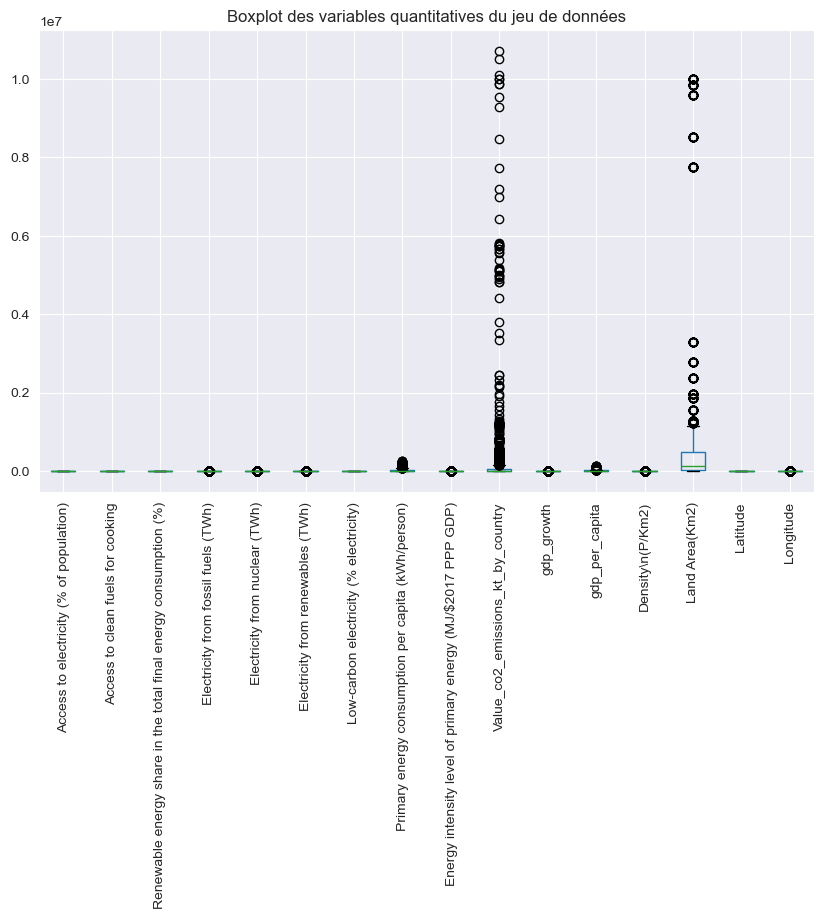

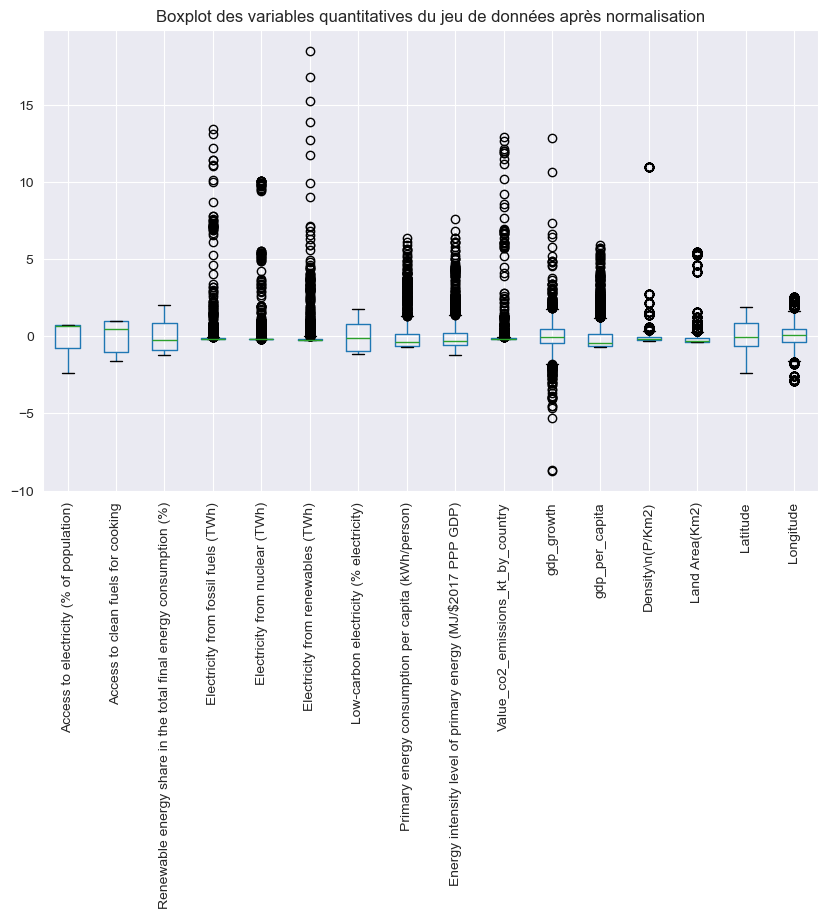

In [ ]:
# On regroupe les variables quantitatives et on centre réduit les données
quantitative_variables = data.select_dtypes(include = ['int', 'float']).columns
scaler = StandardScaler()
data_normalized = scaler.fit_transform(data[quantitative_variables])
data_normalized = pd.DataFrame(data_normalized, columns = quantitative_variables)

# Boxplot
data[quantitative_variables].boxplot(figsize = (10, 6))
plt.title('Boxplot des variables quantitatives du jeu de données')
plt.xticks(rotation = 90)
plt.show()

# Boxplot normalisé
data_normalized[quantitative_variables].boxplot(figsize = (10, 6))
plt.title('Boxplot des variables quantitatives du jeu de données après normalisation')
plt.xticks(rotation = 90)
plt.show()

On repère un grand nombre d'anomalies matérialisées par beaucoup d'outliers dans les données. Les valeurs des variables semblent toutes positives. Deux variables se distinguent sur l'aperçu du boxplot (non centré ni réduit) : les variables Value_CO2_emission et Land Area, qui semblent avoir des valeurs bien plus grandes que les autres variables et indiquer une très grande disparité et hétérogénéité entre les pays, au vu du très grand nombre d'outliers visible. C'est pourquoi nous traçons également le boxplot des données normalisées.

Certaines variables quantitatives correspondent en effet à des pourcentages, d'autres non, ce qui limite la visibilité et l'interprétabilité des boxplots. Et l'on repère que les allures des boxplots et des quantile semblent énormément différer entre les variables. Ainsi, pour la suite de l'analyse exploratoire, nous pouvons déduire que ces variables quantitatives ne sont pas toutes à la même échelle et qu'une étape de normalisation ou de transformations sur les variables est nécessaire pour les rendre plus exploitables. Pour mettre en relief ceci, visualisons la distribution des variables Value_CO2 et Land Area, sous forme d'histogramme

# B- Analyse unidimensionnelle des variables quantitatives et étude de l'impact de la normalisation sur les variables

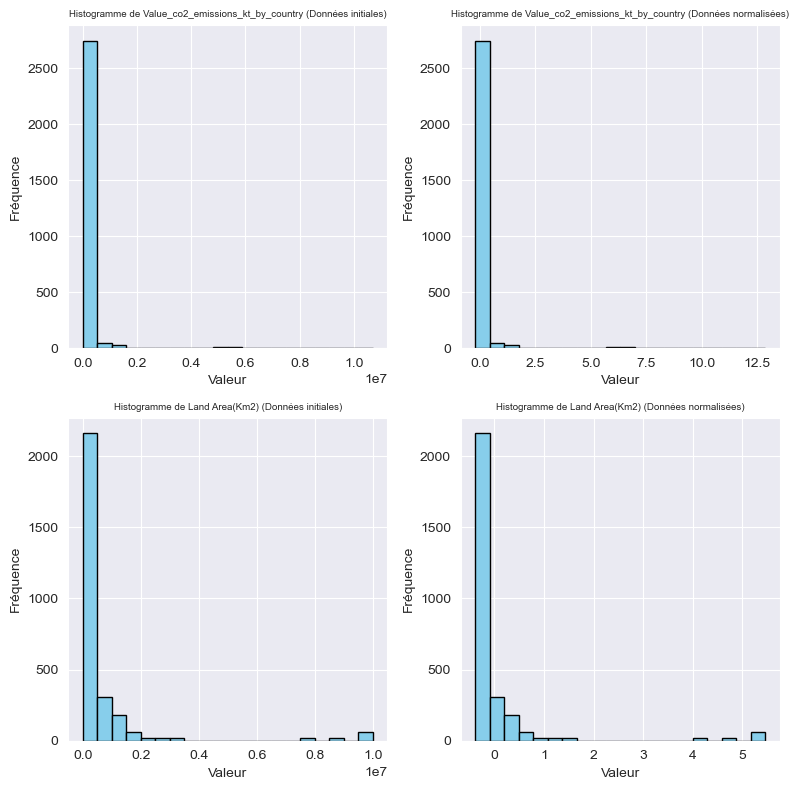

In [ ]:
plt.figure(figsize=(8, 8))

# Histogramme de Value_co2_emissions_kt_by_country
plt.subplot(2, 2, 1)
plt.hist(data['Value_co2_emissions_kt_by_country'], bins = 20, color = 'skyblue', edgecolor = 'black')
plt.title('Histogramme de Value_co2_emissions_kt_by_country (Données initiales)', fontsize = 7)
plt.xlabel('Valeur')
plt.ylabel('Fréquence')
plt.grid(True)

# Histogramme de Land Area(Km2)
plt.subplot(2, 2, 3)
plt.hist(data['Land Area(Km2)'], bins = 20, color = 'skyblue', edgecolor = 'black')
plt.title('Histogramme de Land Area(Km2) (Données initiales)', fontsize = 7)
plt.xlabel('Valeur')
plt.ylabel('Fréquence')
plt.grid(True)

# On normalise les données et on regarde à quoi les nouveaux histogrammes ressemblent
scaler = StandardScaler()
data_normalized = scaler.fit_transform(data[['Value_co2_emissions_kt_by_country']])
data_normalized = pd.DataFrame(data_normalized, columns = ['Value_co2_emissions_kt_by_country'])

# Histogramme de Value_co2_emissions_kt_by_country normalisé
plt.subplot(2, 2, 2)
plt.hist(data_normalized['Value_co2_emissions_kt_by_country'], bins = 20, color = 'skyblue', edgecolor = 'black')
plt.title('Histogramme de Value_co2_emissions_kt_by_country (Données normalisées)', fontsize = 7)
plt.xlabel('Valeur')
plt.ylabel('Fréquence')
plt.grid(True)

scaler = StandardScaler()
data_normalized = scaler.fit_transform(data[['Land Area(Km2)']])
data_normalized = pd.DataFrame(data_normalized, columns = ['Land Area(Km2)'])

# Histogramme de Land Area(Km2) normalisé
plt.subplot(2, 2, 4)
plt.hist(data_normalized['Land Area(Km2)'], bins = 20, color = 'skyblue', edgecolor = 'black')
plt.title('Histogramme de Land Area(Km2) (Données normalisées)', fontsize = 7)
plt.xlabel('Valeur')
plt.ylabel('Fréquence')
plt.grid(True)

plt.tight_layout()
plt.show()

L'histogramme confirme l'énorme disparité entre les pays, ici concernant les variables émissions de CO2 et Land Area (celles prenant les plus grandes valeurs sur le box plot non normalisé. Concernant la variable d'emissions de CO2, une tres grande majorité des pays semble présenter des valeurs d'émissions très faibles et quelques pays qui prendront la forme d'outliers sur le boxplot émettent énormément. Les valeurs ont une étendue très grande si bien que l'echelle s'exprime sur des graduations tous les 10^7 tonnes métriques. Même une fois normalisées, les valeurs prises pour ces variables demeurent très grandes pour quelques outliers. Le cas de ces variables semble pathologique de la présence d'un très grand nombre de pays 'outliers' dans les données et se généraliser à d'autres variables. Nous pouvons ainsi repérer les mêmes conclusions sur la variable Electricity from Nuclear notamment, qui est, d'après le boxplot une fois normalisé, une des variables semblant présenter le plus d'outliers.

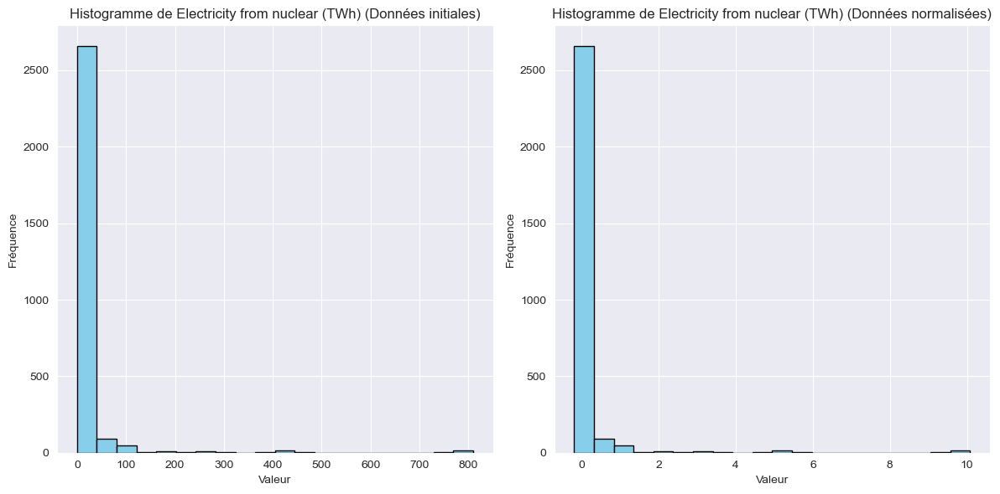

In [ ]:
# Histogramme de Electricity from nuclear (TWh)
plt.figure(figsize = (12, 6))
plt.subplot(1, 2, 1)
plt.hist(data['Electricity from nuclear (TWh)'], bins = 20, color = 'skyblue', edgecolor = 'black')
plt.title('Histogramme de Electricity from nuclear (TWh) (Données initiales)')
plt.xlabel('Valeur')
plt.ylabel('Fréquence')
plt.grid(True)

# On centre réduit
scaler = StandardScaler()
data_normalized = scaler.fit_transform(data[['Electricity from nuclear (TWh)']])
data_normalized = pd.DataFrame(data_normalized, columns = ['Electricity from nuclear (TWh)'])

# Histogramme de Electricity from nuclear (TWh) normalisé
plt.subplot(1, 2, 2)
plt.hist(data_normalized['Electricity from nuclear (TWh)'], bins = 20, color = 'skyblue', edgecolor = 'black')
plt.title('Histogramme de Electricity from nuclear (TWh) (Données normalisées)')
plt.xlabel('Valeur')
plt.ylabel('Fréquence')
plt.grid(True)

plt.tight_layout()
plt.show()

On retient donc en centre réduisant les variables le même constat d'hétérogénéité mais les données sont davantage interprétables que pour leur version brut. L'accès à l'énergie, notamment à certaines sources d'électricité pour les pays semble être source de disparités particulièrement importantes puisque 3 des variables concentrant le plus d'outliers concernent les variables liées à l'électricité issu du nucléaire, des énergies renouvelables et fossiles. Pour l'électricité issu des énergies fossiles et du nucléaire, cela s'explique par le fait que peu de pays disposent de la puissance nucléaire ou d'énergies fossiles à leur disposition sur leur territoire. Avec tant de variabilité et d'outliers, l'allure de ces graphes suggère qu'une transformation logarithmique serait nécessaire pour les données, tant leur distribution semble asymétrique et leur variance semble grande. Il serait également intéressant d'identifier clairement l'identité des pays à l'origine de ces outliers et leurs occurences.

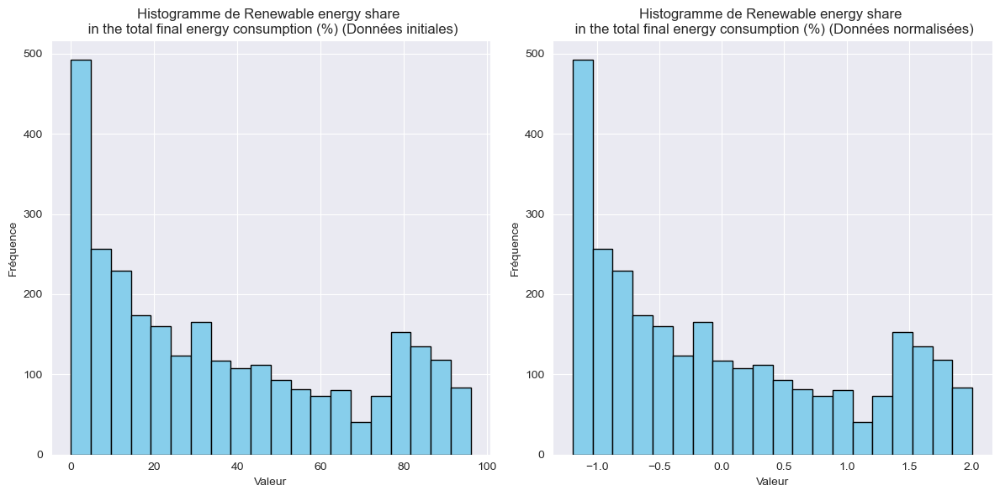

In [ ]:
# Histogramme de Renewable energy share in the total final energy consumption (%)
plt.figure(figsize = (12, 6))
plt.subplot(1, 2, 1)
plt.hist(data['Renewable energy share in the total final energy consumption (%)'], bins = 20, color = 'skyblue', edgecolor = 'black')
plt.title('Histogramme de Renewable energy share \n in the total final energy consumption (%) (Données initiales)')
plt.xlabel('Valeur')
plt.ylabel('Fréquence')
plt.grid(True)

# On centre réduit
scaler = StandardScaler()
data_normalized = scaler.fit_transform(data[['Renewable energy share in the total final energy consumption (%)']])
data_normalized = pd.DataFrame(data_normalized, columns = ['Renewable energy share in the total final energy consumption (%)'])

# Histogramme de Renewable energy share in the total final energy consumption (%) normalisé
plt.subplot(1, 2, 2)
plt.hist(data_normalized['Renewable energy share in the total final energy consumption (%)'], bins = 20, color = 'skyblue', edgecolor = 'black')
plt.title('Histogramme de Renewable energy share \n in the total final energy consumption (%) (Données normalisées)')
plt.xlabel('Valeur')
plt.ylabel('Fréquence')
plt.grid(True)

plt.tight_layout()
plt.show()

Les variables ramenées à une proportion sur les ressources énergétiques totales du pays comme les variables "Renewable energy share in the total final energy consumption (%)" et "Low carbon electricity (%)" sont les seules à ne pas présenter d'outliers mais cela est tout à fait normal puisqu'elles sont les seules à s'exprimer en pourcentages et leurs histogrammes vont aussi dans le sens d'une très grande hétérogénéité des données

A nouveau, nous remarquons une nette distribution hétérogène des données, surtout pour les variables liées aux sources d'éléctricité, preuve d'une grande disparité en matière de ressources énergétiques entre les pays.

# 5- **Cas particulier : étude de la variable 'Value_co2_emissions_kt_by_country'**

# A - Analyse des pays les plus émetteurs en CO2

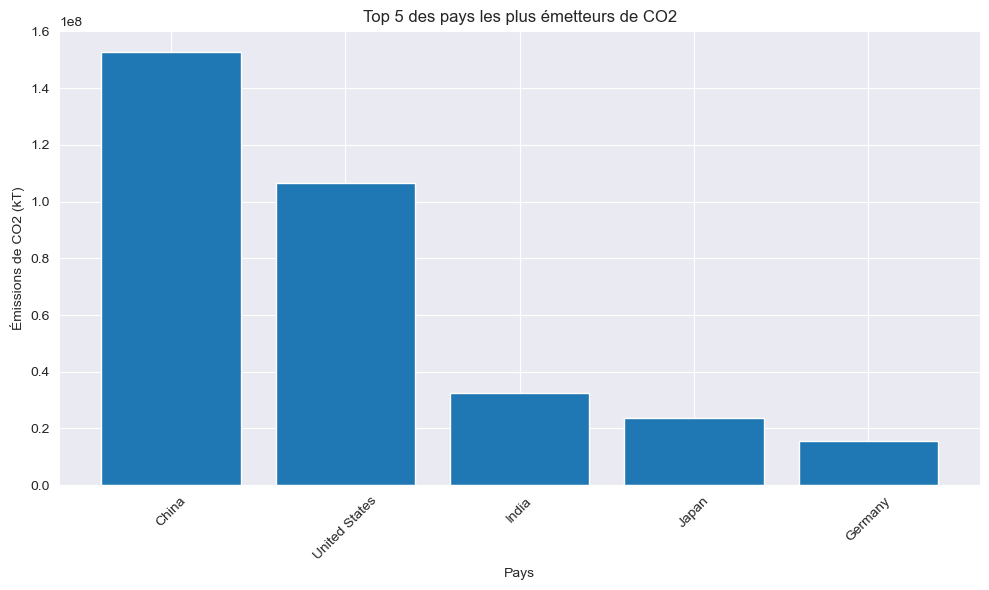

In [ ]:
# Top 5 des pays émetteurs de CO2

# On regroupe les valeurs de la variable CO2 pour un même pays et on les somme
pays_emetteurs = data.groupby('Entity')['Value_co2_emissions_kt_by_country'].sum()
# On conserve les 5 pays ayant la plus grande valeur de CO2 cumulée
pays_emetteurs = pays_emetteurs.sort_values(ascending = False).head(5)

plt.figure(figsize = (10, 6))
plt.bar(pays_emetteurs.index, pays_emetteurs.values)
plt.xlabel('Pays')
plt.ylabel('Émissions de CO2 (kT)')
plt.title('Top 5 des pays les plus émetteurs de CO2')
plt.xticks(rotation = 45)
plt.tight_layout()
plt.show()

Les 5 pays les plus grands émetteurs de CO2 dans notre jeu de données entre les années 2000 et 2020 sont donc dans l'ordre : la Chine (150 millions de kt de CO3 émis), les Etats-Unis (105 millions de kT), l'Inde (33 millions de kT), le Japon (24 millions de kT) et l'Allemagne (15 millions de kT). Ces pays semblent avoir un profil particulier. Il conviendra de vérifier si ce sont principalement ces pays qui sont à l'origine des valeurs extrêmes relevées sur les boxplot. Une autre observation que l'on peut faire à partir de la variable Value_CO2 est la grande étendue de valeurs dans le jeu de données entre les pays (a minima sur cette variable). Il sera nécessaire d'analyser cette grande disparité d'échelle entre pays sur le reste des variables. Pour vérifier cela, on peut tracer la distribution des émissions de CO2 à l'aide de la carte suivante.

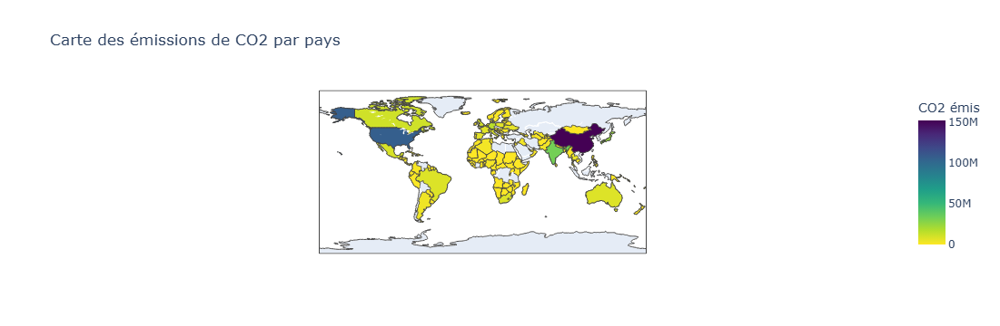

In [ ]:
CO2_emissions = data.groupby('Entity', as_index = False).agg(Somme_CO2 = ('Value_co2_emissions_kt_by_country','sum'))
fig = px.choropleth(CO2_emissions,
                    locations = 'Entity',
                    locationmode = 'country names',
                    color = 'Somme_CO2',
                    hover_name = 'Entity',
                    hover_data = {'Entity': False, 'Somme_CO2': True},
                    color_continuous_scale = px.colors.sequential.Viridis_r,
                    title = 'Carte des émissions de CO2 par pays',
                    labels = {'Somme_CO2': 'CO2 émis'})
fig.update_geos(showcountries = True, countrycolor = 'rgb(255,255,255)')
fig.show()

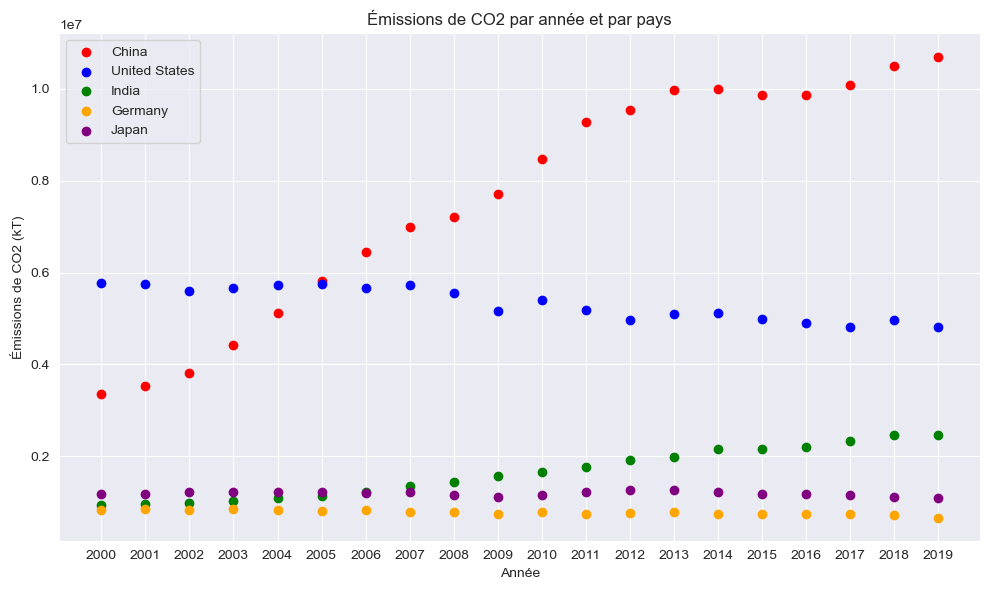

In [ ]:
# Attribution d'une couleur par pays pour les 5 plus grands émetteurs de CO2
pays_couleur = {'China': 'red', 'United States': 'blue', 'India': 'green', 'Germany': 'orange', 'Japan': 'purple'}

plt.figure(figsize = (10, 6))

# Scatter plot des émissions de CO2 par année et par pays
for pays, couleur in pays_couleur.items():
    data_pays = data[data['Entity'] == pays]
    plt.scatter(data_pays['Year'], data_pays['Value_co2_emissions_kt_by_country'], color = couleur, label = pays)

plt.xlabel('Année')
plt.ylabel('Émissions de CO2 (kT)')
plt.title('Émissions de CO2 par année et par pays')
plt.legend()
plt.tight_layout()
plt.show()

Une dernière observation que l'on peut faire est que la Chine, premier pays en terme d'émissions annuelles de CO2 est dans une dynamique particulière d'augmentation de ses émissions depuis 20 ans et qu'elle est le pays le plus émetteur de CO2 seulement depuis 2005. Il semble donc exister des profils et des dynamiques reliées au temps et aux années, qu'il pourrait être utile de préciser au cours d'une analyse bidimensionnelle entre la variable Year et le reste des variables.

# B- Constat d'une grande hétérogénéité et nécessité d'une nouvelle transformation sur les donneés

[ Rajouter paragraphe sur l'intéret de transformations sur les données pour réduire la variance, rendre les données davantage gaussiennes, faire data 3 d'applications du log sur une seule partie des données  +tracer leurs histogrammes après et dire en quoi c'est mieux ] !!!!

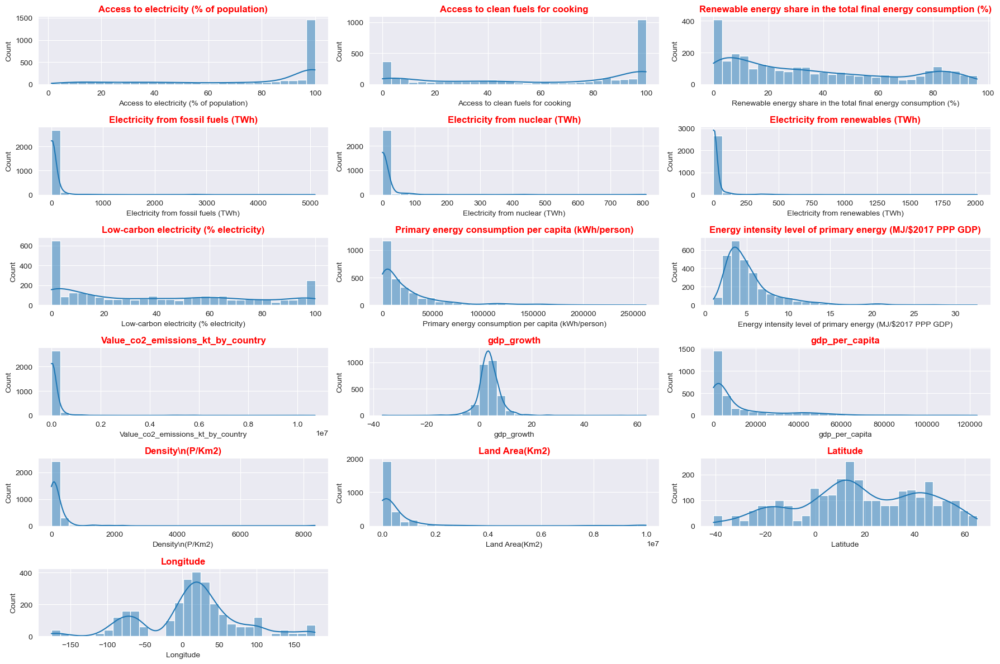

In [ ]:
plt.figure(figsize = (18, 12))

# Détermination du nombre de lignes et de colonnes pour les histogrammes
rows = 6
cols = 3
histogrammes = []

# Tracé des histogrammes. On commence à deux pour enlever les deux variables qualitatives
for i in range(2, 18):
    plt.subplot(rows, cols, i - 1)
    histogramme = sns.histplot(data = data, x = data.columns[i], kde = True, bins = 30)
    histogramme.set_title(data.columns[i], fontsize = 12, color = 'red', fontweight = 'bold')
    histogrammes.append(histogramme)
plt.tight_layout()
plt.show()


Au vu de la distribution des données, il faudrait plus qu'une simple étape de normalisation pour rendre nos données exploitables. Les valeurs de la plupart des variables peuvent devenir beaucoup trop grandes et leur distribution peut être très asymétrique sauf pour les variables Access to electricty, Access to clean fuels for cooking et gdp_growth (ces variables sont exprimées en pourcentages donc les valeurs sont moins élevées). Nous faisons le choix d'appliquer une transformation logarithmique sur les autres variables quantitatives qui posent ainsi problème.

On note effectivement que la transformation logarithmique est pertinente et rend les variables beaucoup plus exploitables pour l'analyse multidimensionnelle. Nous l'avons combiné à une transformation de centre réduction pour que les données soient davantage comparables, pour qu'on puisse étudier leurs relations entre elles et pouvons mieux appliquer les prochaines méthodes de notre étude, même si certaines sont exprimées en pourcentage et d'autres en données brutes.

# C - Etude de la normalités des données : analye des QQ-plot

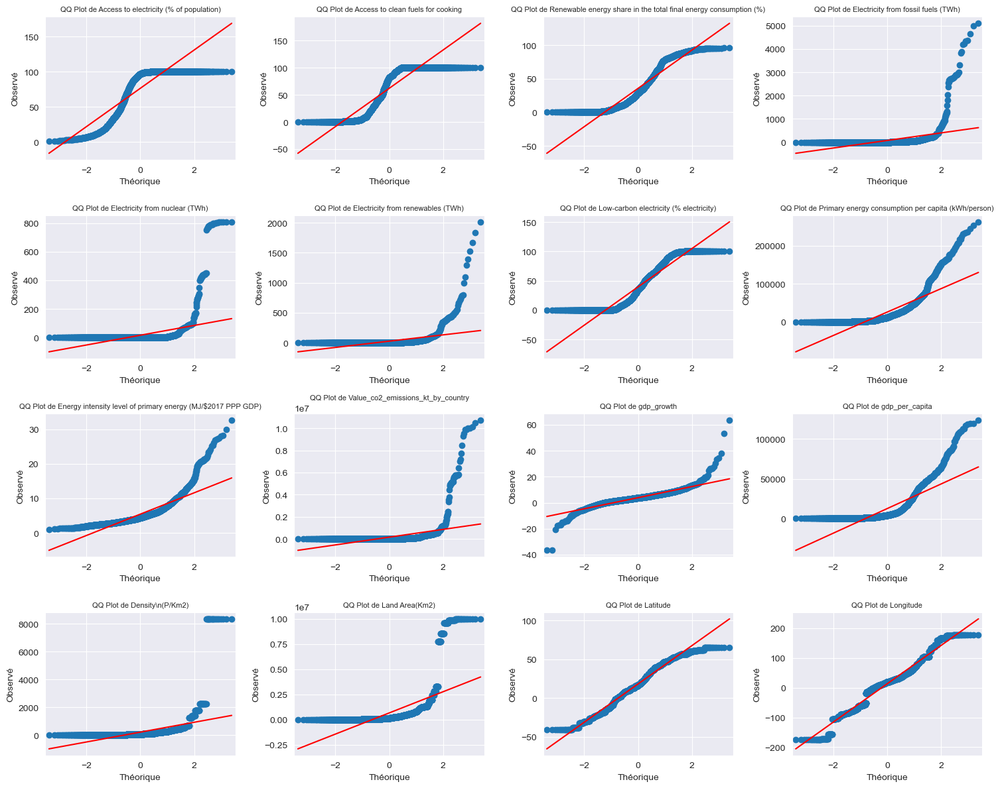

In [ ]:
rows = 4
cols = 4
fig, axes = plt.subplots(rows, cols, figsize = (15, 12))

# Tracé des 16 QQ-plot pour étudier la normalité
for i in range(0, 16):
    row_index = i // cols
    col_index = i % cols
    # On faut i + 2 pour enlever les deux variables qualitatives
    sm.qqplot(data[data.columns[i + 2]], line = 'r',marker = 'o', ax = axes[row_index, col_index])
    axes[row_index, col_index].set_title(f'QQ Plot de {data.columns[i + 2]}', fontsize = 8)
    axes[row_index, col_index].set_xlabel('Théorique')
    axes[row_index, col_index].set_ylabel('Observé')
    axes[row_index, col_index].grid(True)
plt.tight_layout()
plt.show()

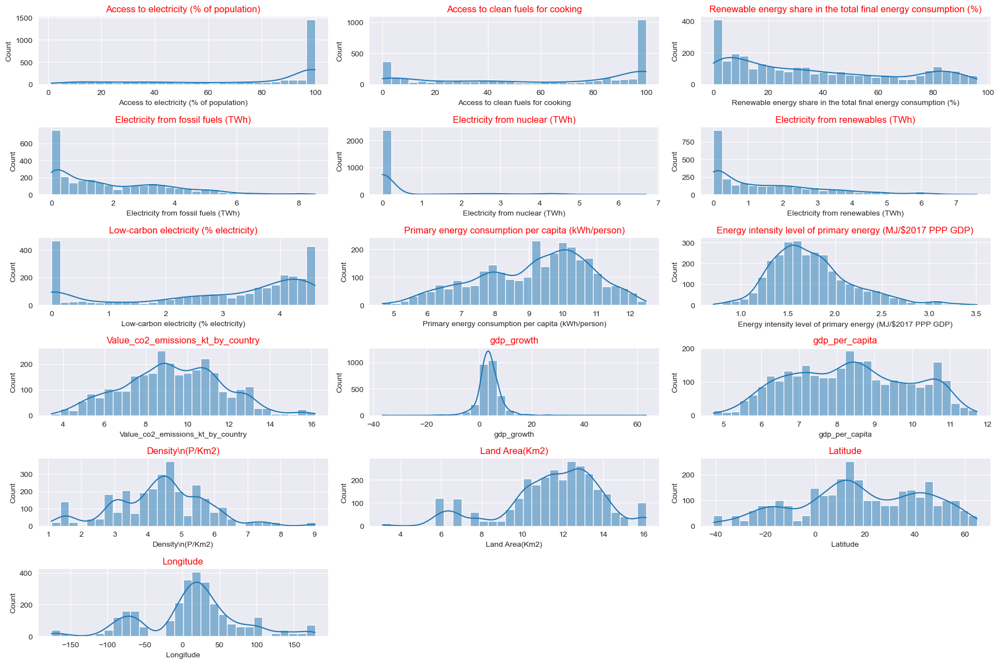

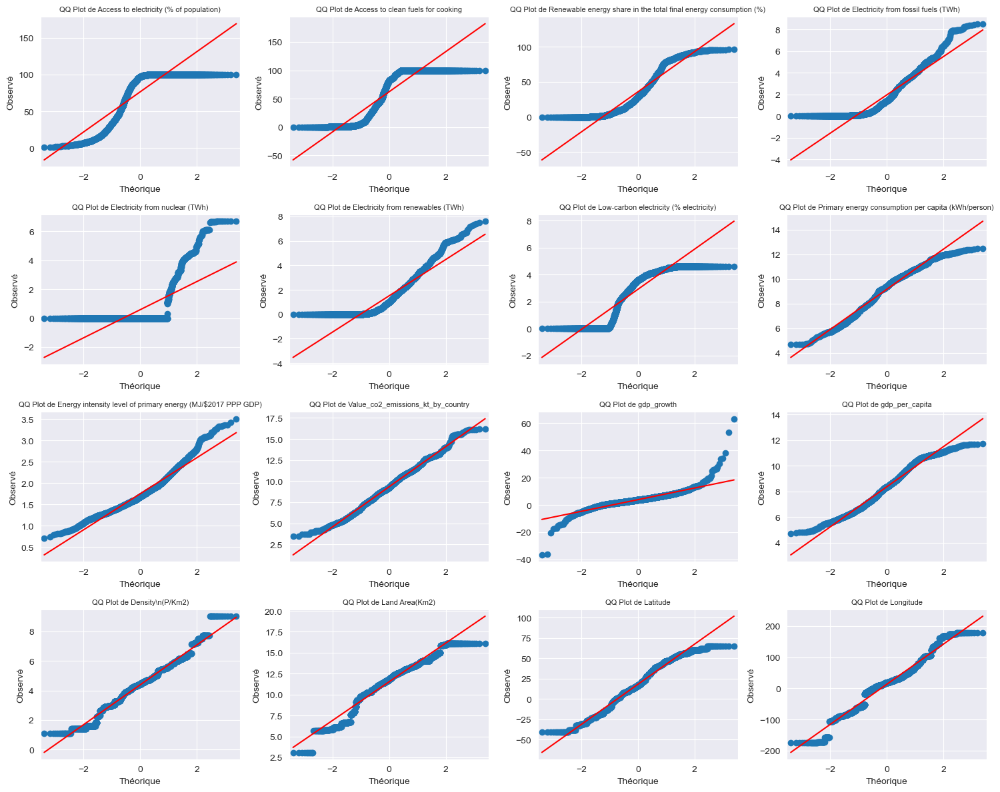

In [ ]:
# Transformation logarithmique
data_log = data.iloc[:,2:].copy()
data_log['Electricity from fossil fuels (TWh)'] = np.log(data_log['Electricity from fossil fuels (TWh)'] + 1)
data_log['Electricity from nuclear (TWh)'] = np.log(data_log['Electricity from nuclear (TWh)'] + 1)
data_log['Electricity from renewables (TWh)'] = np.log(data_log['Electricity from renewables (TWh)'] + 1)
data_log['Value_co2_emissions_kt_by_country'] = np.log(data_log['Value_co2_emissions_kt_by_country'] + 1)
data_log['Low-carbon electricity (% electricity)'] = np.log(data_log['Low-carbon electricity (% electricity)'] + 1)
data_log['Primary energy consumption per capita (kWh/person)'] = np.log(data_log['Primary energy consumption per capita (kWh/person)'] + 1)
data_log['Energy intensity level of primary energy (MJ/$2017 PPP GDP)'] = np.log(data_log['Energy intensity level of primary energy (MJ/$2017 PPP GDP)'] + 1)
data_log['gdp_per_capita'] = np.log(data_log['gdp_per_capita'] + 1)
data_log['Land Area(Km2)'] = np.log(data_log['Land Area(Km2)'] + 1)
data_log[r'Density\n(P/Km2)'] = np.log(data_log[r'Density\n(P/Km2)'] + 1)

# Histogramme
plt.figure(figsize = (18, 12))

rows = 6
cols = 3
histogrammes = []

for i in range(0, 16):
    plt.subplot(rows, cols, i + 1)
    histogramme = sns.histplot(data = data_log, x = data_log.columns[i], kde = True, bins = 30)
    histogramme.set_title(data_log.columns[i], fontsize = 12, color = 'red')
    histogrammes.append(histogramme)
plt.tight_layout()
plt.show()

# QQ plot
rows = 4
cols = 4

fig, axes = plt.subplots(rows, cols, figsize = (15, 12))
for i in range(0, 16):
    row_index = i // cols
    col_index = i % cols

    sm.qqplot(data_log[data_log.columns[i]], line = 'r',marker = 'o', ax = axes[row_index, col_index])
    axes[row_index, col_index].set_title(f'QQ Plot de {data_log.columns[i]}', fontsize = 8)
    axes[row_index, col_index].set_xlabel('Théorique')
    axes[row_index, col_index].set_ylabel('Observé')
    axes[row_index, col_index].grid(True)
plt.tight_layout()
plt.show()

Valeur optimale de lambda pour Access to electricity (% of population) : 1.7170629547743528
Valeur optimale de lambda pour Access to clean fuels for cooking : 0.6816638535639816
Valeur optimale de lambda pour Renewable energy share in the total final energy consumption (%) : 0.41508986288647565
Valeur optimale de lambda pour Electricity from fossil fuels (TWh) : -0.0020849505811473203
Valeur optimale de lambda pour Electricity from nuclear (TWh) : -0.08148382700856188
Valeur optimale de lambda pour Electricity from renewables (TWh) : 0.032923536625521665
Valeur optimale de lambda pour Low-carbon electricity (% electricity) : 0.5248214819484082
Valeur optimale de lambda pour Primary energy consumption per capita (kWh/person) : 0.11630961350233146
Valeur optimale de lambda pour Energy intensity level of primary energy (MJ/$2017 PPP GDP) : -0.36738068054240497
Valeur optimale de lambda pour Value_co2_emissions_kt_by_country : -0.00919791282913897
Valeur optimale de lambda pour gdp_growth 

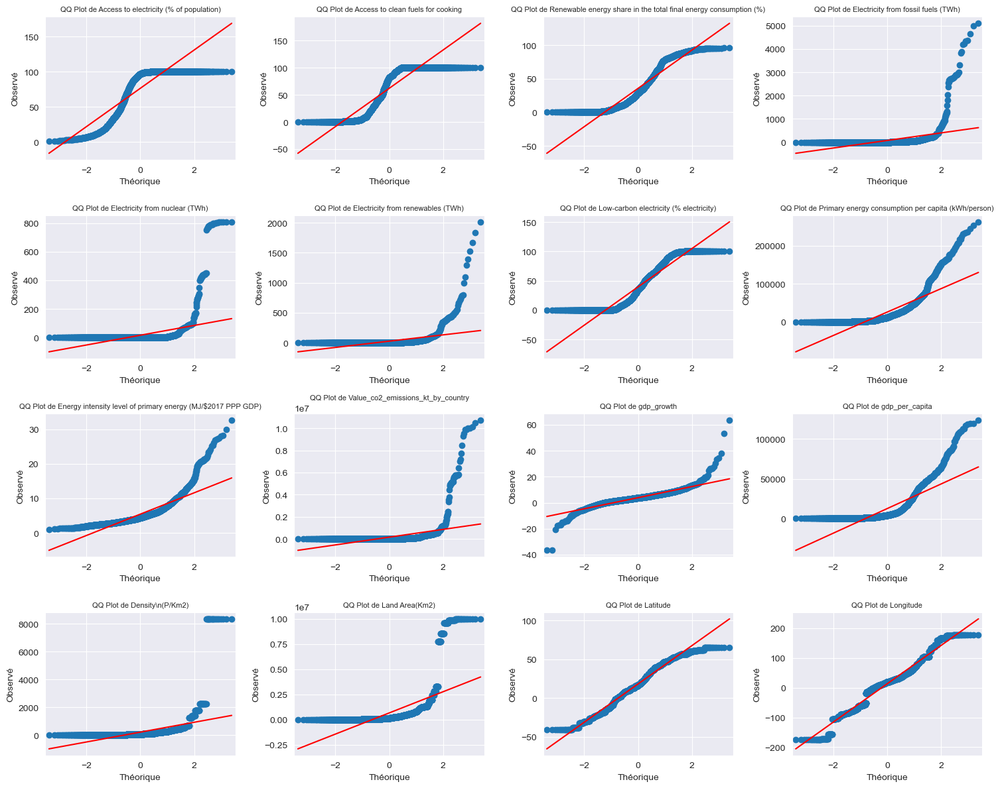

In [ ]:
# Transformation BoxCox
data_BoxCox = data.copy()

for column in data.columns[2:-3]:
    # Garde les valeurs positives
    positive_values = data[column][data[column] > 0]
    if len(positive_values) > 0:
        # Applique la transformation
        transformed_column, lambda_value = boxcox(positive_values)
        transformed_series = pd.Series(index = data.index, dtype = np.float64)
        transformed_series.loc[positive_values.index] = transformed_column
        data_BoxCox[column] = transformed_series
        # Lambda optimal par colonne
        print(f"Valeur optimale de lambda pour {column} : {lambda_value}")
    else:
        print(f"La colonne {column} ne contient que des valeurs négatives ou des zéros et sera remplie de NaN.")

# Lambda optimal total
print("Valeur optimale de lambda : ", lambda_value)

# QQ plot
rows = 4
cols = 4

fig, axes = plt.subplots(rows, cols, figsize = (15, 12))

for i in range(0, 16):
    row_index = i // cols
    col_index = i % cols
    sm.qqplot(data[data_BoxCox.columns[i + 2]], line = 'r', marker = 'o', ax = axes[row_index, col_index])
    axes[row_index, col_index].set_title(f'QQ Plot de {data_BoxCox.columns[i + 2]}', fontsize = 8)
    axes[row_index, col_index].set_xlabel('Théorique')
    axes[row_index, col_index].set_ylabel('Observé')
    axes[row_index, col_index].grid(True)
plt.tight_layout()
plt.show()

Les transformations logarithmiques et BoxCox semblent bien fonctionner pour rendre davantage gaussiennes nos données et limiter la variance très importante qui subsiste à l'intérieur des variables. Pour cette transformation, le paramètre à optimiser est lambda pour maximiser la normalité des variables. Les résultats sur les tests de normalité entre les deux types de transformation demeurent très similaires. Nous choisissons donc de continuer notre analyse à partir du jeu de données issu de la transformation logarithmique des données bruts. Etudions désormais les corrélations entre les variables et confrontons-les avec les corrélations des données pré-transformées.

# **6- Analyse multidimensionnelle et application au cas particulier de la variable 'Value_co2_emissions'**

## Matrice de dispersion

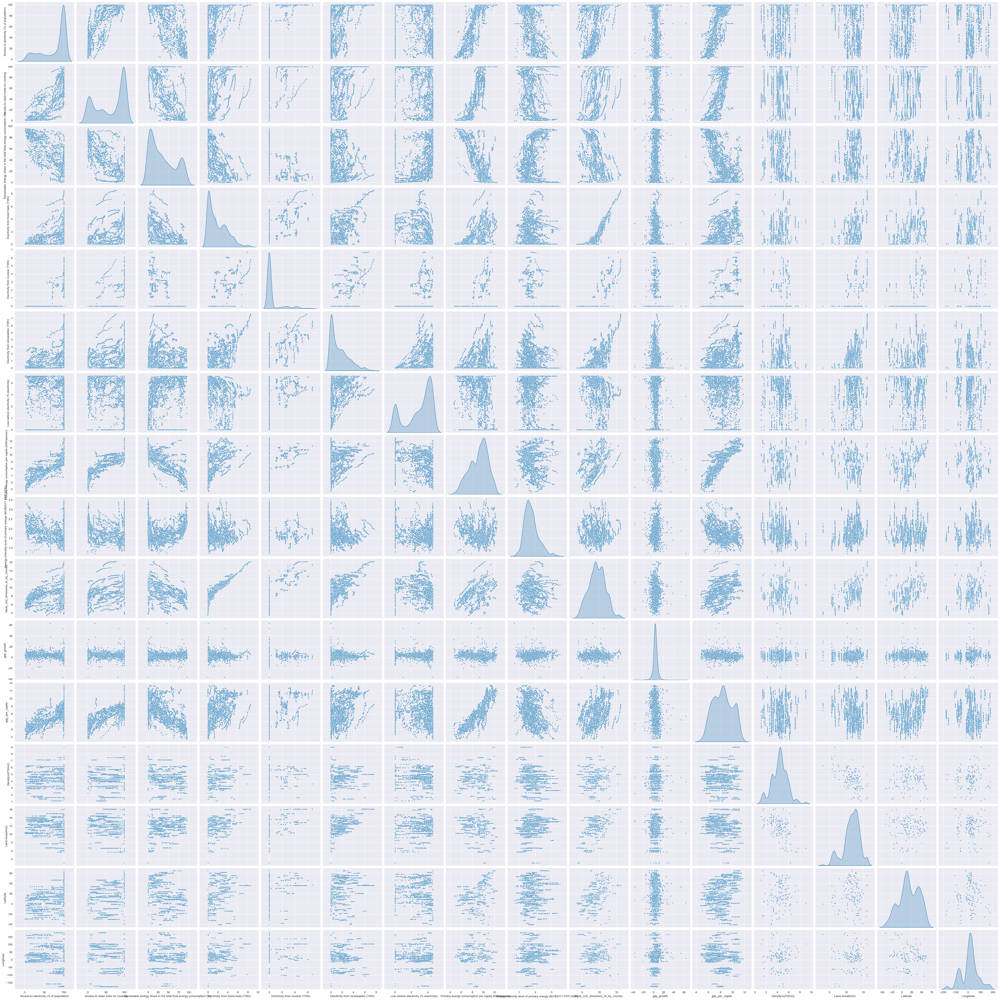

In [ ]:
quantitative_variables = data_log.iloc[:, 0:16]
sns.pairplot(quantitative_variables, diag_kind = 'kde', markers = '.', height = 3)
plt.show()

Il semble y avoir une relation plutôt linéaire entre les variables et la variable gdp_growth d'après la forme de la scatter matrix ayant une tendance linéaire. On repère une distribution assez particulière des points qui laisse présager des relations linéaires entre cette variable et la plupart des autres.  De plus elle semble avoir une valeur nettement centrale au vu du pic très étroit au milieu de la diagonale du graphe.

On note également une distribution particulière pour les variables Electricity_from_Nuclear (et Low_carbon_energy) et Electricity_from_renewables qui contiennent énormément de points à 0 et dont les graphes ressemblent à des lignes digitalisées, ce qui était prévisible puisque le nucléaire et les énérgies renouvelables en grande quantité ne sont pas accessibles équitablement dans tous les pays du globe.

Néanmoins, il est difficile au vu du grand nombre de variables de constater nettement des comportements spécifiques. C'est pourquoi une analyse bidimensionnelle entre les variables sera bienvenue.

## Analyse de la matrice de corrélations

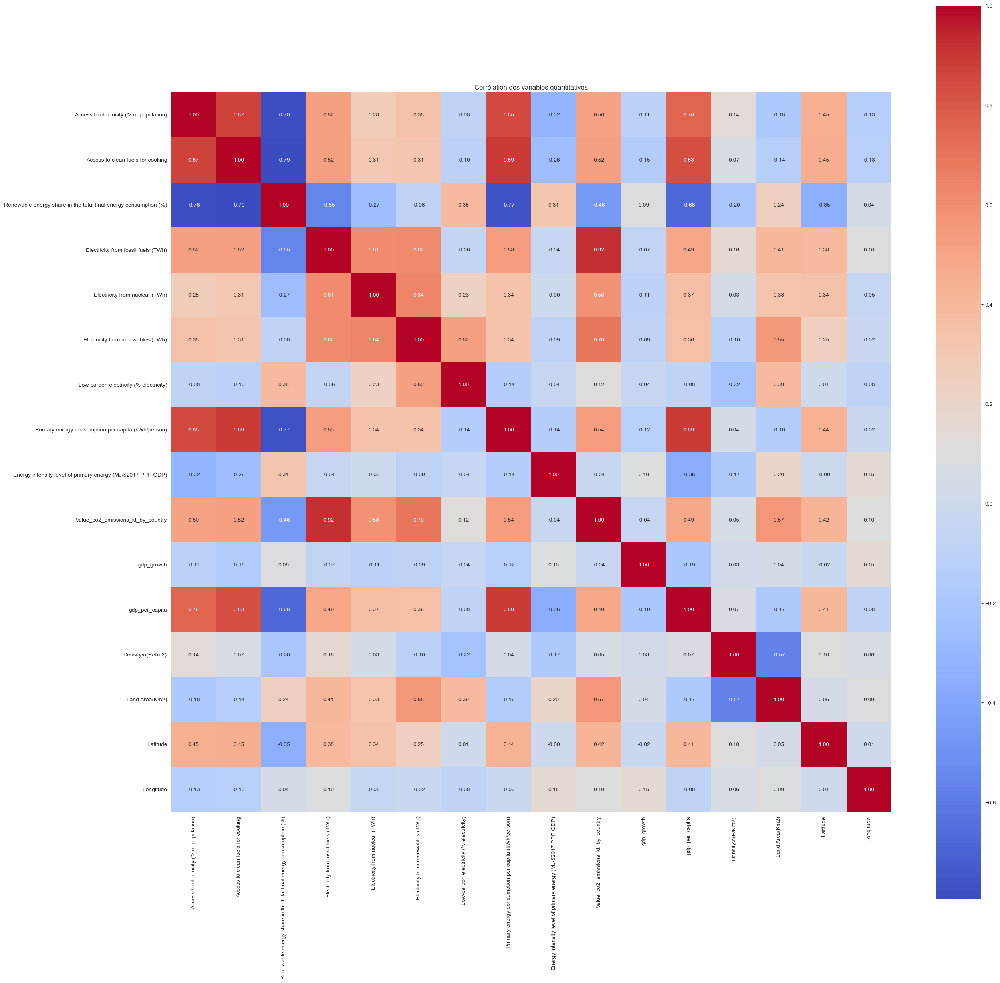

In [ ]:
plt.figure(figsize = (29, 29))
sns.heatmap(data_log.corr(), annot = True, fmt = ".2f", cmap = "coolwarm", square = True, cbar = True)
plt.title('Corrélation des variables quantitatives')
plt.show()

On distingue une corrélation positive très forte entre la variable caractérisant les émissions de CO2 et celles caractérisant l'électricité par pays issue de l'énergie fossile, du nucléaire et des énergies renouvelables ce qui n'est pas surprenant. L'utilisation des énergies fossiles génère beaucoup de CO2 et les pays disposant de grandes ressources énergétiques sont souvent les (5) plus gros émetteurs de CO2. De la même manière, il existe une corrélation très fortement positive entre la variable traduisant l'acces a l'electricite et l'acces à du combustible propre, et entre l'acces a l'electricité et le PIB par habitant (gdp_per_capita). Même chose entre la consommation d’énergie par personne en kilowattheures et le PIB par habitant. Cela est cohérent aussi puisque la consommation d'énergie par personne est lié à la richesse de l'individu et du pays. La taille du pays semble également être facteur de grandes valeurs en termes d'émissions de CO2 puisque l'on dénote une corrélation positive de 0.66 (logique, un plus grand territoire implique généralement plus de population et donc d'émissions).

En terme de corrélation fortement négative, le pourcentage de la population ayant accès à l'électricité et aux combustibles propres est très corrélé négativement avec la capacité d’énergie renouvelable par personne. Cela est surement lié au fait que les pays ayant un faibles acces aux ressources énergétiques ont également un faible accès aux énergies renouvelables.

Enfin un autre angle de vue intéressant concerne la corrélation entre la latitude et certaines autres variables quantitatives comme l'acces a l'électricité, aux combustibles propres, le PIB, tandis que la lattitude semble faiblement corrélé avec toutes les variables. Ceci traduit l'impact de l'emplacement géographique des pays dans l'accès aux ressources et une certaine polarisation Nord/Sud plus que Est-Ouest des ressources réparties entre les pays.


Une manière de constater ceci de manière plus visuelle est d'illustrer nos observations sur une mappemonde. Pour savoir quelles variables représenter sur la carte, nous allons lister les variables les plus corrélées avec la variable CO2 que nous souhaiterons prédire dans la partie modélisation plus tard.




## Première étude des variables corrélées avec Value_co2_emissions_kt_by_country'

In [ ]:
# On garde uniquement les variables numériques
numeric_data = data.select_dtypes(include = ['number'])
# On trace la corrélation par rapport à la variable CO2 et on retient les 5 plus grandes valeurs
correlation_with_target = numeric_data.corr()['Value_co2_emissions_kt_by_country'].sort_values(ascending = False)
print('Top 5 Most Positively Correlated to the Target Variable : ')
print(correlation_with_target.head(5))

Top 5 Most Positively Correlated to the Target Variable : 
Value_co2_emissions_kt_by_country      1.000000
Electricity from fossil fuels (TWh)    0.989846
Electricity from renewables (TWh)      0.857375
Land Area(Km2)                         0.657828
Electricity from nuclear (TWh)         0.597728
Name: Value_co2_emissions_kt_by_country, dtype: float64


La commande ci-dessus permet de visualiser les 3 variables les plus fortement corrélées avec la variable des émissions de CO2 que nous étudierons par la suite. Ces variables apparaitront probablement parmi les futurs paramètres importants à retenir dans notre modélisation et nos futurs modèles de régressions. Il est possible de visualiser cela à travers les graphes suivants qui soulignent bien les liens et les corrélations entre les variables deux à deux.

C:\Users\clldj\AppData\Local\Temp\ipykernel_21776\2934642608.py:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



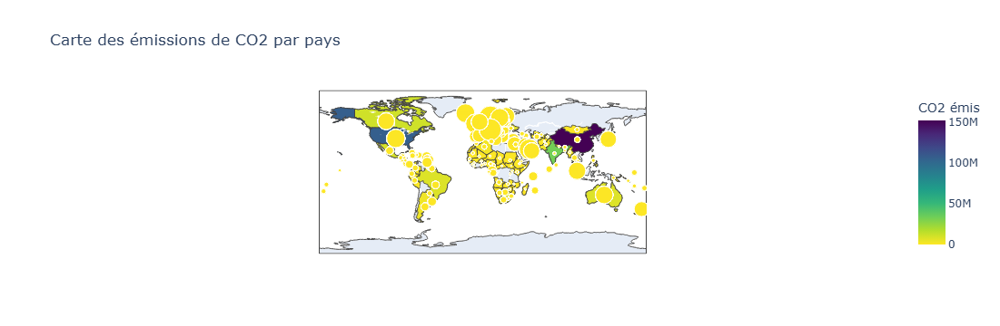

In [ ]:
# Emission de CO2 par pays
CO2_emissions = data.groupby('Entity', as_index = False).agg(Somme_CO2 = ('Value_co2_emissions_kt_by_country','sum'))

fig = px.choropleth(CO2_emissions,
                    locations = 'Entity',
                    locationmode = "country names",
                    color = "Somme_CO2",
                    hover_name = 'Entity',
                    hover_data = {"Entity": False, "Somme_CO2": True},
                    color_continuous_scale = px.colors.sequential.Viridis_r,
                    title = "Carte des émissions de CO2 par pays",
                    labels = {'Somme_CO2': 'CO2 émis'})

fig.update_geos(showcountries = True, countrycolor = "rgb(255,255,255)")
# PIB par habitant
gdp_by_country = data.groupby('Entity', as_index = False).agg(Somme_gdp = ('gdp_per_capita','sum'))
gdp_by_country['Somme_gdp'] /= 20
data['Somme_gdp'] = data['gdp_per_capita'].groupby(data['Entity']).transform('sum') / 20
plot_data = data[['Entity', 'Latitude', 'Longitude', 'Somme_gdp']]

fig.add_trace(px.scatter_geo(data_frame = plot_data,
                              lat = 'Latitude',
                              lon = 'Longitude',
                              size = 'Somme_gdp',
                              color = "Somme_gdp",
                              hover_name = 'Entity',
                              hover_data = {"Entity": False, "Somme_gdp": True},
                              opacity = 0.6,
                              color_continuous_scale = px.colors.sequential.Viridis_r).data[0])
fig.show()

C:\Users\clldj\AppData\Local\Temp\ipykernel_21776\1166774697.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



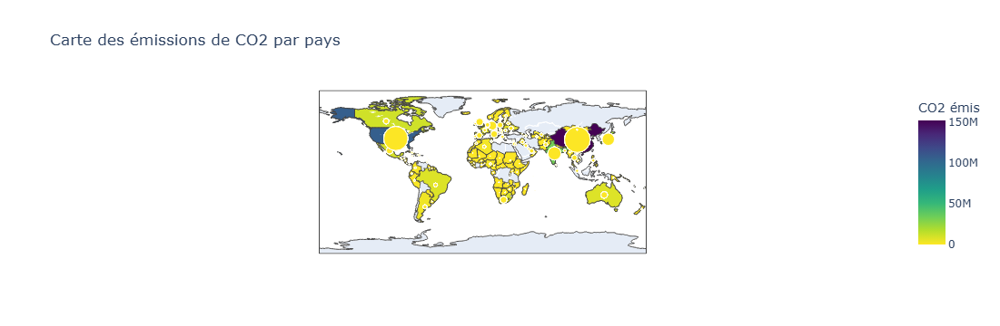

In [ ]:
# Emission de CO2 par pays
CO2_emissions = data.groupby('Entity', as_index = False).agg(Somme_CO2 = ('Value_co2_emissions_kt_by_country','sum'))

fig = px.choropleth(CO2_emissions,
                    locations = 'Entity',
                    locationmode = "country names",
                    color = "Somme_CO2",
                    hover_name = 'Entity',
                    hover_data = {"Entity": False, "Somme_CO2": True},
                    color_continuous_scale = px.colors.sequential.Viridis_r,
                    title = "Carte des émissions de CO2 par pays",
                    labels = {'Somme_CO2': 'CO2 émis'})

fig.update_geos(showcountries=True, countrycolor="rgb(255,255,255)")

# Emission d'électricité provenant des énergies fossiles par pays
fuels_by_country = data.groupby('Entity', as_index = False).agg(Qté_energy_fossil = ('Electricity from fossil fuels (TWh)','sum'))
fuels_by_country['Qté_energy_fossil'] /= 20
data['Qté_energy_fossil'] = data['Electricity from fossil fuels (TWh)'].groupby(data['Entity']).transform('sum') / 20
plot_data = data[['Entity', 'Latitude', 'Longitude', 'Qté_energy_fossil']]

fig.add_trace(px.scatter_geo(data_frame=plot_data,
                              lat='Latitude',
                              lon='Longitude',
                              size='Qté_energy_fossil',
                              color="Qté_energy_fossil",
                              hover_name='Entity',
                              hover_data={"Entity": False, "Qté_energy_fossil": True},
                              opacity=0.6,
                              color_continuous_scale=px.colors.sequential.Viridis_r).data[0])
fig.show()

C:\Users\clldj\AppData\Local\Temp\ipykernel_21776\1271479822.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



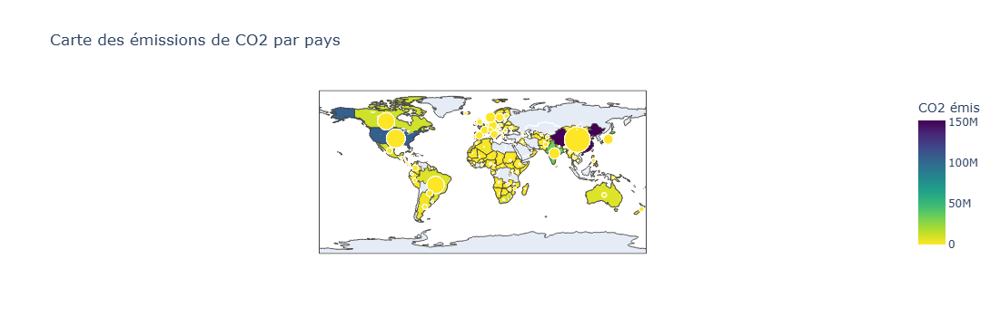

In [ ]:
# Emission de CO2 par pays
CO2_emissions = data.groupby('Entity', as_index = False).agg(Somme_CO2 = ('Value_co2_emissions_kt_by_country','sum'))

fig = px.choropleth(CO2_emissions,
                    locations = 'Entity',
                    locationmode = "country names",
                    color = "Somme_CO2",
                    hover_name = 'Entity',
                    hover_data = {"Entity": False, "Somme_CO2": True},
                    color_continuous_scale = px.colors.sequential.Viridis_r,
                    title = "Carte des émissions de CO2 par pays",
                    labels = {'Somme_CO2': 'CO2 émis'})

fig.update_geos(showcountries = True, countrycolor = "rgb(255,255,255)")

# Emission d'électricité provenant des énergies renouvelables par pays
renewables_by_country = data.groupby('Entity', as_index = False).agg(Qté_energy_renouv = ('Electricity from renewables (TWh)','sum'))
renewables_by_country['Qté_energy_renouv'] /= 20
data['Qté_energy_renouv'] = data['Electricity from renewables (TWh)'].groupby(data['Entity']).transform('sum') / 20
plot_data = data[['Entity', 'Latitude', 'Longitude', 'Qté_energy_renouv']]

fig.add_trace(px.scatter_geo(data_frame = plot_data,
                              lat = 'Latitude',
                              lon = 'Longitude',
                              size = 'Qté_energy_renouv',
                              color = "Qté_energy_renouv",
                              hover_name = 'Entity',
                              hover_data = {"Entity": False, "Qté_energy_renouv": True},
                              opacity = 0.6,
                              color_continuous_scale = px.colors.sequential.Viridis_r).data[0])
fig.show()

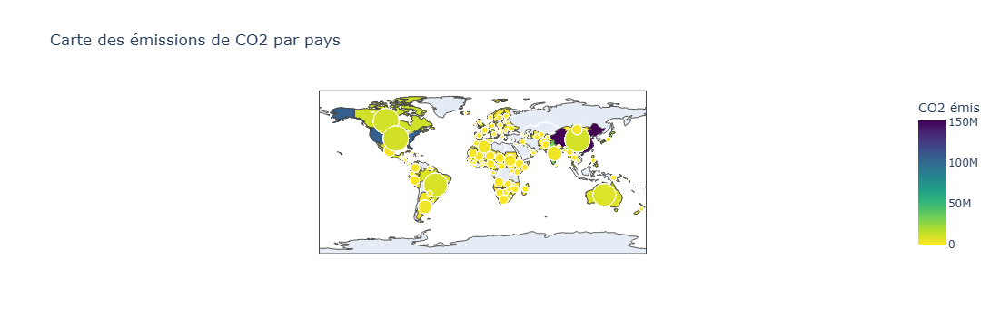

In [ ]:
# Emission de CO2 par pays
CO2_emissions = data.groupby('Entity', as_index = False).agg(Somme_CO2 = ('Value_co2_emissions_kt_by_country','sum'))

fig = px.choropleth(CO2_emissions,
                    locations = 'Entity',
                    locationmode = "country names",
                    color = "Somme_CO2",
                    hover_name = 'Entity',
                    hover_data = {"Entity": False, "Somme_CO2": True},
                    color_continuous_scale = px.colors.sequential.Viridis_r,
                    title = "Carte des émissions de CO2 par pays",
                    labels = {'Somme_CO2': 'CO2 émis'})

fig.update_geos(showcountries = True, countrycolor = "rgb(255,255,255)")
plot_data = data[['Entity', 'Latitude', 'Longitude', 'Land Area(Km2)']]
fig.add_trace(px.scatter_geo(data_frame = plot_data,
                              lat = 'Latitude',
                              lon = 'Longitude',
                              size = 'Land Area(Km2)',   # Taille des cercles en fonction de la taille du pays
                              color = 'Land Area(Km2)',  # Couleur des cercles en fonction de la taille du pays
                              hover_name = 'Entity',
                              hover_data = {"Entity": False, "Land Area(Km2)": True},
                              opacity = 0.6,
                              color_continuous_scale = px.colors.sequential.Viridis_r).data[0])
fig.show()

## Etude des nuages de points (scatterplot) plus en détail dans l'analyse des dépendances entre les variables quantitatives

Nous avons dans un premier temps tenté d'étudier les différences de comportement sur les nuages de points entre les outliers et le reste de données sans cependant obtenir de résultats ou de distinction satisfaisante. Au vu des résultats obtenus en traçant l'histogramme et les cartes sur la variable quantitative des emissions de CO2, et au vu du très grand nombre de modalités de la variable qualitative 'Entity', il nous semble pertinent de regrouper certaines modalités entre elles. Les regroupements les plus intéressants semblent être de regrouper Chine, Etats-Unis, Japon, Allemagne et Inde ensemble, tant ils ont des comportements similaires dans le cadre des Emissions de CO2, ou bien de regrouper les pays en fonction de leur continent pour voir si cela peut être un facteur important de disparités.

Commençons par mettre en avant les données issues des 5 pays les plus émetteurs de CO2 et traçons les scatter plot des différentes variables.

In [ ]:
data = data.drop('Somme_gdp', axis = 1)
data = data.drop('Qté_energy_fossil', axis = 1)
data = data.drop('Qté_energy_renouv', axis = 1)

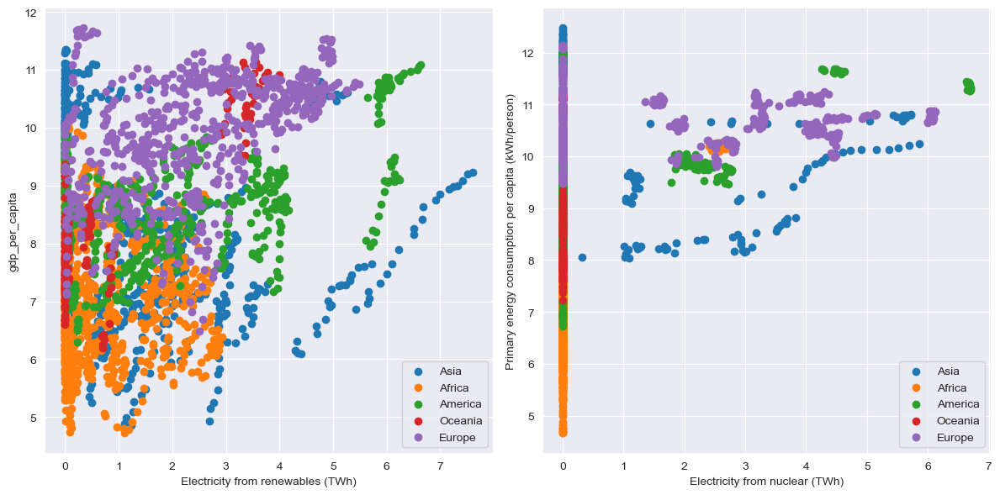

In [ ]:
col_quali = data.iloc[:, :2]

# Concaténer les deux premières colonnes de data avec data_log
data_log_full = pd.concat([col_quali, data_log], axis = 1)
# Rajoute la colonne Continent à data_log_full
data_log_full_continent = data_log_full.copy()
data_log_full_continent['Continent'] = coco.convert(names = data_log_full_continent['Entity'], to = 'continent')

plt.figure(figsize = (12, 6))

plt.subplot(1, 2, 1)
for continent in data_log_full_continent['Continent'].unique():
    continent_data = data_log_full_continent[data_log_full_continent['Continent'] == continent]
    plt.scatter(continent_data['Electricity from renewables (TWh)'], continent_data['gdp_per_capita'], label = continent)
plt.xlabel('Electricity from renewables (TWh)')
plt.ylabel('gdp_per_capita')
plt.legend()

plt.subplot(1, 2, 2)
for continent in data_log_full_continent['Continent'].unique():
    continent_data = data_log_full_continent[data_log_full_continent['Continent'] == continent]
    plt.scatter(continent_data['Electricity from nuclear (TWh)'], continent_data['Primary energy consumption per capita (kWh/person)'], label = continent)
plt.xlabel('Electricity from nuclear (TWh)')
plt.ylabel('Primary energy consumption per capita (kWh/person)', )
plt.legend()

plt.tight_layout()
plt.show()

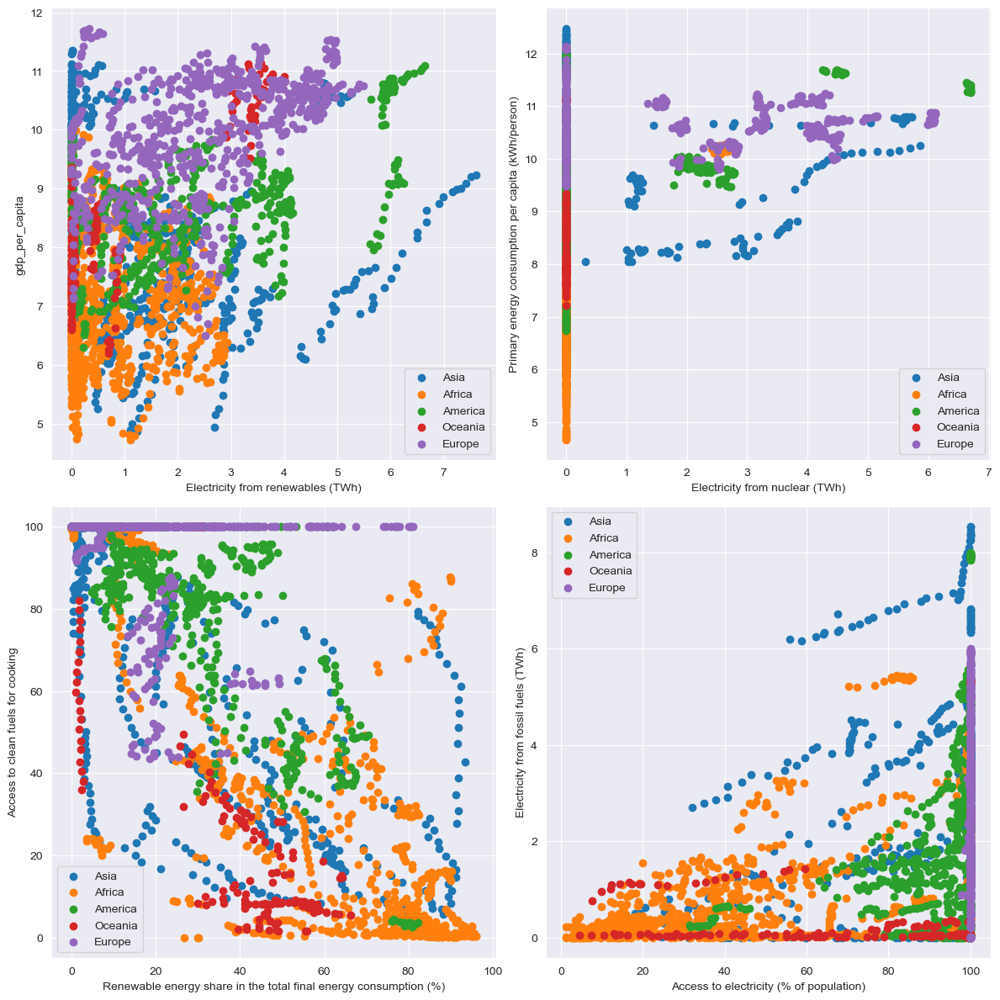

In [ ]:
fig, axs = plt.subplots(2, 2, figsize = (12, 12))

for continent in data_log_full_continent['Continent'].unique():
    continent_data = data_log_full_continent[data_log_full_continent['Continent'] == continent]
    axs[0, 0].scatter(continent_data['Electricity from renewables (TWh)'], continent_data['gdp_per_capita'], label = continent)
axs[0, 0].set_xlabel('Electricity from renewables (TWh)')
axs[0, 0].set_ylabel('gdp_per_capita')
axs[0, 0].legend()

for continent in data_log_full_continent['Continent'].unique():
    continent_data = data_log_full_continent[data_log_full_continent['Continent'] == continent]
    axs[0, 1].scatter(continent_data['Electricity from nuclear (TWh)'], continent_data['Primary energy consumption per capita (kWh/person)'], label = continent)
axs[0, 1].set_xlabel('Electricity from nuclear (TWh)')
axs[0, 1].set_ylabel('Primary energy consumption per capita (kWh/person)')
axs[0, 1].legend()

for continent in data_log_full_continent['Continent'].unique():
    continent_data = data_log_full_continent[data_log_full_continent['Continent'] == continent]
    axs[1, 0].scatter(continent_data['Renewable energy share in the total final energy consumption (%)'], continent_data['Access to clean fuels for cooking'], label = continent)
axs[1, 0].set_xlabel('Renewable energy share in the total final energy consumption (%)')
axs[1, 0].set_ylabel('Access to clean fuels for cooking')
axs[1, 0].legend()

for continent in data_log_full_continent['Continent'].unique():
    continent_data = data_log_full_continent[data_log_full_continent['Continent'] == continent]
    axs[1, 1].scatter(continent_data['Access to electricity (% of population)'], continent_data['Electricity from fossil fuels (TWh)'], label = continent)
axs[1, 1].set_xlabel('Access to electricity (% of population)')
axs[1, 1].set_ylabel('Electricity from fossil fuels (TWh)')
axs[1, 1].legend()

plt.tight_layout()
plt.show()

## Analyse du comportement des 5 pays les plus émetteurs et des pays les plus pauvres

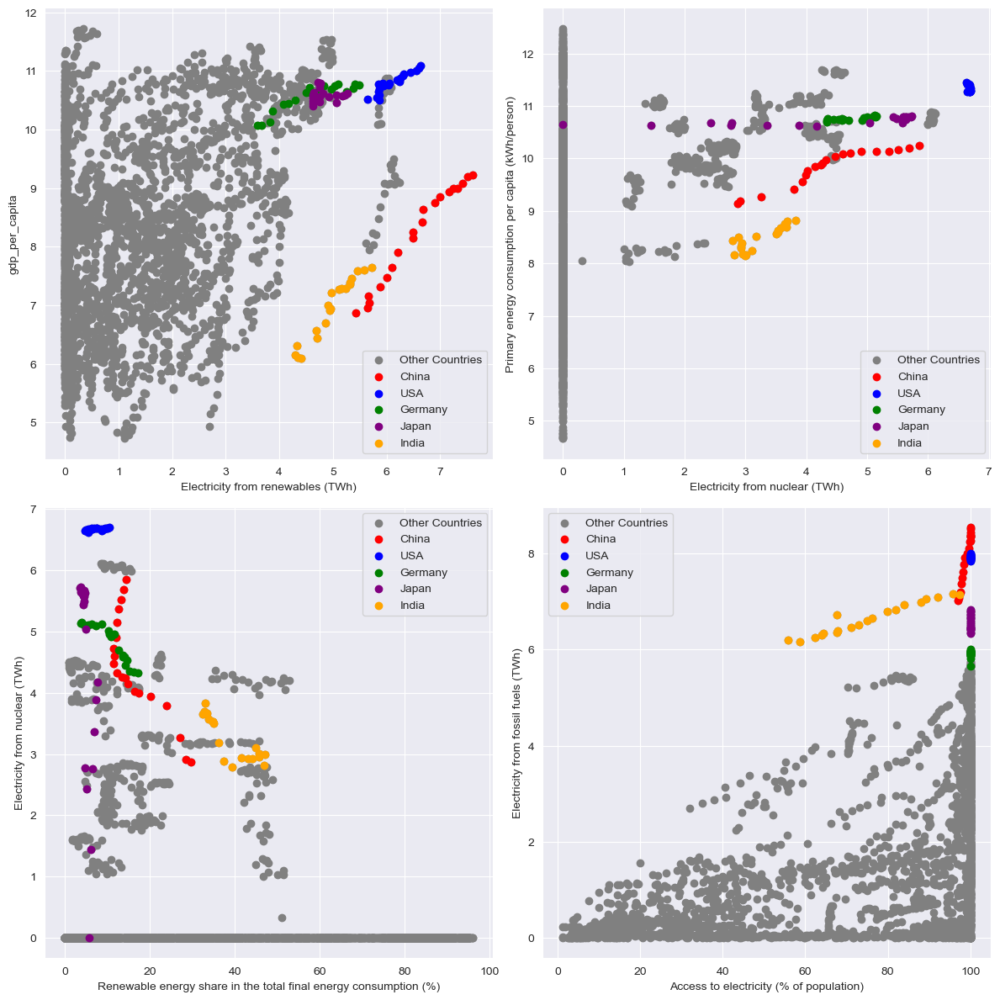

In [ ]:
fig, axs = plt.subplots(2, 2, figsize = (12, 12))

# On regroupe ensemble les données des 5 pays les plus émetteurs triés par pays
china_data = data_log_full_continent[data_log_full_continent['Entity'] == 'China']
usa_data = data_log_full_continent[data_log_full_continent['Entity'] == 'United States']
germany_data = data_log_full_continent[data_log_full_continent['Entity'] == 'Germany']
japan_data = data_log_full_continent[data_log_full_continent['Entity'] == 'Japan']
india_data = data_log_full_continent[data_log_full_continent['Entity'] == 'India']

# Tracé du nuage de points du PIB par habitant en fonction de Electricity from renewables
axs[0, 0].scatter(data_log_full_continent['Electricity from renewables (TWh)'], data_log_full_continent['gdp_per_capita'], color = 'gray', label = 'Other Countries')
axs[0, 0].scatter(china_data['Electricity from renewables (TWh)'], china_data['gdp_per_capita'], color = 'red', label = 'China')
axs[0, 0].scatter(usa_data['Electricity from renewables (TWh)'], usa_data['gdp_per_capita'], color = 'blue', label = 'USA')
axs[0, 0].scatter(germany_data['Electricity from renewables (TWh)'], germany_data['gdp_per_capita'], color = 'green', label = 'Germany')
axs[0, 0].scatter(japan_data['Electricity from renewables (TWh)'], japan_data['gdp_per_capita'], color = 'purple', label = 'Japan')
axs[0, 0].scatter(india_data['Electricity from renewables (TWh)'], india_data['gdp_per_capita'], color = 'orange', label = 'India')
axs[0, 0].set_xlabel('Electricity from renewables (TWh)')
axs[0, 0].set_ylabel('gdp_per_capita')
axs[0, 0].legend()

# Tracé du nuage de points de Primary energy consumption en fonction de Electricity from nuclear
axs[0, 1].scatter(data_log_full_continent['Electricity from nuclear (TWh)'], data_log_full_continent['Primary energy consumption per capita (kWh/person)'], color = 'gray', label = 'Other Countries')
axs[0, 1].scatter(china_data['Electricity from nuclear (TWh)'], china_data['Primary energy consumption per capita (kWh/person)'], color = 'red', label = 'China')
axs[0, 1].scatter(usa_data['Electricity from nuclear (TWh)'], usa_data['Primary energy consumption per capita (kWh/person)'], color = 'blue', label = 'USA')
axs[0, 1].scatter(germany_data['Electricity from nuclear (TWh)'], germany_data['Primary energy consumption per capita (kWh/person)'], color = 'green', label = 'Germany')
axs[0, 1].scatter(japan_data['Electricity from nuclear (TWh)'], japan_data['Primary energy consumption per capita (kWh/person)'], color = 'purple', label = 'Japan')
axs[0, 1].scatter(india_data['Electricity from nuclear (TWh)'], india_data['Primary energy consumption per capita (kWh/person)'], color = 'orange', label = 'India')
axs[0, 1].set_xlabel('Electricity from nuclear (TWh)')
axs[0, 1].set_ylabel('Primary energy consumption per capita (kWh/person)')
axs[0, 1].legend()

# Tracé du nuage de points de Electricity from nuclear en fonction de Renewable energy share
axs[1, 0].scatter(data_log_full_continent['Renewable energy share in the total final energy consumption (%)'], data_log_full_continent['Electricity from nuclear (TWh)'], color = 'gray', label = 'Other Countries')
axs[1, 0].scatter(china_data['Renewable energy share in the total final energy consumption (%)'], china_data['Electricity from nuclear (TWh)'], color = 'red', label = 'China')
axs[1, 0].scatter(usa_data['Renewable energy share in the total final energy consumption (%)'], usa_data['Electricity from nuclear (TWh)'], color = 'blue', label = 'USA')
axs[1, 0].scatter(germany_data['Renewable energy share in the total final energy consumption (%)'], germany_data['Electricity from nuclear (TWh)'], color = 'green', label = 'Germany')
axs[1, 0].scatter(japan_data['Renewable energy share in the total final energy consumption (%)'], japan_data['Electricity from nuclear (TWh)'], color = 'purple', label = 'Japan')
axs[1, 0].scatter(india_data['Renewable energy share in the total final energy consumption (%)'], india_data['Electricity from nuclear (TWh)'], color = 'orange', label = 'India')
axs[1, 0].set_xlabel('Renewable energy share in the total final energy consumption (%)')
axs[1, 0].set_ylabel('Electricity from nuclear (TWh)')
axs[1, 0].legend()

# Tracé du nuage de points de Electricity from fossil fuels en fonction du pourcentage d'accès à l'électricité
axs[1, 1].scatter(data_log_full_continent['Access to electricity (% of population)'], data_log_full_continent['Electricity from fossil fuels (TWh)'], color = 'gray', label = 'Other Countries')
axs[1, 1].scatter(china_data['Access to electricity (% of population)'], china_data['Electricity from fossil fuels (TWh)'], color = 'red', label = 'China')
axs[1, 1].scatter(usa_data['Access to electricity (% of population)'], usa_data['Electricity from fossil fuels (TWh)'], color = 'blue', label = 'USA')
axs[1, 1].scatter(germany_data['Access to electricity (% of population)'], germany_data['Electricity from fossil fuels (TWh)'], color = 'green', label = 'Germany')
axs[1, 1].scatter(japan_data['Access to electricity (% of population)'], japan_data['Electricity from fossil fuels (TWh)'], color = 'purple', label = 'Japan')
axs[1, 1].scatter(india_data['Access to electricity (% of population)'], india_data['Electricity from fossil fuels (TWh)'], color = 'orange', label = 'India')
axs[1, 1].set_xlabel('Access to electricity (% of population)')
axs[1, 1].set_ylabel('Electricity from fossil fuels (TWh)')
axs[1, 1].legend()

plt.tight_layout()
plt.show()

Un premier constat est que les 5 pays les plus émetteurs de CO2 font parti des pays ayant les plus grandes valeurs pour la plupart des variables que nous observons ici, notamment Electricity_from_renewables et Electricity_from_nuclear.

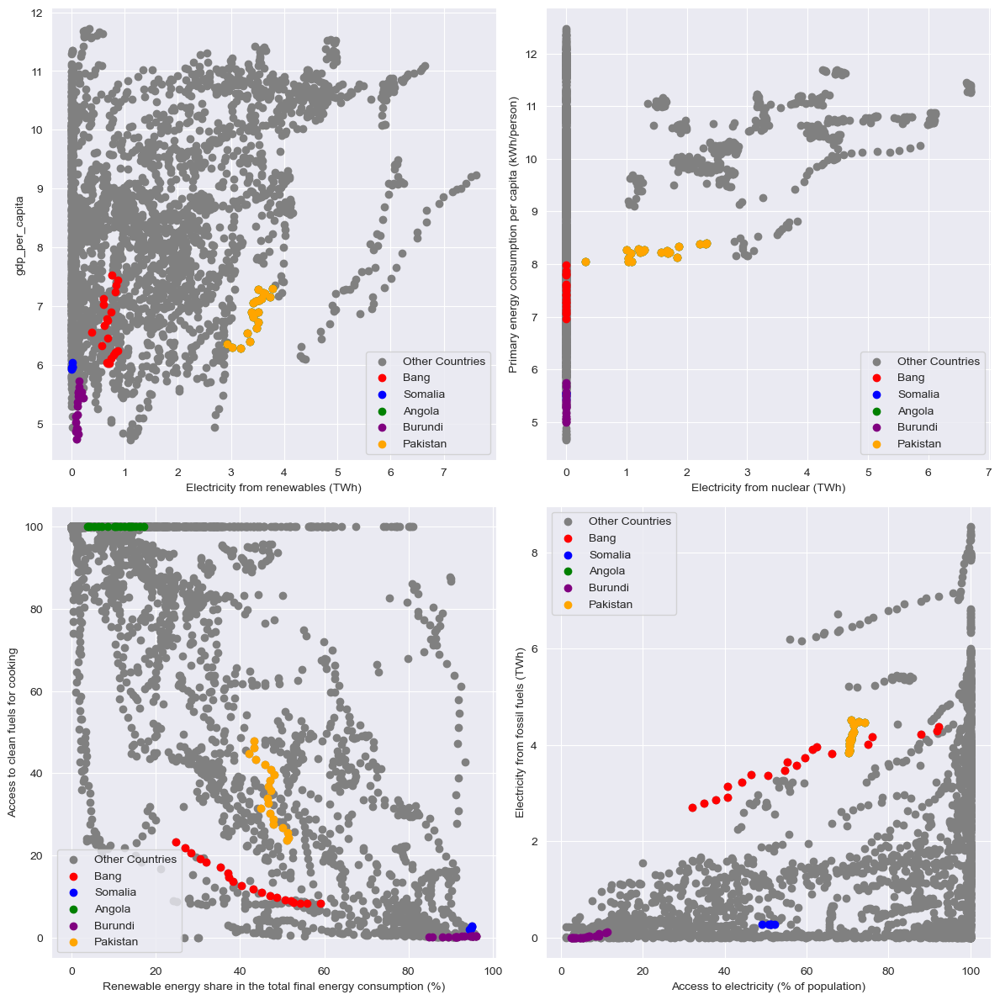

In [ ]:
fig, axs = plt.subplots(2, 2, figsize = (12, 12))

# On isole les données de 5 pays particulièrement pauvres pour colorer les points ensuite par pays
bang_data = data_log_full_continent[data_log_full_continent['Entity'] == 'Bangladesh']
som_data = data_log_full_continent[data_log_full_continent['Entity'] == 'Somalia']
ang_data = data_log_full_continent[data_log_full_continent['Entity'] == 'Angola']
bur_data = data_log_full_continent[data_log_full_continent['Entity'] == 'Burundi']
ang_data = data_log_full_continent[data_log_full_continent['Entity'] == 'Pakistan']


# Tracé des mêmes nuages de points que précédemment pour les 5 pays pauvres

axs[0, 0].scatter(data_log_full_continent['Electricity from renewables (TWh)'], data_log_full_continent['gdp_per_capita'], color = 'gray', label = 'Other Countries')
axs[0, 0].scatter(bang_data['Electricity from renewables (TWh)'], bang_data['gdp_per_capita'], color = 'red', label = 'Bang')
axs[0, 0].scatter(som_data['Electricity from renewables (TWh)'], som_data['gdp_per_capita'], color = 'blue', label = 'Somalia')
axs[0, 0].scatter(ang_data['Electricity from renewables (TWh)'], ang_data['gdp_per_capita'], color = 'green', label = 'Angola')
axs[0, 0].scatter(bur_data['Electricity from renewables (TWh)'], bur_data['gdp_per_capita'], color = 'purple', label = 'Burundi')
axs[0, 0].scatter(ang_data['Electricity from renewables (TWh)'], ang_data['gdp_per_capita'], color = 'orange', label = 'Pakistan')
axs[0, 0].set_xlabel('Electricity from renewables (TWh)')
axs[0, 0].set_ylabel('gdp_per_capita')
axs[0, 0].legend()

axs[0, 1].scatter(data_log_full_continent['Electricity from nuclear (TWh)'], data_log_full_continent['Primary energy consumption per capita (kWh/person)'], color = 'gray', label = 'Other Countries')
axs[0, 1].scatter(bang_data['Electricity from nuclear (TWh)'], bang_data['Primary energy consumption per capita (kWh/person)'], color = 'red', label = 'Bang')
axs[0, 1].scatter(som_data['Electricity from nuclear (TWh)'], som_data['Primary energy consumption per capita (kWh/person)'], color = 'blue', label = 'Somalia')
axs[0, 1].scatter(ang_data['Electricity from nuclear (TWh)'], ang_data['Primary energy consumption per capita (kWh/person)'], color = 'green', label = 'Angola')
axs[0, 1].scatter(bur_data['Electricity from nuclear (TWh)'], bur_data['Primary energy consumption per capita (kWh/person)'], color = 'purple', label = 'Burundi')
axs[0, 1].scatter(ang_data['Electricity from nuclear (TWh)'], ang_data['Primary energy consumption per capita (kWh/person)'], color = 'orange', label = 'Pakistan')
axs[0, 1].set_xlabel('Electricity from nuclear (TWh)')
axs[0, 1].set_ylabel('Primary energy consumption per capita (kWh/person)')
axs[0, 1].legend()

axs[1, 0].scatter(data_log_full_continent['Renewable energy share in the total final energy consumption (%)'], data_log_full_continent['Access to clean fuels for cooking'], color = 'gray', label = 'Other Countries')
axs[1, 0].scatter(bang_data['Renewable energy share in the total final energy consumption (%)'], bang_data['Access to clean fuels for cooking'], color = 'red', label = 'Bang')
axs[1, 0].scatter(som_data['Renewable energy share in the total final energy consumption (%)'], som_data['Access to clean fuels for cooking'], color = 'blue', label = 'Somalia')
axs[1, 0].scatter(germany_data['Renewable energy share in the total final energy consumption (%)'], germany_data['Access to clean fuels for cooking'], color = 'green', label = 'Angola')
axs[1, 0].scatter(bur_data['Renewable energy share in the total final energy consumption (%)'], bur_data['Access to clean fuels for cooking'], color = 'purple', label = 'Burundi')
axs[1, 0].scatter(ang_data['Renewable energy share in the total final energy consumption (%)'], ang_data['Access to clean fuels for cooking'], color = 'orange', label = 'Pakistan')
axs[1, 0].set_xlabel('Renewable energy share in the total final energy consumption (%)')
axs[1, 0].set_ylabel('Access to clean fuels for cooking')
axs[1, 0].legend()

axs[1, 1].scatter(data_log_full_continent['Access to electricity (% of population)'], data_log_full_continent['Electricity from fossil fuels (TWh)'], color = 'gray', label = 'Other Countries')
axs[1, 1].scatter(bang_data['Access to electricity (% of population)'], bang_data['Electricity from fossil fuels (TWh)'], color = 'red', label = 'Bang')
axs[1, 1].scatter(som_data['Access to electricity (% of population)'], som_data['Electricity from fossil fuels (TWh)'], color = 'blue', label = 'Somalia')
axs[1, 1].scatter(ang_data['Access to electricity (% of population)'], ang_data['Electricity from fossil fuels (TWh)'], color = 'green', label = 'Angola')
axs[1, 1].scatter(bur_data['Access to electricity (% of population)'], bur_data['Electricity from fossil fuels (TWh)'], color = 'purple', label = 'Burundi')
axs[1, 1].scatter(ang_data['Access to electricity (% of population)'], ang_data['Electricity from fossil fuels (TWh)'], color = 'orange', label = 'Pakistan')
axs[1, 1].set_xlabel('Access to electricity (% of population)')
axs[1, 1].set_ylabel('Electricity from fossil fuels (TWh)')
axs[1, 1].legend()

plt.tight_layout()
plt.show()

Le tracé des scatter plot confirme bien qu'isoler le comportement de ces cinq pays les plus émetteurs, ou des 5 continents, peut etre un angle de vue intéressant pour la suite de notre étude. Sur la plupart des variables, (pas le cas pour gdp_growth), on remarque que les 5 pays les plus émetteurs ont souvent des comportements proches. Même constat lorsque l'on regroupe les pays par continents. Seul l'Inde a un comportement qui se détache des 4 autres puissances concernant les variables d'accès aux ressources énergétiques. Il nous apparait pertinent de comparer avec la répartition sur le scatter_plot des points des pays en développement les plus pauvres. La répartition des points semble nettement lié au niveau de développement et de puissance du pays et du continent sur lesquels ils se situent. Nous allons procéder ainsi par continents pour l'habillage du graphe des individus lorsque nous réaliserons l'Analyse en Composante Principale sur les données et voir ce que nous obtenons.

## Relation Variable quantitative-qualitative : Histogramme des variables quantitatives en fonction des modalités de la variable 'Year'

Notons à présent que la variable qualitative Year a également de l'importance dans le jeu de données et l'évolution de certaines valeurs. Il n'est pas possible de faire une analyse descriptive entre deux variables de type qualitative-qualitative ici. Mais il est néanmoins envisageable d'analyser les interactions variable qualitative-quantitative, à partir de l'étude de la variable Year.

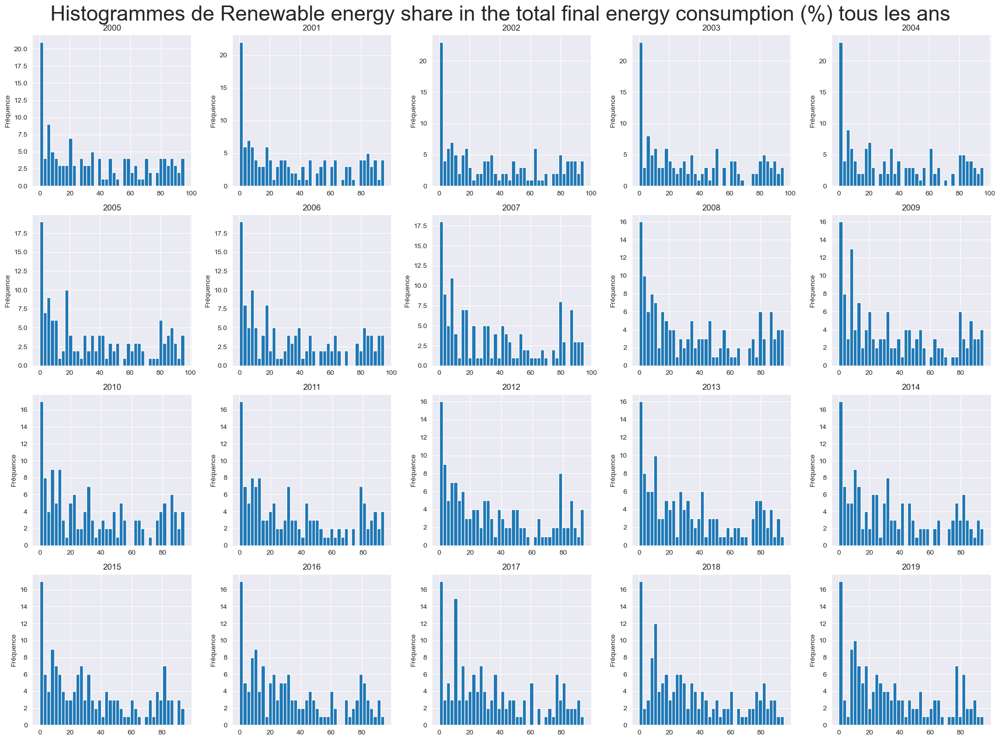

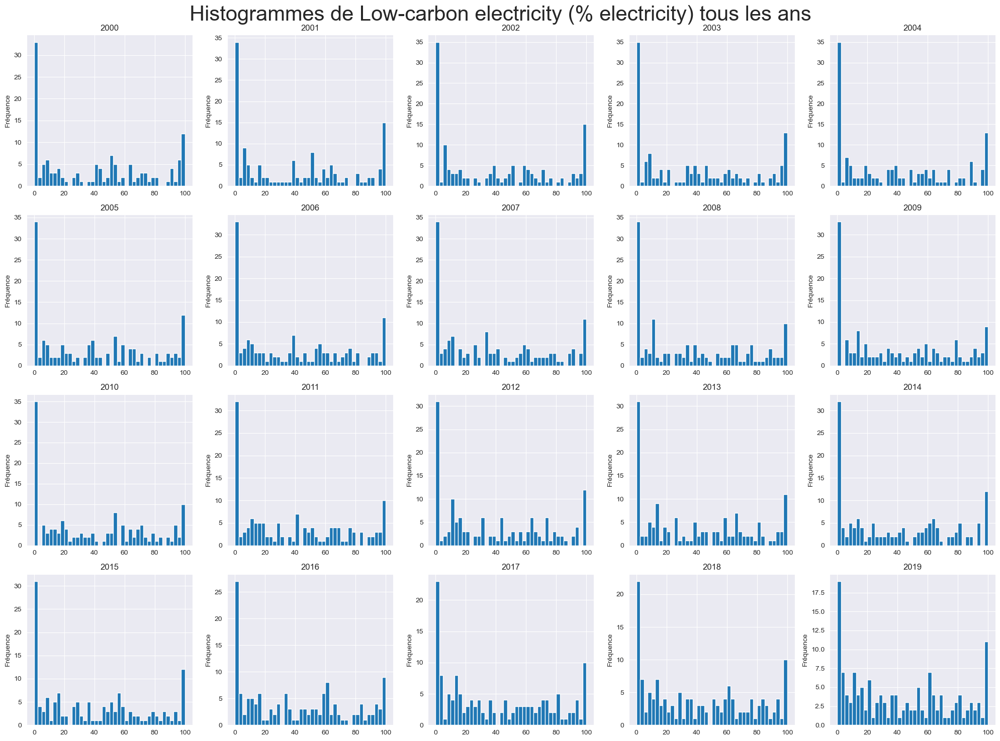

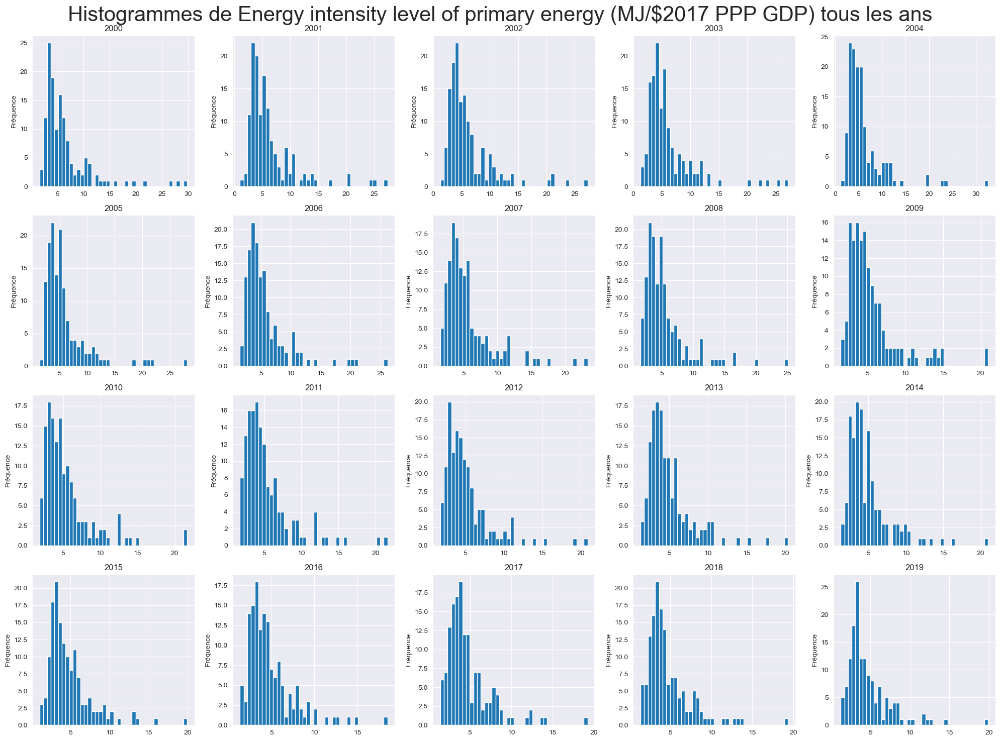

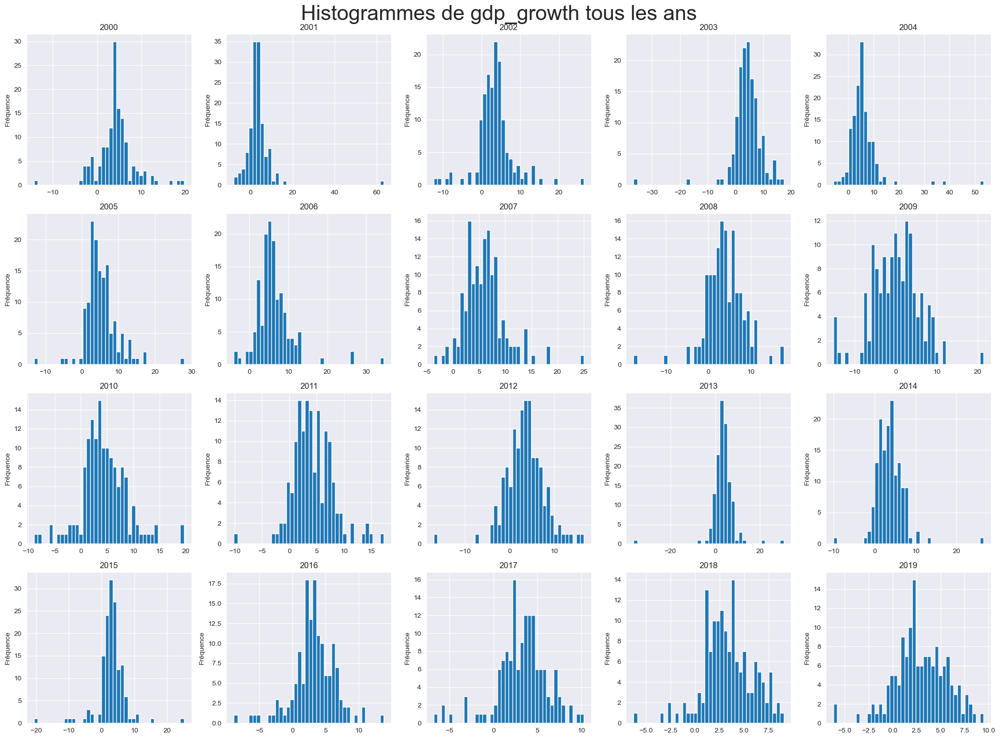

In [ ]:
years = data['Year'].unique()
years = np.sort(years)
K = [4, 8, 10, 12]

for k in K:
    var = data.columns[k]
    fig, axs = plt.subplots(4, 5, figsize = (20, 15))
    fig.suptitle(f'Histogrammes de {var} tous les ans', fontsize = 30)
    axs = axs.flatten()
    # Histogramme de var tous les ans
    for i, year in enumerate(years):
        var_year = data[data['Year'] == year][var]
        axs[i].hist(var_year, bins = 40)
        axs[i].set_ylabel('Fréquence')
        axs[i].set_title(year)
        axs[i].grid(True)
    plt.tight_layout()
    plt.show()

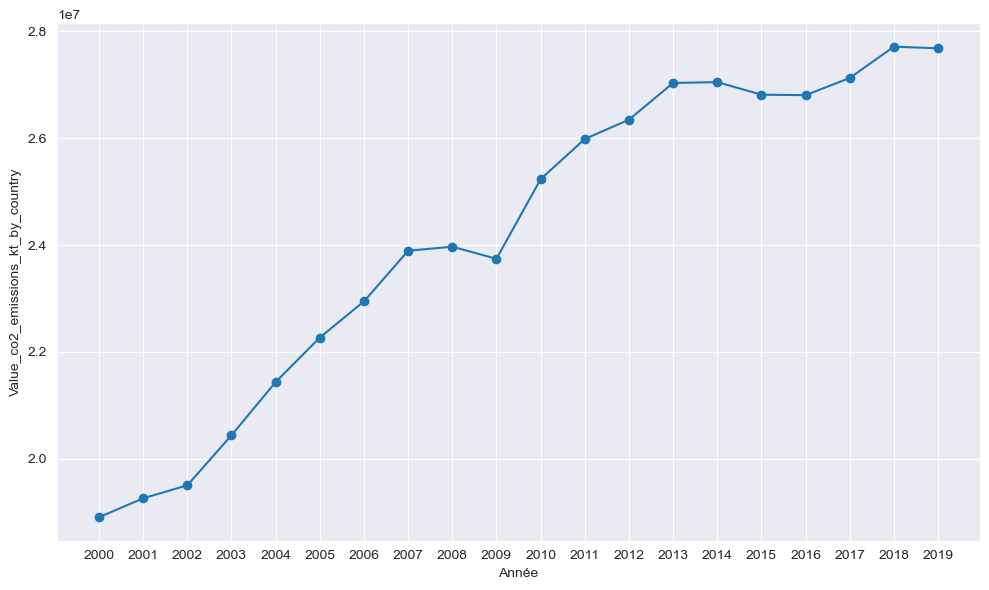

In [ ]:
# Calcule la somme des valeurs de Low-carbon electricity (% electricity) pour chaque année
CO2_year = data.groupby('Year')['Value_co2_emissions_kt_by_country'].sum()

plt.figure(figsize = (10, 6))
plt.plot(CO2_year.index, CO2_year.values, marker = 'o')
plt.xlabel('Année')
plt.ylabel('Value_co2_emissions_kt_by_country')
plt.grid(True)
plt.tight_layout()
plt.show()

On remarque que la distribution des points et le comportement des pays varie avec les années et que certaines variables voient leurs valeurs augmenter.

# **7- Analyse en Composantes Principales appliquée aux données transformées**

Nous allons procéder maintenant à une Analyse en Composante Principales sur les données dans l'optique de déterminer des "profils types" et des interprétations sur les variables. Il nous semble pertinent d'afficher le graphe des individus coloré de différentes couleurs en fonction des continents, et coloré différemment selon si le pays correspond à un des 5 plus gros émetteurs de CO2 mondiaux ou non.

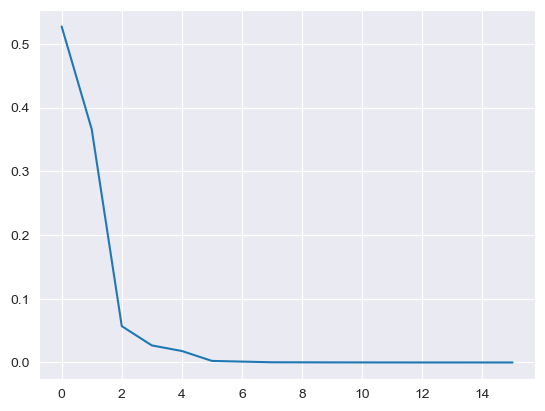

In [ ]:
# Application de l'ACP au jeu de données transformé
pca = PCA()
C = pca.fit_transform(data_log)

# Plot de la variance expliquée qui nous permet d'appliquer la méthode du coude
plt.plot(pca.explained_variance_ratio_)
plt.show()

La méthode du coude suggère de conserver deux composantes pour l'analyse en composantes principales. Nous allons donc projeter les individus et les variables selon les dimensions 1 et 2.

## COLORATION SELON LES EMETTEURS DE CO2 ET LES CONTINENTS

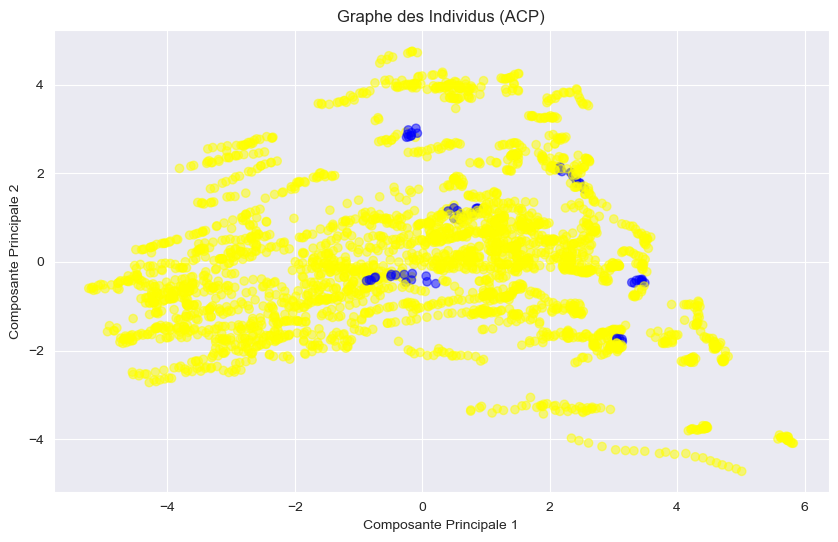

In [ ]:
# Centrer et réduire des données transformées
scaler = StandardScaler()
data_log_normalized = scaler.fit_transform(data_log)

# Application de l'ACP
pca = PCA(n_components = 3)
C = pca.fit_transform(data_log_normalized)
data_log_normalized = pd.DataFrame(data_log_normalized, columns = data_log.columns)
data_log_normalized['Entity'] = data_log_full['Entity']

# Isolement des 5 pays les plus émetteurs de CO2
top_emitting_countries = ['China', 'United States', 'Japan', 'Germany']

# Créer une liste de même couleur pour les 5 pays émetteurs et d'une autre couleur pour les autres pays
colors = ['blue' if country in top_emitting_countries else 'yellow' for country in data_log_normalized['Entity']]

# Tracer le graphe des individus coloré en fonction de s'ils font parti des 5 pays les plus émetteurs de CO2
plt.figure(figsize = (10, 6))
plt.scatter(C[:, 0], C[:, 1], c = colors, alpha = 0.5)
plt.xlabel('Composante Principale 1')
plt.ylabel('Composante Principale 2')
plt.title('Graphe des Individus (ACP)')
plt.grid(True)
plt.show()

Les points en bleu correspondent aux individus liés aux 5 pays les plus émetteurs en CO2. Les points qui se détachent vers le haut ayant une projection atypique par rapport aux autres variables correspondent à la Chine. Regroupons désormais les individus par continents afin de dégager des interprétations plus clairs sur les données.

In [ ]:
%%capture
# Ajoute la colonne continent
data_log_normalized['Continent'] = coco.convert(names = data_log_normalized['Entity'], to = 'continent')

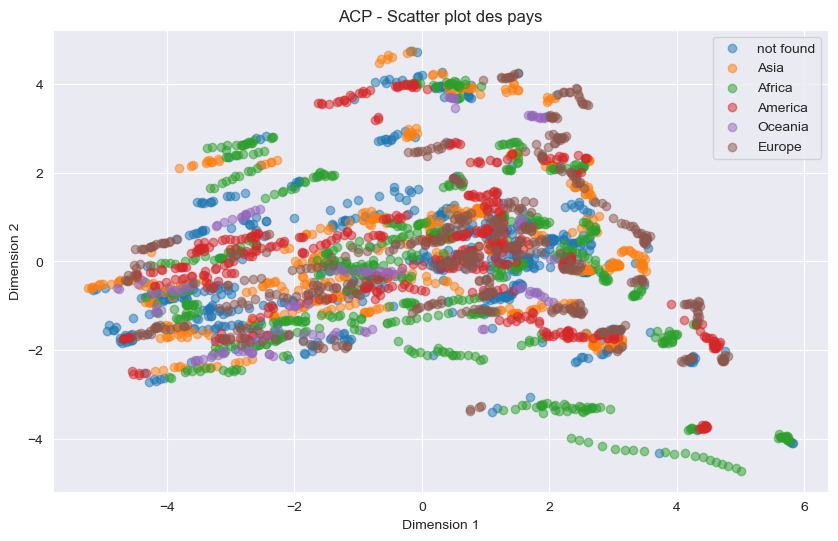

In [ ]:
plt.figure(figsize =(10, 6))
for continent in data_log_normalized['Continent'].unique():
    mask = data_log_normalized['Continent'] == continent
    plt.scatter(C[mask, 0], C[mask, 1], label = continent, alpha = 0.5)

plt.xlabel('Dimension 1')
plt.ylabel('Dimension 2')
plt.title('ACP - Scatter plot des pays')
plt.grid(True)
plt.legend()
plt.show()

Le graphe des individus suggère une répartition particulière des individus liés au continent à l'avancée de développement du pays. En effet, on remarque que la plupart des valeurs les plus faibles ou les plus importantes sur le premier plan factoriel de l'ACP correspond majoritairement à des pays africains (en vert) et asiatiques (en jaune), et que les profils des points par continent semble différer. En isolant pays par pays sur la projection des individus de l'ACP, nous remarquions que les points les plus corrélés positivement avec la composante 2 correspondent en effet aux observations sur la Chine, le Burundi et le Bangladesh. La présence du Bangladesh et du Burundi dans les individus les plus corrélés positivement avec l'axe 2 suggère que les pays présentant des valeurs extrêmes en matière de manque d'accès à l'énergie, ou des valeurs très différentes de celles des autres pays, se verront très corrélés positivement et contribuent davantage que les autres à la composante. Projetons maintenant les variables sur les deux premières composantes principales afin d'affiner nos premières conjectures sur l'interprétation de ces composantes.

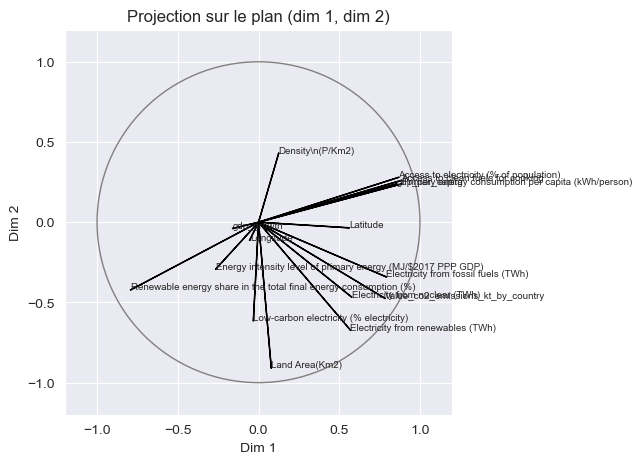

In [ ]:
coord1 = pca.components_[0] * np.sqrt(pca.explained_variance_[0])
coord2 = pca.components_[1] * np.sqrt(pca.explained_variance_[1])

fig = plt.figure(figsize = (5,5))
ax = fig.add_subplot(1, 1, 1)
for i, j, nom in zip(coord1,coord2, data_log[:-1].columns):
    plt.text(i, j, nom, fontsize = 7)
    plt.arrow(0, 0, i, j, color = 'black')
plt.axis((-1.2, 1.2, -1.2, 1.2))
plt.xlabel('Dim 1')
plt.ylabel('Dim 2')
plt.title('Projection sur le plan (dim 1, dim 2)')
# Cercle
c = plt.Circle((0, 0), radius = 1, color = 'gray', fill = False)
ax.add_patch(c)
plt.show()

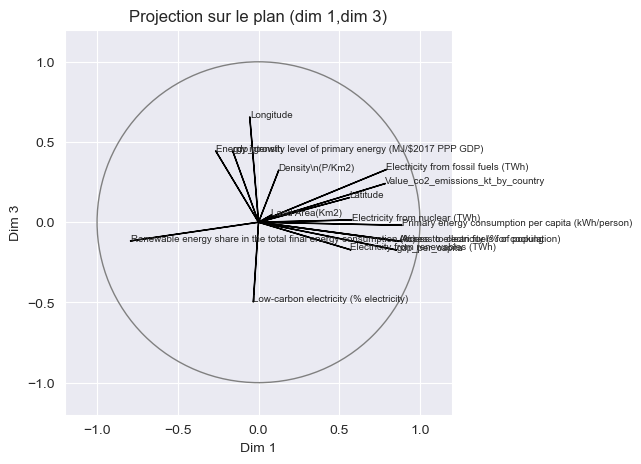

In [ ]:
coord1 = pca.components_[0] * np.sqrt(pca.explained_variance_[0])
coord2 = pca.components_[2] * np.sqrt(pca.explained_variance_[2])

fig = plt.figure(figsize = (5,5))
ax = fig.add_subplot(1, 1, 1)
for i, j, nom in zip(coord1, coord2, data_log[:-1].columns):
    plt.text(i, j, nom, fontsize = 7)
    plt.arrow(0, 0, i, j, color = 'black')
plt.axis((-1.2, 1.2, -1.2, 1.2))
plt.xlabel('Dim 1')
plt.ylabel('Dim 3')
plt.title('Projection sur le plan (dim 1,dim 3)')
# Cercle
c = plt.Circle((0, 0), radius = 1, color = 'gray', fill = False)
ax.add_patch(c)
plt.show()

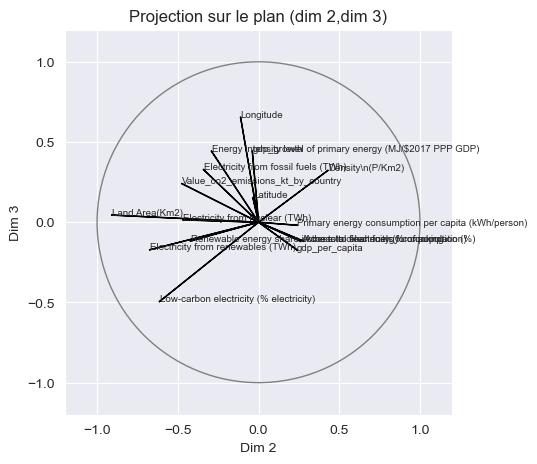

In [ ]:
coord1 = pca.components_[1] * np.sqrt(pca.explained_variance_[1])
coord2 = pca.components_[2] * np.sqrt(pca.explained_variance_[2])

fig = plt.figure(figsize = (5,5))
ax = fig.add_subplot(1, 1, 1)
for i, j, nom in zip(coord1, coord2, data_log[:-1].columns):
    plt.text(i, j, nom, fontsize = 7)
    plt.arrow(0, 0, i, j, color = 'black')
plt.axis((-1.2, 1.2, -1.2, 1.2))
plt.xlabel('Dim 2')
plt.ylabel('Dim 3')
plt.title('Projection sur le plan (dim 2,dim 3)')
# Cercle
c = plt.Circle((0, 0), radius = 1, color = 'gray', fill = False)
ax.add_patch(c)
plt.show()

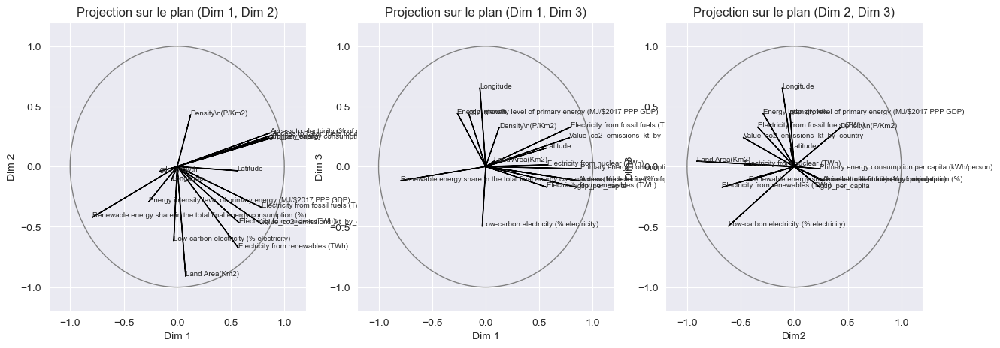

In [ ]:
fig, axes = plt.subplots(1, 3, figsize = (15, 5))

# Graphique pour la projection sur le plan (Dim1, Dim2)
coord1 = pca.components_[0] * np.sqrt(pca.explained_variance_[0])
coord2 = pca.components_[1] * np.sqrt(pca.explained_variance_[1])

ax = axes[0]  # Première colonne
for i, j, nom in zip(coord1, coord2, data_log[:-1].columns):
    ax.text(i, j, nom, fontsize = 7)
    ax.arrow(0, 0, i, j, color = 'black')
ax.axis((-1.2, 1.2, -1.2, 1.2))
ax.set_xlabel('Dim 1')
ax.set_ylabel('Dim 2')
ax.set_title('Projection sur le plan (Dim 1, Dim 2)')
c = plt.Circle((0, 0), radius = 1, color = 'gray', fill = False)
ax.add_patch(c)

# Graphique pour la projection sur le plan (Dim1, Dim3)
coord1 = pca.components_[0] * np.sqrt(pca.explained_variance_[0])
coord2 = pca.components_[2] * np.sqrt(pca.explained_variance_[2])

ax = axes[1]  # Deuxième colonne
for i, j, nom in zip(coord1, coord2, data_log[:-1].columns):
    ax.text(i, j, nom, fontsize = 7)
    ax.arrow(0, 0, i, j, color = 'black')
ax.axis((-1.2, 1.2, -1.2, 1.2))
ax.set_xlabel('Dim 1')
ax.set_ylabel('Dim 3')
ax.set_title('Projection sur le plan (Dim 1, Dim 3)')
c = plt.Circle((0, 0), radius = 1, color = 'gray', fill = False)
ax.add_patch(c)

# Graphique pour la projection sur le plan (Dim2, Dim3)
coord1 = pca.components_[1] * np.sqrt(pca.explained_variance_[1])
coord2 = pca.components_[2] * np.sqrt(pca.explained_variance_[2])

ax = axes[2]  # Troisième colonne
for i, j, nom in zip(coord1, coord2, data_log[:-1].columns):
    ax.text(i, j, nom, fontsize = 7)
    ax.arrow(0, 0, i, j, color = 'black')
ax.axis((-1.2, 1.2, -1.2, 1.2))
ax.set_xlabel('Dim2')
ax.set_ylabel('Dim3')
ax.set_title('Projection sur le plan (Dim 2, Dim 3)')
c = plt.Circle((0, 0), radius = 1, color = 'gray', fill = False)
ax.add_patch(c)

plt.show()

On remarque que la dimension deux est l'opposée de la dimension 2 obtenue en R. Cela est dû au choix de la valeur propre lors du calcul de l'ACP. La composante 2 semble fortement corrélée négativement avec la variable low carbon electricity et les autres variables qui ont pour la plupart des observations, de grandes valeurs. A l'inverse, les variables corrélées fortement positivement sont celles qui présentent de faibles valeurs majoritairement et dont l'histogramme est très décalé vers la gauche. On peut conjecturer qu'elle décrit la valeur majoritaire de la variable pour les différents pays et les différentes données. Les variables tres corrélées positivement avec la composante 1 sont celles qui présentent le plus de distributions déséquilibrées d'apres les histogrammes et celles les plus corrélées négativement sont celles ayant la distribution la plus équilibrée et uniforme. Cela semble donc traduire la concentration des données en fonction des plages de valeur, et donc distinguer d'un côté les variables aux répartitions uniformes et hétérogènes.

En résumé, la dimension 1 traduit la répartition homogène (corrélation négative) ou hétérogène (corrélation positive) des points. Quant à la dimension 2 elle semble représenter la distribution moyenne et être corrélée positivement avec les variables qui ont une distribution moyenne des points faible et négativement lorsqu'elle est forte. La variable traduisant le CO2 est fortement corrélée positivement avec les deux premières composantes principales.

Sur les cercles de projections pour les données transformées, la variable "low carbon energy" est de surcroit bien représentée, tres corrélé négativement sur la dimension 2 et un peu positivement sur la dimension 1 car c'est une variable ayant une répartition moins proche d'une gaussienne que les autres, qui présente donc des valeurs plutôt hétérogènes, et car ses valeurs sont très concentrées vers la valeur maximale et de grandes valeurs.

            plutot min
             |
homogene <--------> hétérogene
             |

             plutot max

L'analyse multidimensionnelle couplée à l'Analyse en Composante Principale permettent donc de pointer du doigt la répartition inhomogène et très inégalitaire dans l'accès aux énergies et aux ressources. Il semble y avoir des comportements types très différents entre les pays et les continents du globe.

# II- Modélisation

Nous allons essayer différentes méthodes de prédiction sur les variables. La partie 1 ayant révélé la forte hétérogénéité des données et des échelles, nous choisissons de centrer réduire les données. Cela permettra ainsi d'avoir davantage de résultats sur les algorithmes à distance euclidienne et ceux reliés aux poids des différentes variables comme les méthodes de régression

## Imports pour la partie modélisation

# **1- Division du jeu de données en échantillons d'apprentissage et test**

Cette étape est nécessaire car elle permet de tester le modèle sur un autre jeu de données sur lequel il n'a pas été entraîné et donc de tester la robustivité du modèle à de nouvelles données. Cela permet d'éviter d'obtenir des estimations trop optimistes sur l'erreur du modèle et d'étudier son adaptation à de nouvelles données, pour mieux en déduire ses performances en conditions réelles.

D'autre part, l'étape de standardisation que nous effectuons ici au cours de laquelle les variables sont divisées par leur écart-type, est primordiale afin de pouvoir appliquer des méthodes non linéaires pour la prédiction et pour s'assurer de la convergence et des performances des modèles.

In [ ]:
data_log = data_log.drop('Electricity from fossil fuels (TWh)', axis = 1)

In [ ]:
# Diviser les données en échantillons d'apprentissage et de test
X_train, X_test, Y_train, Y_test = train_test_split(data_log.drop(columns = ['Value_co2_emissions_kt_by_country']),
                                                    data_log['Value_co2_emissions_kt_by_country'],
                                                    test_size = 0.2,
                                                    random_state = 11)
scaler = StandardScaler()
scaler.fit(X_train)

# Centrer et réduire les données d'apprentissage et de test
X_train_normalized = scaler.transform(X_train)
X_test_normalized = scaler.transform(X_test)

X_train_normalized = pd.DataFrame(X_train_normalized, columns = X_train.columns)
X_test_normalized = pd.DataFrame(X_test_normalized, columns = X_test.columns)

X_train, X_test = X_train_normalized, X_test_normalized

print("Dimensions de X_train :", X_train.shape)
print("Dimensions de Y_train :", Y_train.shape)
print("Dimensions de X_test :", X_test.shape)
print("Dimensions de Y_test :", Y_test.shape)

Dimensions de X_train : (2294, 14)
Dimensions de Y_train : (2294,)
Dimensions de X_test : (574, 14)
Dimensions de Y_test : (574,)


# **2- Comparaisons de performances des algorithmes de prédiction**

Définissions des listes qui vont regrouper les temps de calcul et l'erreur quadratique de chacun des futurs algorithmes de prédictions

In [ ]:
MSE_list = []
temps_list = []

## **A- Prédiction par modèle de régression linéaire sans sélection de variables sans pénalisation**

Valeur de l'intercept :  9.30675930654884

Légende des coefs :  Index(['Access to electricity (% of population)',
       'Access to clean fuels for cooking',
       'Renewable energy share in the total final energy consumption (%)',
       'Electricity from nuclear (TWh)', 'Electricity from renewables (TWh)',
       'Low-carbon electricity (% electricity)',
       'Primary energy consumption per capita (kWh/person)',
       'Energy intensity level of primary energy (MJ/$2017 PPP GDP)',
       'gdp_growth', 'gdp_per_capita', 'Density\n(P/Km2)', 'Land Area(Km2)',
       'Latitude', 'Longitude'],
      dtype='object')

Valeur des coefs :  [ 0.35116772 -0.17687227 -0.4242363  -0.02153499 -0.08714035 -0.01012297
  0.71588798  0.13786028 -0.02981753  0.51399835  1.36921685  2.50704355
  0.03588377  0.00756511]

Valeur du R² sur les données de test :  0.9806157027167239

Valeur du RMSE :  0.32104780773112596

Valeur du MSE :  0.10307169484896203



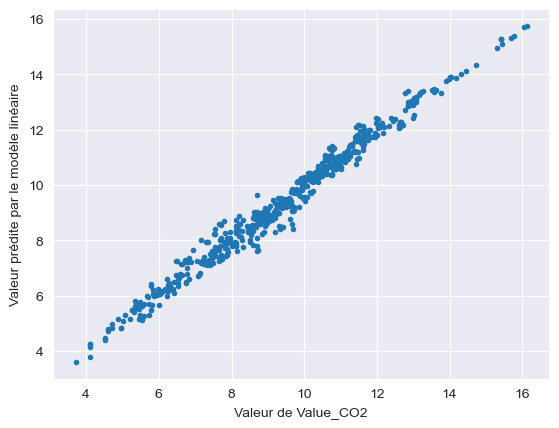

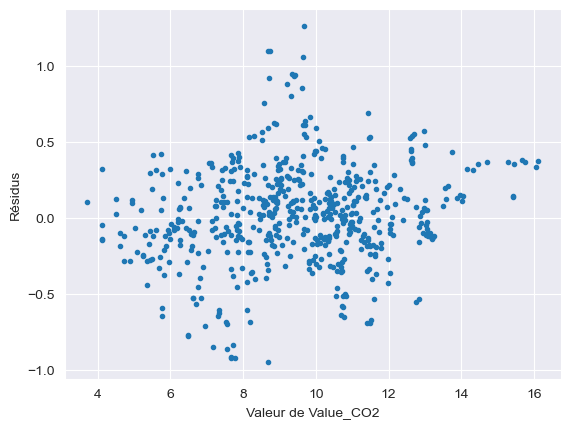

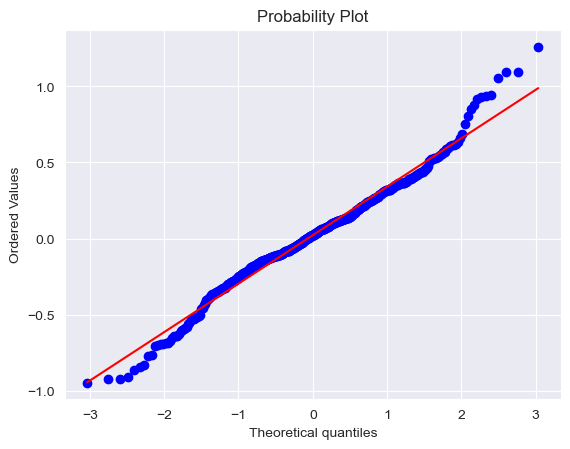

In [ ]:
# Création du modele de regression lineaire
reglin = LinearRegression()

y = Y_train
X = X_train

tps0 = time.perf_counter()

reglin.fit(X,y)
pred = reglin.predict(X_test)

tps1 = (time.perf_counter() - tps0)
temps_list.append(('Reglin', tps1))

# Affichage du résultat de l'ajustement
print("Valeur de l'intercept : ", reglin.intercept_)
print("")
print("Légende des coefs : ", X_test.columns)
print("")
print("Valeur des coefs : ", reglin.coef_)
print("")

# Calcul du R² sur les données de test
r2_test = reglin.score(X_test, Y_test)
print("Valeur du R² sur les données de test : ", r2_test)
print("")

# Calcul du RMSE
RMSE = np.sqrt(((Y_test - pred) ** 2).sum() / len(Y_test))
print("Valeur du RMSE : ", RMSE)
print("")

# Calcul du MSE
MSE = mean_squared_error(pred, Y_test)
print("Valeur du MSE : ", MSE)
print("")
MSE_list.append(('Reglin', MSE))

# Affichage des prédictions par rapport aux valeurs réelles
plt.plot(Y_test, pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Valeur prédite par le modèle linéaire")
plt.show()

# Affichage des résidus
plt.plot(Y_test, Y_test - pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Résidus")
plt.show()

stats.probplot(Y_test - pred, dist = "norm", plot = pylab)
pylab.show()
plt.show()

Le coefficient de détermination linéaire de Pearson R² semble proche de 1 et vaut 0.981. Ceci est un bon indicateur de la bonne qualité de notre prédiction. La regression linéaire semble donner de plutôt bons résultats à premiere vue. Sur l'échantillon test, les prédictions (Y prédit) semblent plutôt proches du Y réel, puisque l'on repère bien une droite d'équation Y=X bien nette sur le graphe des valeurs observées en fonction des valeurs prédites. Et la forme du graphe représentant les résidus n'a pas une forme si proche d'un amas de points, ce qui est un  indicateur d'une certaine hétéroscédasticité du modèle.

Au regard des coefficients assiciés à chaque variable explicative de la regression, on remarque que les coefficients qui ont le plus grand impact dans la prédiction du CO2 sont Density\n(P/Km2) et Land Area(Km2) ce qui est cohérent avec les valeurs obtenues dans l'analyse descriptive des données.

Au vue de la faible valeur de certains coefficients de la regression linéaire, une sélection de variables pourrait être une idée pertinente pour que le modèle ne soit pas overfitté.





( selon les fois Les variables étant associées à une forte valeur de coefficients correspondent à data3_full[7] et data3_full[8], c'est a dire 'Electricity from nuclear (TWh)' et 'Electricity from renewables (TWh)' ou land area et density et Primrary energy consumption qui contribuent le plus.)


## **B- Prédiction par modèle de régression linéaire avec sélection de variables sans pénalisation**

Nous allons donc à présent calculer le critère BIC sur les variables obtenues avec notre modèle afin de réaliser une sélection de variables pour ne conserver que les variables les plus importantes et éviter d'avoir un modèle surparamétré. Ceci s'effectue de la manière suivante.

In [ ]:
def select_variables(X, y, criterion = 'aic'):
    predictors = X.columns
    predictors = [col for col in predictors if col != 'outlier' and col != 'Somme_gdp']
    best_criterion = float('inf')
    best_subset = None
    for k in range(1, len(predictors) + 1):
        for subset in itertools.combinations(predictors, k):
            X_subset = X[list(subset)]
            X_subset = sm.add_constant(X_subset)
            model = sm.OLS(y, X_subset).fit()
            if criterion == 'aic':
                criterion_value = model.aic
            elif criterion == 'bic':
                criterion_value = model.bic
            elif criterion == 'cp':
                n = len(y)
                mse = np.mean(model.resid ** 2)
                criterion_value = (mse / (n * model.scale)) + 2 * k
            else:
                raise ValueError("Invalid criterion. Use 'aic', 'bic', or 'cp'.")
            if criterion_value < best_criterion:
                best_criterion = criterion_value
                best_subset = subset
    return best_subset

# Supprimer les valeurs manquantes
X_train = X_train.dropna().reset_index(drop = True)
Y_train = Y_train.dropna().reset_index(drop = True)
X_test = X_test.dropna().reset_index(drop = True)
Y_test = Y_test.dropna().reset_index(drop = True)

In [ ]:
# Avec le critere AIC

best_subset_AIC = select_variables(X_train, Y_train, criterion = 'aic')

X_subset = X_train[list(best_subset_AIC)]
X_subset = sm.add_constant(X_subset)
final_model = sm.OLS(Y_train, X_subset).fit()

print(final_model.summary())

                                    OLS Regression Results                                   
Dep. Variable:     Value_co2_emissions_kt_by_country   R-squared:                       0.982
Model:                                           OLS   Adj. R-squared:                  0.982
Method:                                Least Squares   F-statistic:                 1.023e+04
Date:                               Sun, 26 May 2024   Prob (F-statistic):               0.00
Time:                                       16:04:00   Log-Likelihood:                -671.75
No. Observations:                               2294   AIC:                             1369.
Df Residuals:                                   2281   BIC:                             1444.
Df Model:                                         12                                         
Covariance Type:                           nonrobust                                         
                                                            

In [ ]:
# Avec le critere BIC

best_subset_BIC = select_variables(X_train, Y_train, criterion = 'bic')

X_subset = X_train[list(best_subset_BIC)]
X_subset = sm.add_constant(X_subset)
final_model = sm.OLS(Y_train, X_subset).fit()

print(final_model.summary())

                                    OLS Regression Results                                   
Dep. Variable:     Value_co2_emissions_kt_by_country   R-squared:                       0.982
Model:                                           OLS   Adj. R-squared:                  0.982
Method:                                Least Squares   F-statistic:                 1.114e+04
Date:                               Sun, 26 May 2024   Prob (F-statistic):               0.00
Time:                                       16:04:49   Log-Likelihood:                -674.42
No. Observations:                               2294   AIC:                             1373.
Df Residuals:                                   2282   BIC:                             1442.
Df Model:                                         11                                         
Covariance Type:                           nonrobust                                         
                                                            

Cet algorithme essaie d'optimiser le nombre de variables à conserver afin de trouver le meilleur compromis possible entre la complexité du modèle et sa capacité à prédire de nouvelles données. Il sélectionne les variables à conserver en calculant les performances de différents modèles avec une combinaison différente de paramètres et conserve comme meilleur modèle celui qui minimise le critère BIC (Bayesian Information Criterion). Ici on arrive à un BIC minimisé égal à 1444 pour le modèle ci-desssus qui a été conservé.

La sortie de la fonction renvoie le modèle final après sélection de variables. On voit qu'il ne reste plus que 12 variables sur les 14 variables initiales. Il a donc retiré seulement les variables Longitude et Low carbon energy. Cela était prévisible puisqu'il s'agissait des deux variables aux coefficients les plus faibles dans le modèle de regression linéaire sans pénalisation. Cela signifie que relativement peu de variables étaient redondantes et à supprimer du jeu de données d'après le critère BIC et que l'on peut difficilement beaucoup améliorer les performancse de la regression linéaire initiale par sélection de variables. On observe que le R² demeure autour de 0.98 après suppression de variable donc retirer ces deux variables semble pertinent et peu impactant dans le modèle de regression linéaire.

[On voit que les coefficients demeurent sensiblement à la même échelle sauf latitude et gdp_growth qui semblent etre des variables un peu moins importantes dans le modele apres selection de variable et Electricity from renewables et nuclear qui semblent fortement avoir de l'importance.]


[RETIRER LES VARIABLES DONNEES PAR LA SELECTION DE VARIABLE POUR LA SUITE]



# **C- Prédiction par modèle de régression linéaire (le meilleur de A et B) avec pénalisation**

Parmi les différents critères de pénalisation que nous avons à disposition à appliquer pour notre modèle de régression linéaire, celui qui retient le plus notre attention est la pénalisation LASSO. En effet, nous disposons d'un nombre importants de variables (14) pour prédire la valeur de la variable CO2, et certains faibles coefficients associés aux variables pour la régression linéaire suggèrent que certaines variables ont davantage de poids que d'autres dans la prédiction de CO2 et que d'autres n'apporteraient pas beaucoup d'information pour la prédiction.

 La pénalité du LASSO est une pénalité reliée à la norme 1 qui annule les variables les moins significatives du modèle tandis que la pénalité du Ridge reliée à la norme 2 contribue plutôt à réduire la norme des coefficients des variables. Il serait ainsi pertinent d'utiliser la pénalisation LASSO afin de retirer les variables les moins significatives du modèle et éviter d'overfitter les données et mieux généraliser à de nouvelles données.

On aurait aussi pu appliquer la pénalisation Ridge pour réduire la norme des coefficients, mais cela ne nous semble pas pertinent puisque le principal problème est le nombre de paramètres très grand, et non la disparité des valeurs des coefficients des variables explicatives. Cela aurait pu être utile si l'on avait constaté de grandes disparités en norme pour les plus grands coefficients du modèle de regression linéaire


La pénalisation LASSO nous permet d'obtenir les résultats ci-dessous.

Meilleur R2 : 0.975626

Meilleur paramètre = {'alpha': 0.05}

Valeur du MSE :  0.1335439959038499

Valeur du R² :  0.9748848942399738



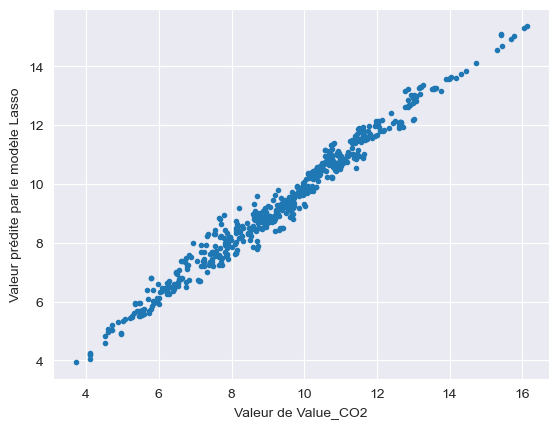

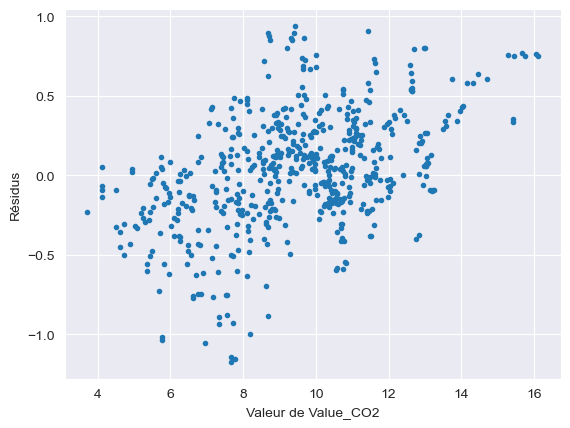

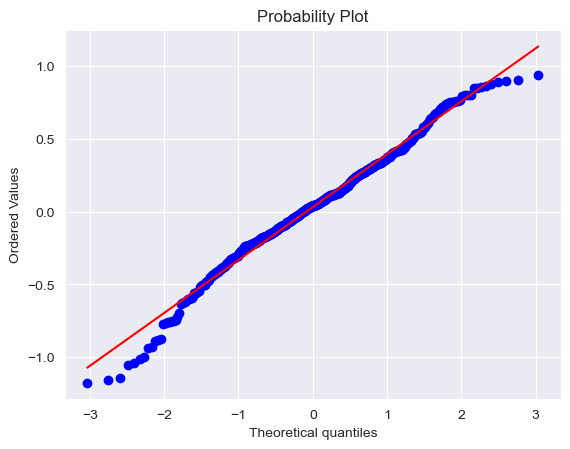

Variables mises à zéro par LASSO : Index(['Access to clean fuels for cooking',
       'Electricity from renewables (TWh)',
       'Low-carbon electricity (% electricity)', 'gdp_growth', 'Longitude'],
      dtype='object')


In [ ]:
# LASSO

# Grille des valeurs du paramètre alpha à optimiser
param = [{"alpha":[0.05,0.1,0.2,0.3,0.4,0.5,1]}]

tps0 = time.perf_counter()

regLasso = GridSearchCV(linear_model.Lasso(), param, cv = 5, n_jobs = -1)
regLassOpt = regLasso.fit(X_train, Y_train)

# Paramètre optimal
regLassOpt.best_params_["alpha"]
pred = regLassOpt.predict(X_test)

tps1 = (time.perf_counter() - tps0)
temps_list.append(('LASSO', tps1))

print("Meilleur R2 : %f" % (regLassOpt.best_score_))
print("")
print("Meilleur paramètre = %s" % (regLassOpt.best_params_))
print("")

# Calcul du MSE
MSE = mean_squared_error(pred,Y_test)
print("Valeur du MSE : ", MSE)
print("")
MSE_list.append(('LASSO', MSE))

# Calcul du R²
print("Valeur du R² : ",r2_score(Y_test, pred))
print("")

# Affichage des prédictions par rapport aux valeurs réelles
plt.plot(Y_test, pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Valeur prédite par le modèle Lasso")
plt.show()

# Affichage des résidus
plt.plot(Y_test, Y_test - pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Résidus")
plt.show()

stats.probplot(Y_test - pred, dist = "norm", plot = pylab)
pylab.show()
plt.show()

# Variables mises à zéro par LASSO
variables_mises_a_zero = X_train.columns[regLassOpt.best_estimator_.coef_ == 0]
print("Variables mises à zéro par LASSO :", variables_mises_a_zero)

Dans le cadre de la pénalisation LASSO, le paramètre de pénalisation $\lambda$ est le paramètre que nous devons optimiser. Plus la valeur de lambda sera grande plus on donne de l'importance à la pénalisation et plus l'algorithme va retirer de variables. Plus le lambda est petit, plus l'on retire la pénalité et plus l'on va avoir de paramètres pour notre modèle qui va alors davantage fitter aux données, mais perdre potentiellement en capacité de généralisation. La valeur de ce paramètre se détermine par validation croisée. Dans notre cas, le meilleur paramètre lambda de pénalisation à fixer pour optimiser le MSE et obtenir les meilleurs résultats vaut 0.05. Notre MSE vaut 0.13.

La prédiction par modèle de regression linéaire avec pénalisation donne un légerement moins bon résultat pour le R² que pour la prédiction sans pénalisation. Cela était prévisible puisque le R² est un score qui tend à favoriser les modèles overfitté et ici le lasso a annulé certains paramètres de la régression linéaire. Cependant bien que l'on diminue le R² cela ne veut pas forcément dire que le LASSO a été complètement inutile puisque l'on aura réduit la complexité du modèle qui sera ainsi plus généralisable.

On retrouve tout de même des performances sensiblement proches au vu du R² et du MSE. Réduire le nombre de variables non nulles semble être une idée pertinente pour réduire la complexité du modèle tout en obtenant des résultats satisfaisants. La pénalisation LASSO semble dans un premier temps annuler les variables Longitude et Low Carbon electricity de façon analogue à ce qu'on a obtenu précédemment quand on appliquait la sélection de variable par critère BIC, mais aussi gdp_growth', 'energy from renewables' et 'Access to clean fuels for cooking'. Le modèle a donc encore moins de paramètres que les modèles de regression linéaire précédents, ce qui explique le R² moins bon. Et elle confirme aussi que les autres variables ont de l'importance dans la prédiction de la variable CO2.

# **D- SVR**

A present, nous allons tenter d'appliquer un modèle de Support Vector Regression (SVR) sur les données. Les algorithmes de SVR sont en effet très utilisés pour obtenir des prédictions avec de bons résultats de précision, en fonction du choix du noyau que nous fixons. L'intérêt des méthodes par noyau comme la SVR est qu'elles sont non linéaires et permetent de traiter des donnés complexes des lors qu'on peut déterminer des noyaux dessus et transformer les données dans un espace de Hilbert à noyau reproduisant. Leur prédiction se base sur la résolution d'un problème de minimisation pour trouver la fonction qui minimise l'erreur de prédiction et la complexité du modèle à la fois. Nous allons dans un premier temps tester la SVR à l'aide d'un noyau linéaire puis d'un noyau radial pour comparer les performances entre les deux noyaux.

Meilleur score : 0.019057

Meilleur paramètre : {'C': 1.4}

Erreur de prévision :  0.01966825261627636

Valeur du R² :  0.9803317473837236

Valeur du MSE :  0.10458156425542159



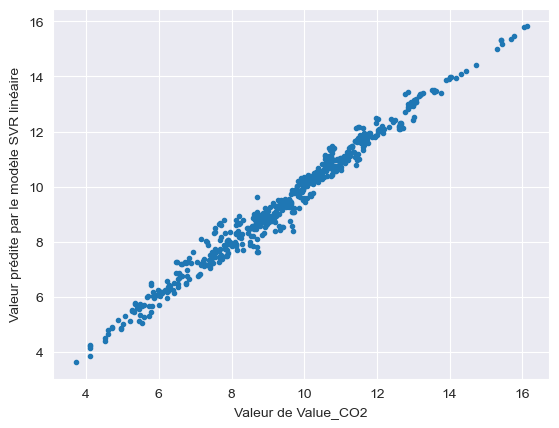

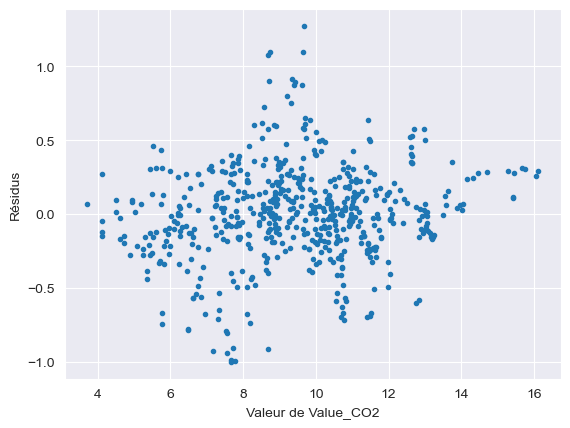

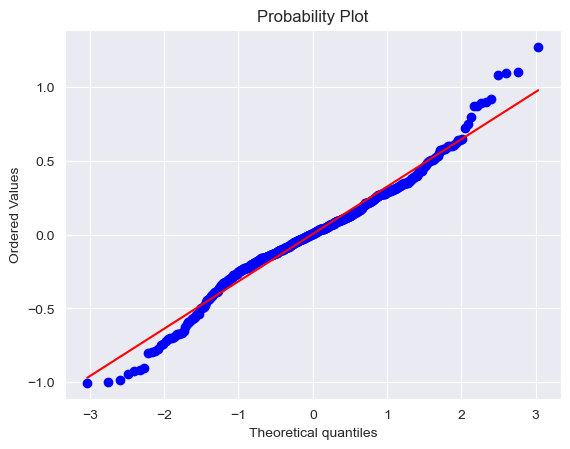

In [ ]:
# SVR linéaire

# Grille des valeurs du paramètre C à optimiser
param = [{"C": [0.4, 0.5, 0.6, 0.8, 1, 1.4]}]

tps0 = time.perf_counter()

svr_linear = GridSearchCV(SVR(kernel = 'linear'), param, cv = 10, n_jobs = -1)
svr_linear_optimal = svr_linear.fit(X_train, Y_train)
pred = svr_linear_optimal.predict(X_test)

tps1 = (time.perf_counter() - tps0)
temps_list.append(('SVR lin', tps1))

# Paramètre optimal
print("Meilleur score : %f" % (1. - svr_linear_optimal.best_score_))
print("")
print("Meilleur paramètre : %s" % (svr_linear_optimal.best_params_))
print("")

# Erreur de prévision sur le test
print("Erreur de prévision : ", (1 - svr_linear_optimal.score(X_test, Y_test)))
print("")

# Calcul du R²
print("Valeur du R² : ", r2_score(Y_test, pred))
print("")

# Calcul du MSE
MSE = mean_squared_error(pred,Y_test)
print("Valeur du MSE : ", MSE)
print("")
MSE_list.append(('SVR lin', MSE))

# Affichage des prédictions par rapport aux valeurs réelles
plt.plot(Y_test, pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Valeur prédite par le modèle SVR linéaire")
plt.show()

# Affichage des résidus
plt.plot(Y_test, Y_test - pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Résidus")
plt.show()

stats.probplot(Y_test - pred, dist = "norm", plot = pylab)
pylab.show()
plt.show()

Meilleur score : 0.004480

Meilleur paramètre : {'C': 25}

Erreur de prévision :  0.005444949565942325

Valeur du R² :  0.9945550504340577

Valeur du MSE :  0.028952309796290043



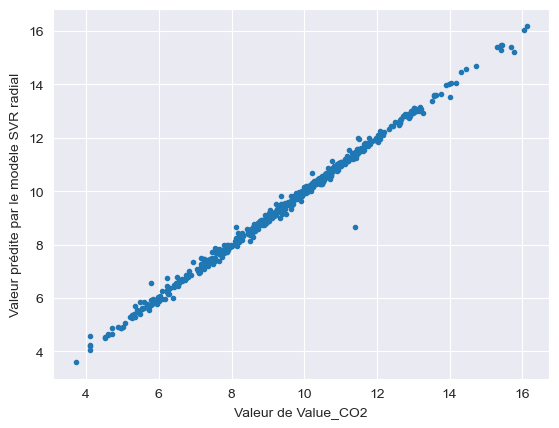

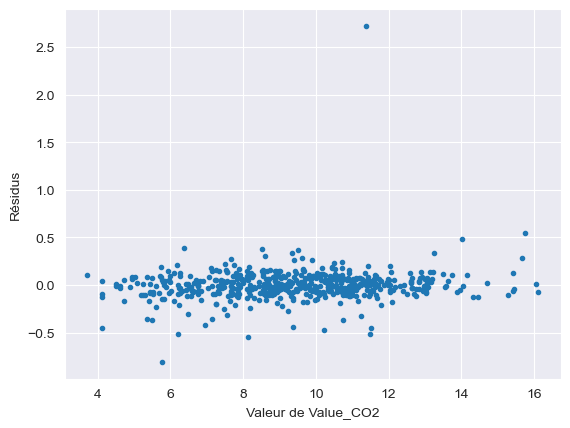

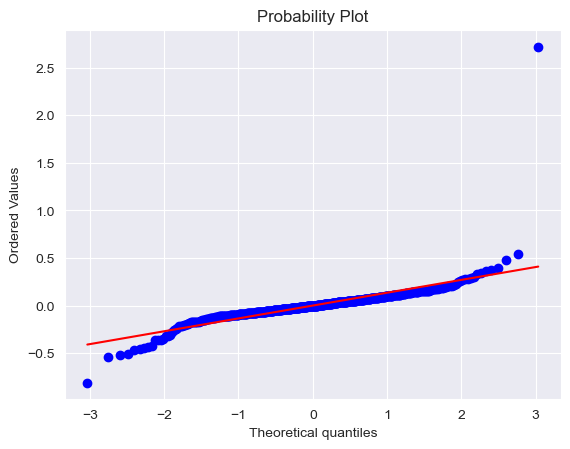

In [ ]:
# SVR radial

# Grille des valeurs du paramètre C à optimiser
param = [{"C": [ 0.5, 1, 1.4,2,5,10,20,22,25]}]

tps0 = time.perf_counter()

svr_radial = GridSearchCV(SVR(kernel = 'rbf'), param, cv = 100, n_jobs = -1)
svr_radial_optimal = svr_radial.fit(X_train, Y_train)
pred = svr_radial_optimal.predict(X_test)

tps1 = (time.perf_counter() - tps0)
temps_list.append(('SVR rad', tps1))

# Paramètre optimal
print("Meilleur score : %f" % (1. - svr_radial_optimal.best_score_))
print("")
print("Meilleur paramètre : %s" % (svr_radial_optimal.best_params_))
print("")

# Erreur de prévision sur le test
print("Erreur de prévision : ", (1 - svr_radial_optimal.score(X_test, Y_test)))
print("")

# Calcul du R²
print("Valeur du R² : ", r2_score(Y_test, pred))
print("")

# Calcul du MSE
MSE = mean_squared_error(pred, Y_test)
print("Valeur du MSE : ", MSE)
print("")
MSE_list.append(('SVR rad', MSE))

# Affichage des prédictions par rapport aux valeurs réelles
plt.plot(Y_test, pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Valeur prédite par le modèle SVR radial")
plt.show()

# Affichage des résidus
plt.plot(Y_test, Y_test - pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Résidus")
plt.show()

stats.probplot(Y_test - pred, dist = "norm", plot = pylab)
pylab.show()
plt.show()

Dans le cadre de la SVR, les paramètres doivent être calibrés par validation croisés et l'hyperparamètre majeur à optimiser est le paramètre C qui correspond au degré de contraintes que l'on impose sur les points. Ici sa valeur optimale vaut 1.4 pour le noyau linéaire et 25 pour le noyau radial. Il est lui aussi calibré par validation croisée à l'intérieur du programme (on pose cv=10 donc validation croisée à 10 plis).
Le choix du type de noyau est clé pour l'application de la SVR à nos données.


Dans le cadre du projet, nous choisissons d'utiliser un noyau radial (dit gaussien) car c'est le noyau qui est en règle général le plus performant de tous, d'autant plus lorsque l'on a un modèle complexe comme le nôtre avec beaucoup de paramètres reliés à la variable CO2 de manière pas toujours linéaire (c'est l'intuition qu'on a à partir de l'analyse descriptive). Le noyau radial fonctionne en effet en transformant les données dans un espace de Hilbert de dimension supérieure, contrairement au noyau linéaire qui cherche directement une relation entre variable d'entrée et de sortie. Dans ce nouvel espace avec de nombreuses dimensions, les relations non linéaires deviennent bien plus linéaires et il est alors possible de faire une prédiction sur les données.


Les performances des deux noyaux nous permettent de déduire que l'utilisation du kernel radial semble performant sur les données de tests, avec un R² de 0.995 et un MSE de 0.03.
En effet, la SVR donne des prédictions légérement meilleures que ceux de la régression linéaire. Cependant, appliquer la SVR reste très long à exécuter et nous perdons en interprétabilité avec la SVR par rapport aux méthodes précédentes.

Nous avons renoncé à utiliser le noyau polynomial de la SVR car il aurait nécessité des temps de calculs trop longs.

# **E- Prédiction par arbre optimal**

Nous appliquons maintenant un algorithme de prédiction par arbre optimal car ce type d'algorithme permet d'obtenir des résultats très interprétables, bien que les modèles obtenus puissent être moins robustes et sujets à l'instabilité et à la dimension que les modèles suivants. Nous appliquons l'algorithme suivant.

Meilleur score = 0.013425

Meilleur paramètre = {'max_depth': 18}

Erreur de prévision :  0.011832836234718647

Valeur du R² :  0.9881671637652814

Valeur du MSE :  0.06291847817640048



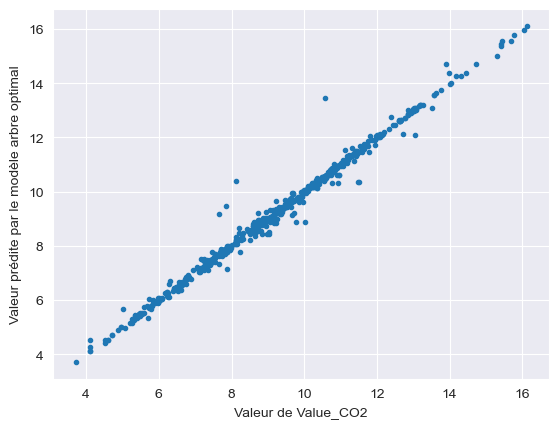

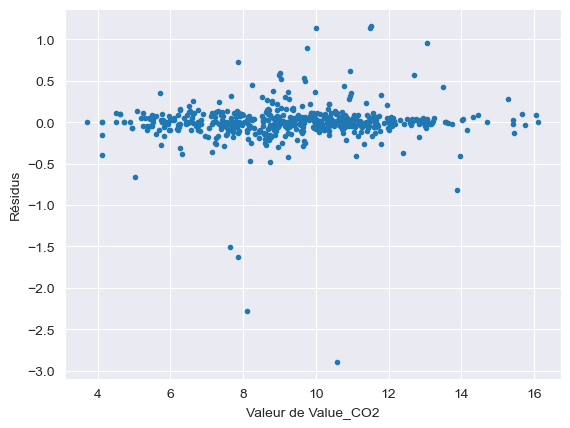

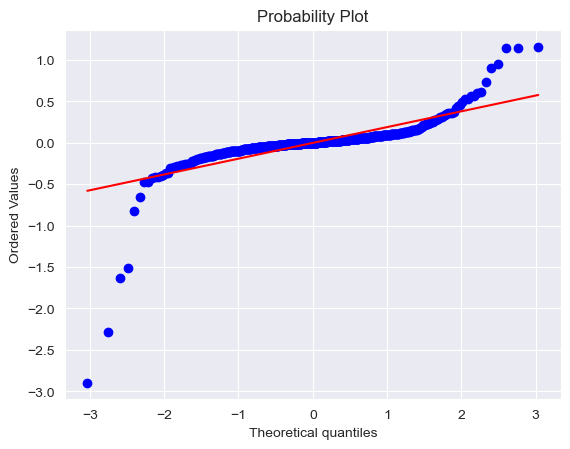

In [ ]:
# Arbre optimal

# Grille des valeurs de la profondeur maximale à optimiser
param = [{"max_depth":list(range(2,20))}]

tps0 = time.perf_counter()

tree = GridSearchCV(DecisionTreeRegressor(), param, cv = 10, n_jobs = -1)
treeOpt = tree.fit(X_train, Y_train)
pred = treeOpt.predict(X_test)

tps1 = (time.perf_counter() - tps0)
temps_list.append(('Arbre', tps1))

# Paramètre optimal
print("Meilleur score = %f" % (1. - treeOpt.best_score_))
print("")
print("Meilleur paramètre = %s" % (treeOpt.best_params_))
print("")

# Erreur de prévision sur le test
print("Erreur de prévision : ", (1 - treeOpt.score(X_test, Y_test)))
print("")

# Calcul du R²
print("Valeur du R² : ", r2_score(Y_test, pred))
print("")

# Calcul du MSE
MSE = mean_squared_error(pred, Y_test)
print("Valeur du MSE : ", MSE)
print("")
MSE_list.append(('Arbre', MSE))

# Affichage des prédictions par rapport aux valeurs réelles
plt.plot(Y_test, pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Valeur prédite par le modèle arbre optimal")
plt.show()

# Affichage des résidus
plt.plot(Y_test, Y_test - pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Résidus")
plt.show()

stats.probplot(Y_test - pred, dist = "norm", plot = pylab)
pylab.show()
plt.show()

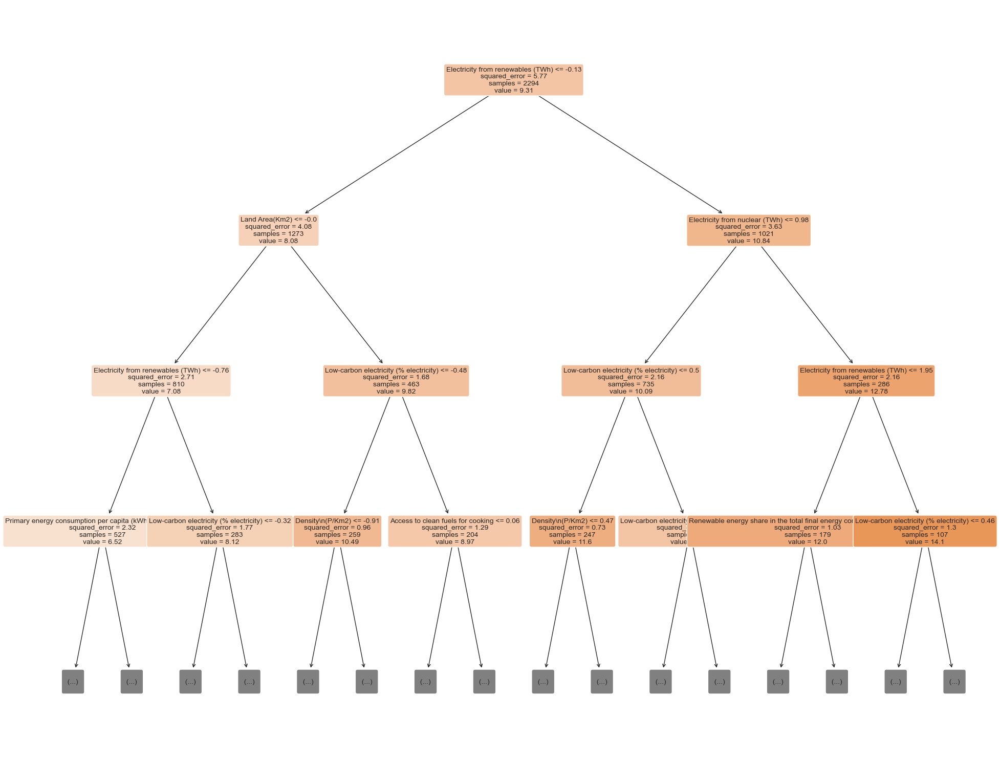

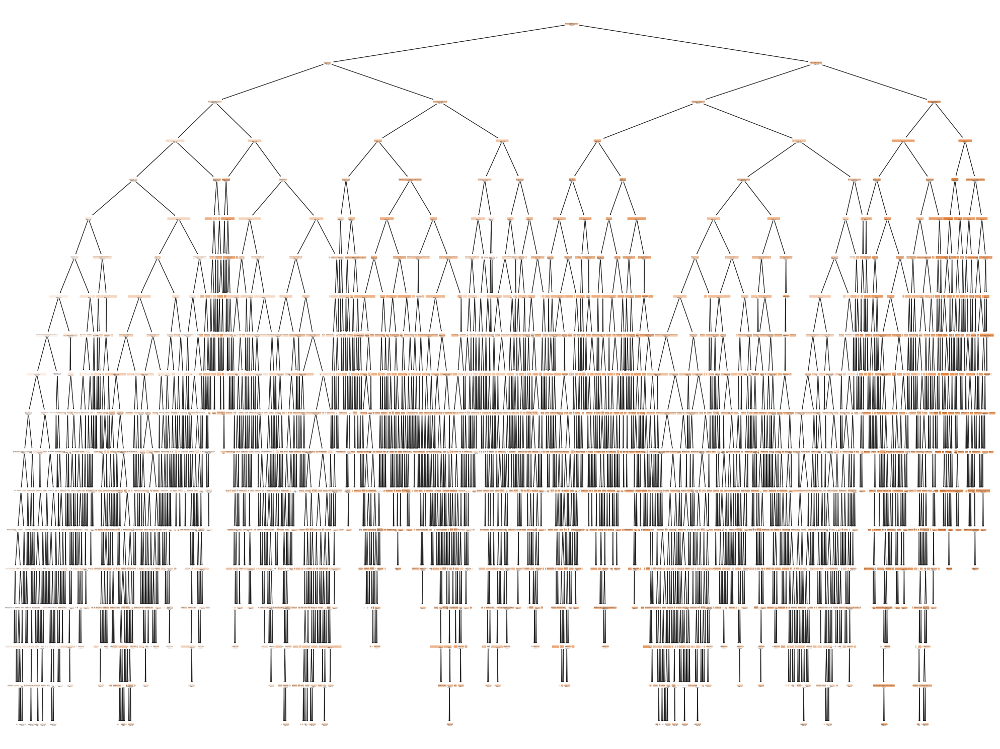

In [ ]:
tree = DecisionTreeRegressor(max_depth = treeOpt.best_params_['max_depth'])
tree.fit(X_train,Y_train)

# Arbre partiel
plt.figure(figsize = (20, 15))
plot_tree(tree,
          feature_names = data_log.columns.tolist(),
          filled = True,
          max_depth = 3,
          fontsize = 10,
          rounded = True,
          precision = 2)
plt.tight_layout()
plt.show()

# Arbre complet
plt.figure(figsize = (20, 15))
plot_tree(tree,
          feature_names = data_log.columns.tolist(),
          filled = True,
          rounded = True,
          precision = 2)
plt.tight_layout()
plt.show()

La prédiction par arbre optimal réalise un arbre de décision en subdivisant l'abre à chaque noeud en minimisant la variance intra-classe des noeuds fils.  

La prédiciton par arbre optimal nous donne une prédiction avec un MSE de 0.06 ce qui est un très bon résultat, meilleur que la regression linéaire. Elle nous permet également de visualiser quelles sont les premiers noeuds et donc les premières décisions de l'algorithme sur l'arbre. Cette information sur la construction des arbres nous permet de déduire que les variables Electricity from renewables et Electricity from nuclear conditionnent aussi beaucoup la valeur de prédiction de la variable CO2. Cela est parfaitement compréhensible puisque dans la partie analyse descriptive, nous avions remarqué que les variables electricity from nuclear et from renewables avaient de très grosses disparités de valeurs, et que selon le niveau de développement beaucoup de pays avaient des valeurs très faibles. Et les pays qui avaient les plus grosses valeurs étaient des pays très industrialisés et développés comme par exemple les 5 principaux pays émetteurs de CO2.

Un enjeu important dans la prédiction par arbre optimal est de trouver un compromis optimal sur la taille des arbres. Il faut éviter l'overfitting et éviter que les feuilles regroupent trop peu de données.
C'est pourquoi le principal paramètre à optimiser pour une prédiction par arbre optimal est la profondeur des arbres, que l'on détermine par validation croisée durant une étape d'élagage. On choisit l'arbre associé à la valeur optimale de pénalisation qui minimise l'erreur de généralisation. Ici la profondeur idéale des arbres vaut 18 par validation croisée, ce qui signifie que

# **F- Prédiction par forêt aléatoire**

L'algorithme du Random Forest est connu pour ses très bonnes performances en prédiction par agrégation d'arbres. Nous vérifierons donc si ses performances pour modéliser la variable CO2 sont si bonnes que cela.

Erreur Out of bag 0.003542593010447681

Erreur de prévision :  0.0004788868451742756

Valeur du R² :  0.9949718554525937

Valeur du MSE :  0.026736041697723204

Importance des variables : 
Electricity from renewables (TWh): 0.3404
Electricity from nuclear (TWh): 0.1771
Latitude: 0.1723
Low-carbon electricity (% electricity): 0.0986
Land Area(Km2): 0.0689
Renewable energy share in the total final energy consumption (%): 0.0407
Primary energy consumption per capita (kWh/person): 0.0403
Density\n(P/Km2): 0.0193
Access to electricity (% of population): 0.0118
Longitude: 0.0093
Energy intensity level of primary energy (MJ/$2017 PPP GDP): 0.0091
gdp_per_capita: 0.0066
Access to clean fuels for cooking: 0.0046
gdp_growth: 0.0010


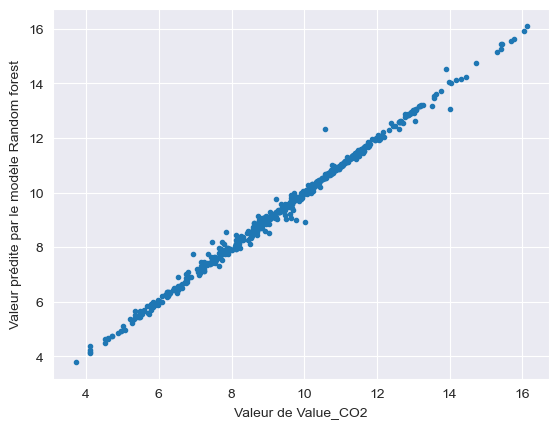

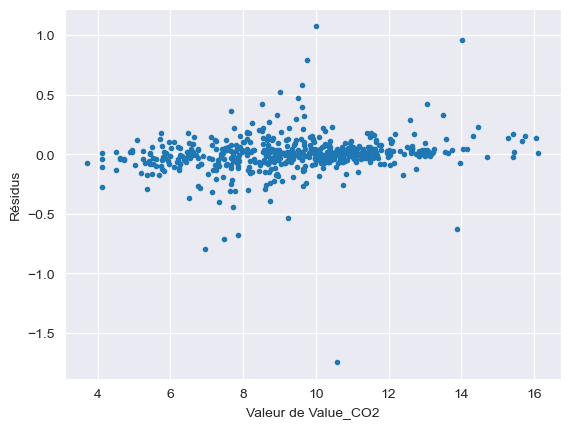

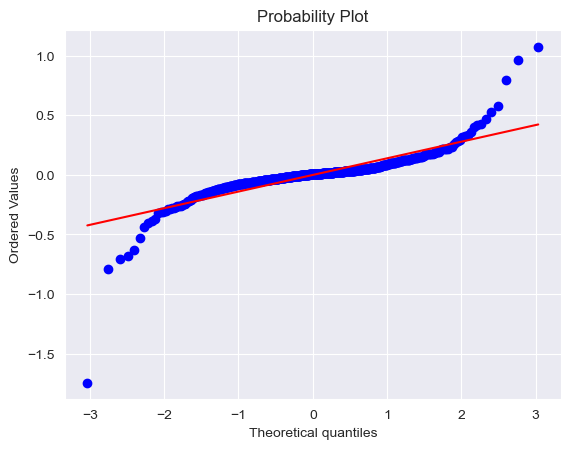

In [ ]:
# Random forest

tps0 = time.perf_counter()

rf_reg = RandomForestRegressor(n_estimators = 500,
                               max_depth = None,
                               min_samples_split = 2,
                               min_samples_leaf = 1,
                               max_leaf_nodes = None,
                               bootstrap = True,
                               oob_score = True)
rf_fit = rf_reg.fit(X_train, Y_train)
pred = rf_fit.predict(X_test)

tps1 = (time.perf_counter() - tps0)
temps_list.append(('RF', tps1))

# Calcul de l'erreur out of bag
print("Erreur Out of bag", 1 - rf_fit.oob_score_)
print("")

# Erreur de prévision sur le test
print("Erreur de prévision : ", (1 - rf_fit.score(X_train, Y_train)))
print("")

# Calcul du R²
print("Valeur du R² : ", r2_score(Y_test, pred))
print("")

# Calcul du MSE
MSE = mean_squared_error(pred, Y_test)
print("Valeur du MSE : ", MSE)
print("")
MSE_list.append(('RF', MSE))

# Importance des variables
importances = rf_fit.feature_importances_
indices = np.argsort(importances)[::-1]
print("Importance des variables : ")
for f in range(X_train.shape[1]):
    print(f"{X_train.columns[indices[f]]}: {importances[indices[f]]:.4f}")

# Affichage des prédictions par rapport aux valeurs réelles
plt.plot(Y_test, pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Valeur prédite par le modèle Random forest")
plt.show()

# Affichage des résidus
plt.plot(Y_test, Y_test - pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Résidus")
plt.show()

stats.probplot(Y_test - pred, dist = "norm", plot = pylab)
pylab.show()
plt.show()

Meilleur score = 0.003451

Meilleur paramètre = {'max_features': 8}

Erreur de prévision :  0.0033202607647188076

Valeur du R² :  0.9966797392352812

Valeur du MSE :  0.017654749066159357



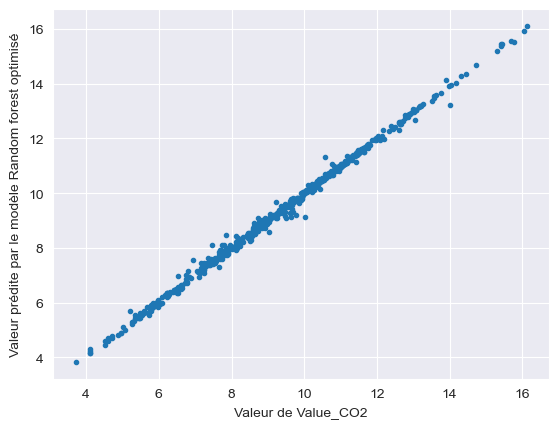

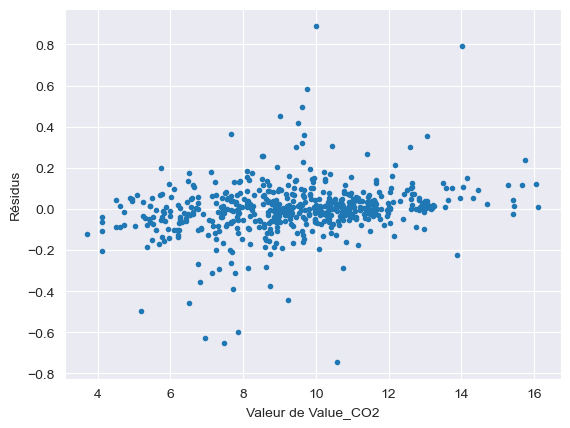

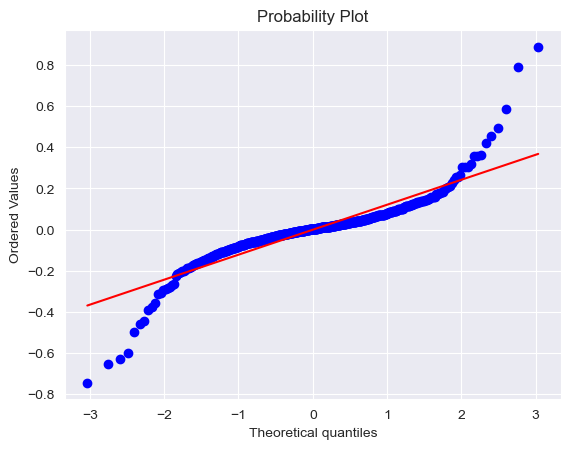

In [ ]:
# Random forest avec optimisation

# Grille des valeurs de max_features à optimiser
param = [{"max_features":list(range(2,10,1))}]

tps0 = time.perf_counter()

rf_param_opt = GridSearchCV(RandomForestRegressor(n_estimators = 100), param, cv = 10, n_jobs = -1)
rfOpt = rf_param_opt.fit(X_train, Y_train)
pred = rfOpt.predict(X_test)

tps1 = (time.perf_counter() - tps0)
temps_list.append(('RF opt', tps1))

# Paramètre optimal
print("Meilleur score = %f" % (1. - rfOpt.best_score_))
print("")
print("Meilleur paramètre = %s" % (rfOpt.best_params_))
print("")

# Erreur de prévision sur le test
print("Erreur de prévision : ", (1 - rfOpt.score(X_test, Y_test)))
print("")

# Calcul du R²
print("Valeur du R² : ", r2_score(Y_test, pred))
print("")

# Calcul du MSE
MSE = mean_squared_error(pred, Y_test)
print("Valeur du MSE : ", MSE)
print("")
MSE_list.append(('RF opt', MSE))

# Affichage des prédictions par rapport aux valeurs réelles
plt.plot(Y_test, pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Valeur prédite par le modèle Random forest optimisé")
plt.show()

# Affichage des résidus
plt.plot(Y_test, Y_test - pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Résidus")
plt.show()

stats.probplot(Y_test - pred, dist = "norm", plot = pylab)
pylab.show()
plt.show()

Nous obtenons le meilleur R² toutes méthodes confondues. Le Random forest est le modèle qui minimise le plus l'erreur. Nous obtenons un MSE de 0.004 sur les données de test.

Dans le cadre du Random Forest, le paramètre le plus important à configurer est le nombre de variables choisies aléatoirement à chaque noeud. C'est le paramètre max_features ci-dessus qui est donc optimal pour 4 paramètres. Cela correspond donc au nombre maximal de caractéristiques à considérer lors de la recherche de la meilleur décision pour un noeud, estimé par validation croisée. Sa valeur égale à 4 est finalement proche de la valeur qui est généralement attribuée par défaut pour un problème de régression qui aurait valu ici nb de paramètres/3=14/3~4

Le nombre d'arbre de la forêt, la profondeur maximale des arbres ou encore le coefficient de rétrecissement pour le contrôle du pas de l'algorithme sont également des paramètres qu'il peut être utile de configurer et moduler.

L'indice d'importance des variables permet de visualiser davantage l'intérêt de chaque variable dans la prédiction. Il renvoie que les variables Electricity from renewables, Electricity from nuclear, Land Area et Latitude ont une importance particulière dans la prédiction par Random_Forest.

# **G- Boosting**

Meilleur score = 0.005541

Meilleur paramètre = {'n_estimators': 500}

Erreur de prévision :  0.005225680436463542

Valeur du R² :  0.9947743195635365

Valeur du MSE :  0.027786394907906298



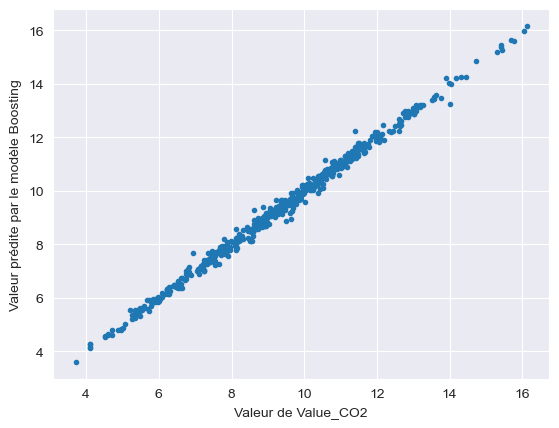

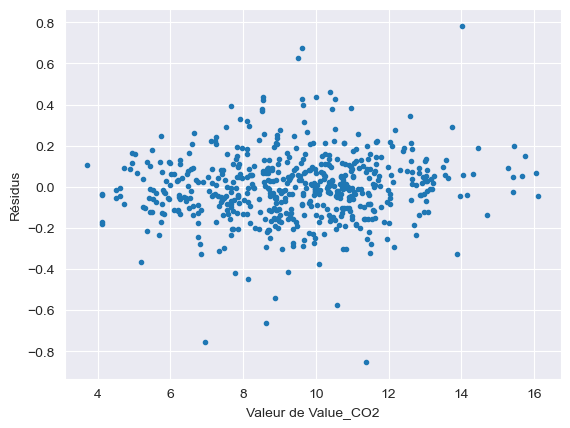

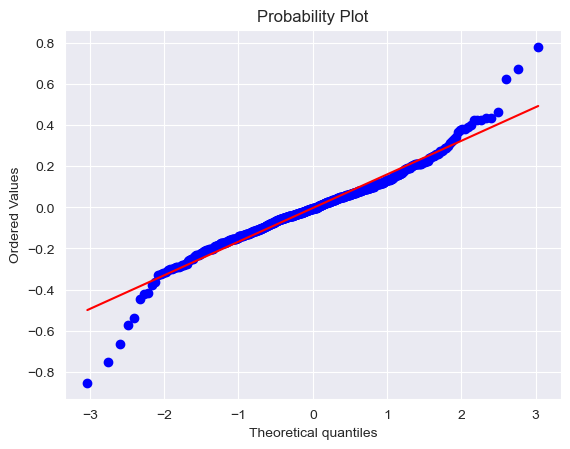

In [ ]:
# Boosting

# Grille des valeurs de n_estimators à optimiser
param = [{"n_estimators":[200, 250, 300, 400, 500]}]

tps0 = time.perf_counter()

gbm = GridSearchCV(GradientBoostingRegressor(), param, cv = 10)
gbmOpt = gbm.fit(X_train, Y_train)
pred = gbmOpt.predict(X_test)

tps1 = (time.perf_counter() - tps0)
temps_list.append(('Boosting', tps1))

# Paramètre optimal
print("Meilleur score = %f" % (1. - gbmOpt.best_score_))
print("")
print("Meilleur paramètre = %s" % (gbmOpt.best_params_))
print("")

# Erreur de prévision sur le test
print("Erreur de prévision : ", (1 - gbmOpt.score(X_test, Y_test)))
print("")

# Calcul du R²
print("Valeur du R² : ", r2_score(Y_test, pred))
print("")

# Calcul du MSE
MSE = mean_squared_error(pred, Y_test)
print("Valeur du MSE : ", MSE)
print("")
MSE_list.append(('Boosting', MSE))

# Affichage des prédictions par rapport aux valeurs réelles
plt.plot(Y_test, pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Valeur prédite par le modèle Boosting")
plt.show()

# Affichage des résidus
plt.plot(Y_test, Y_test - pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Résidus")
plt.show()

stats.probplot(Y_test - pred, dist = "norm", plot = pylab)
pylab.show()
plt.show()

L'algorithme du Boosting un algorithme qui minimise la variance et le biais par agrégation de prédicteurs. A chaque itération chaque modèle est une version adaptative du précédent qui donne plus de poids aux observations précédemment mal prédites pour corriger la prédiction. On applique plus précisement ici l'algorithme de gradient boostring, qui calcule le gradient à chaque étape pour déterminer

Avec l'algorithme de Gradient Boosting, on retrouve un meilleur score MSE et une plus faible erreur des moindres carrés que sur les méthodes précédentes excepté le Random_forest qui renvoie des résultats similaires. Le paramètre à optimiser pour le boosting est le nombre d'estimateurs, ici d'arbres, que l'on utilise, qui est optimal lorsque ce nombre vaut 300 ici. Ce paramètre est déterminé par validation croisée. On peut également paramétrer le taux d'apprentissage, le choix de la fonction perte, ou encore la profondeur maximale de chaque arbre de décision.

In [ ]:
%%capture
# Boosting avec optimisation

# Grille des valeurs des paramètres à optimiser
learning_rates = [0.001, 0.01, 0.1]
loss_functions = ['squared error' 'huber', 'quantile']
max_depths = [3, 4, 5, 6]
param = [{"learning_rate": learning_rates,
          "loss": loss_functions,
          "max_depth": max_depths,
          "n_estimators": [300]}]

tps0 = time.perf_counter()

gbm = GridSearchCV(GradientBoostingRegressor(), param, cv = 10)
gbmOpt = gbm.fit(X_train, Y_train)
pred = gbmOpt.predict(X_test)

tps1 = (time.perf_counter() - tps0)
temps_list.append(('Boosting opt', tps1))

Meilleur score = 0.039786

Meilleur paramètre = {'learning_rate': 0.1, 'loss': 'quantile', 'max_depth': 6, 'n_estimators': 300}

Erreur de prévision :  0.031904924117363676

Valeur du R² :  0.9680950758826363

Valeur du MSE :  0.16964734675429072



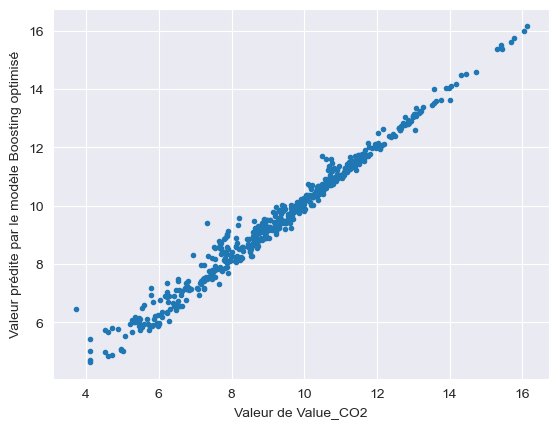

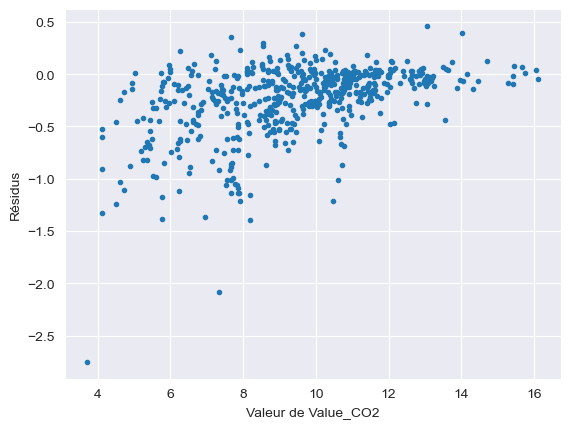

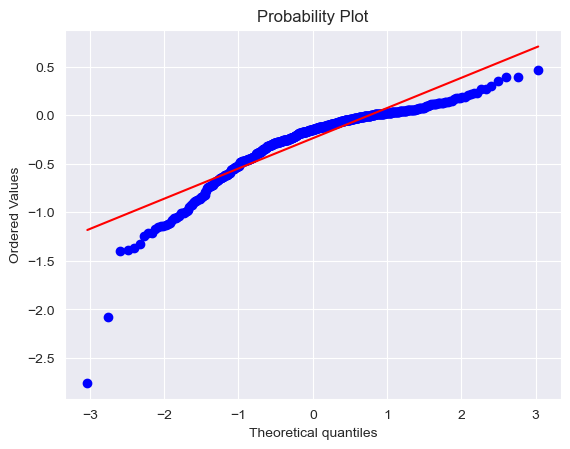

In [ ]:
# Paramètre optimal
print("Meilleur score = %f" % (1. - gbmOpt.best_score_))
print("")
print("Meilleur paramètre = %s" % (gbmOpt.best_params_))
print("")

# Erreur de prévision sur le test
print("Erreur de prévision : ", (1 - gbmOpt.score(X_test, Y_test)))
print("")

# Calcul du R²
print("Valeur du R² : ", r2_score(Y_test, pred))
print("")

# Calcul du MSE
MSE = mean_squared_error(pred, Y_test)
print("Valeur du MSE : ", MSE)
print("")
MSE_list.append(('Boosting opt', MSE))

# Affichage des prédictions par rapport aux valeurs réelles
plt.plot(Y_test, pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Valeur prédite par le modèle Boosting optimisé")
plt.show()

# Affichage des résidus
plt.plot(Y_test, Y_test - pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Résidus")
plt.show()

stats.probplot(Y_test - pred, dist = "norm", plot = pylab)
pylab.show()
plt.show()

Nous obtenons en optimisant les paramètres la combinaison suivante:
Meilleur paramètre = {'learning_rate': 0.1, 'loss': 'huber', 'max_depth': 6, 'n_estimators': 300}

Erreur de prévision sur le test = 0.004357404916859209

Score R2 associé à la prédiction gradient boosting : 0.9956425950831408

MSE = 0.02316953270786689.

Appliquons maintenant l'algorithme XGBoost pour comparer ses performances avec notre version optimisée du Gradient Boosting.

In [ ]:
%%capture
# XGBoost avec optimisation

# Grille des valeurs des paramètres à optimiser
learning_rates = [0.001, 0.01, 0.1]
loss_functions = ['reg:squarederror', 'reg:huber', 'reg:quantile']
max_depths = [3, 4, 5, 6]
param = [{"learning_rate": learning_rates,
          "objective": loss_functions,
          "max_depth": max_depths,
          "n_estimators": [200,300,400,500]}]

tps0 = time.perf_counter()

xgb_gbm = GridSearchCV(xgb.XGBRegressor(), param, cv = 10)
xgb_opt = xgb_gbm.fit(X_train, Y_train)
pred = xgb_opt.predict(X_test)

tps1 = (time.perf_counter() - tps0)
temps_list.append(('XGBoost', tps1))

Meilleur score = 0.004858

Meilleur paramètre = {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 500, 'objective': 'reg:squarederror'}

Erreur de prévision :  0.004330341516497582

Valeur du R² :  0.9956696584835024

Valeur du MSE :  0.023025629088205598



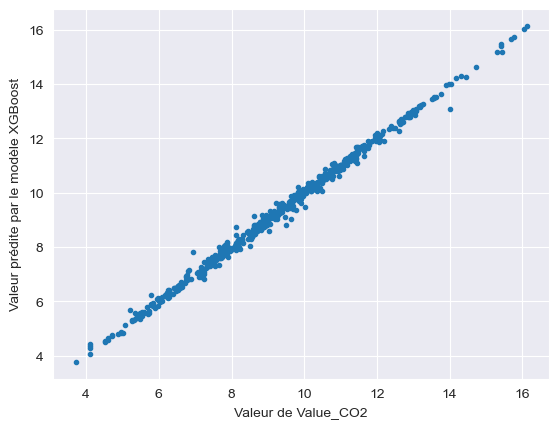

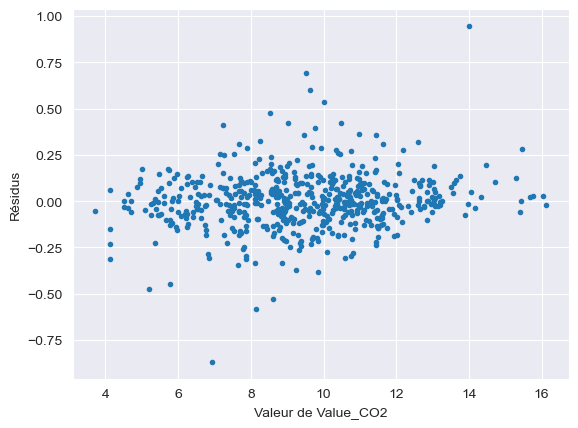

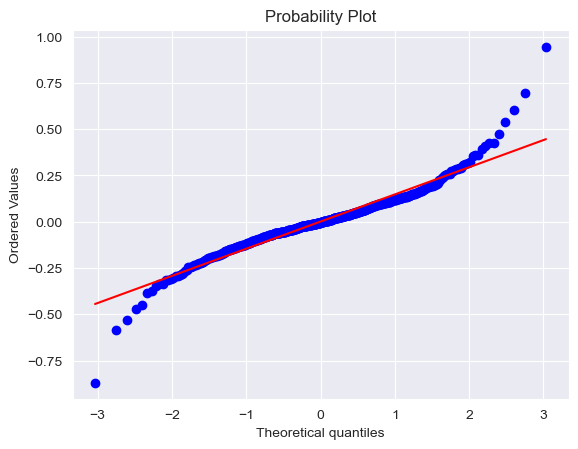

In [ ]:
# Paramètre optimal
print("Meilleur score = %f" % (1. - xgb_opt.best_score_))
print("")
print("Meilleur paramètre = %s" % (xgb_opt.best_params_))
print("")

# Erreur de prévision sur le test
print("Erreur de prévision : ", (1 - xgb_opt.score(X_test, Y_test)))
print("")

# Calcul du R²
print("Valeur du R² : ", r2_score(Y_test, pred))
print("")

# Calcul du MSE
MSE = mean_squared_error(pred, Y_test)
print("Valeur du MSE : ", MSE)
print("")
MSE_list.append(('XGBoost', MSE))

# Affichage des prédictions par rapport aux valeurs réelles
plt.plot(Y_test, pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Valeur prédite par le modèle XGBoost")
plt.show()

# Affichage des résidus
plt.plot(Y_test, Y_test - pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Résidus")
plt.show()

stats.probplot(Y_test - pred, dist = "norm", plot = pylab)
pylab.show()
plt.show()

On obtient les résultats suivants avec l'algorithme XGBoost pour la grille de parametres suivante :
Paramètres : learning_rates = [0.001, 0.01, 0.1]
loss_functions = ['reg:squarederror', 'reg:huber', 'reg:quantile']
max_depths = [3, 4, 5, 6], nb_params=[200,300,400,500]


Temps XGBoosting = 463.68228587500016

Meilleur score = 0.004858082823066212

Meilleur paramètre = {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 500, 'objective': 'reg:squarederror'}

Erreur de prévision sur le test = 0.004330341516497582

Score R2 associé à la prédiction XGBoost : 0.9956696584835024

MSE = 0.023025629088205598

Les résultats obtenus sont très légerement meilleurs à ceux obtenus avec le gradient boosting optimisé. Nous étudierons donc plutôt dans notre comparaison avec les autres méthodes les résultats de XGBoost.

# **H- Modélisation par réseaux de neurones**

Meilleur score = 0.010561

Meilleur paramètre = {'hidden_layer_sizes': (12,)}

Erreur de prévision :  0.009501688558614774

Valeur du R² :  0.9904983114413852

Valeur du MSE :  0.05052311824109074



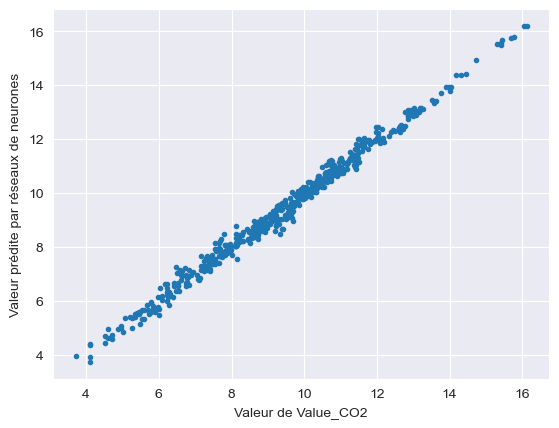

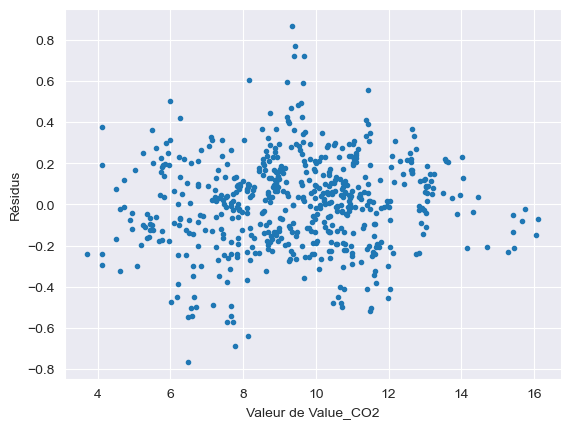

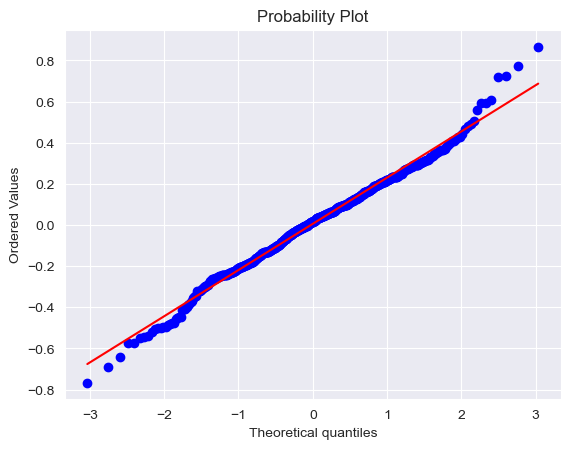

In [ ]:
# Réseaux de neurones

# Grille des valeurs de la taille des sous-couches à optimiser
param = [{"hidden_layer_sizes": list([(5,), (6,), (7,), (8,), (9,), (10,), (12,)])}]

tps0=time.perf_counter()

nnet = GridSearchCV(MLPRegressor(max_iter = 10000), param, cv = 10, n_jobs = -1)
nnetOpt = nnet.fit(X_train, Y_train)
pred = nnetOpt.predict(X_test)

tps1 = (time.perf_counter() - tps0)
temps_list.append(('NN', tps1))

# Paramètre optimal
print("Meilleur score = %f" % (1. - nnetOpt.best_score_))
print("")
print("Meilleur paramètre = %s" % (nnetOpt.best_params_))
print("")

# Erreur de prévision sur le test
print("Erreur de prévision : ", (1 - nnetOpt.score(X_test, Y_test)))
print("")

# Calcul du R²
print("Valeur du R² : ", r2_score(Y_test, pred))
print("")

# Calcul du MSE
MSE = mean_squared_error(pred, Y_test)
print("Valeur du MSE : ", MSE)
print("")
MSE_list.append(('NN', MSE))

# Affichage des prédictions par rapport aux valeurs réelles
plt.plot(Y_test, pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Valeur prédite par réseaux de neurones")
plt.show()

# Affichage des résidus
plt.plot(Y_test, Y_test - pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Résidus")
plt.show()

stats.probplot(Y_test - pred, dist = "norm", plot = pylab)
pylab.show()
plt.show()

Nous appliquons enfin comme dernier modèle un modèle de réseaux de neurones dont nous optimisons le nombre de couches cachées (perceptrons) par validation croisée.

On retrouve un score d'environ 0.99 ce qui est un bon score pour notre réseau de neurones. Dans le cadre des réseaux de neurones, les paramètres essentiels sont : la taille des batchs, c'est-à-dire la taille du sous ensemble des données que l'on prend aléatoirement pour calculer le gradient et la fonction perte, le nombre de couches (l'architectude notre réseau), le pas d'apprentissage et le paramètre 'decay' qui correspond à la vitesse à laquelle on fait diminuer le poids des gradients précédents. A chaque itération, l'algorithme calcule le gradient et la fonction perte sur les batchs et en fait la synthèse, puis les poids sont reconfigurés à partir des équations de backpropagation du gradient afin d'obtenir la meilleure sortie possible compte tenue des données en entrée.

Nous avons essayé d'optimiser pour 3 à 4 valeurs de taille de batchs, de nombre de couches, de pas d'apprentissage et de valeur de decay. Nous obtenons que la valeur optimale de taille du batch vaut 32 pour 12 couches cachées, un pas d'apprentissage initialisé à 0.001 et une dégradation des pondérations valant 1e-06. Nous obtenons un MSE de 0.00884.

Meilleur score = 0.010748

Meilleur paramètre = {'hidden_layer_sizes': (12,)}

Erreur de prévision :  0.0095221672687118

Valeur du R² :  0.9904778327312882

Valeur du MSE :  0.05063200923296832



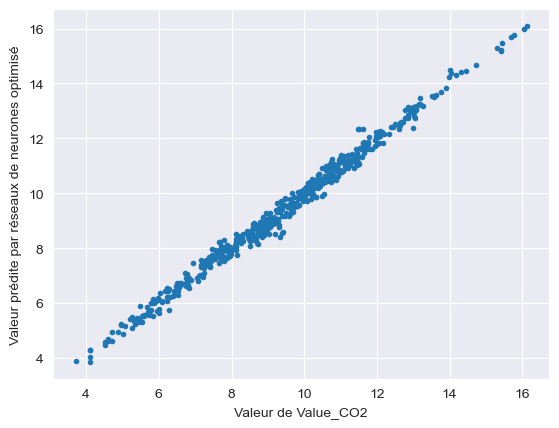

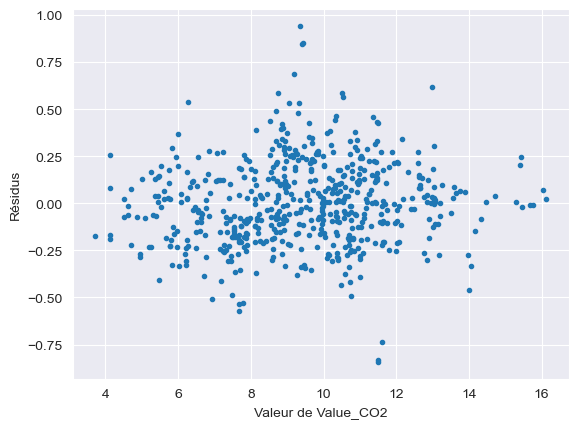

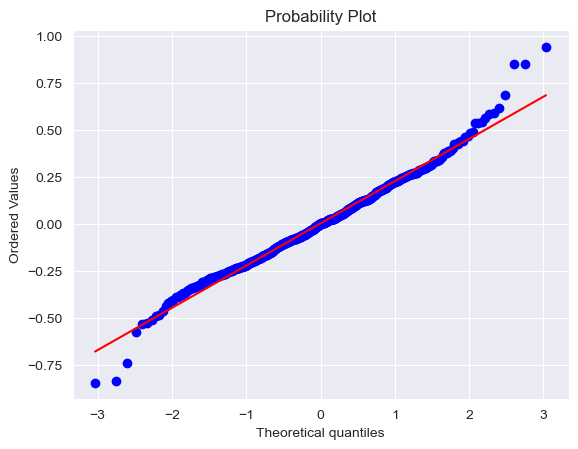

In [ ]:
# Réseaux de neurones avec optimisation

# Grille des valeurs des paramètres à optimiser
batch_sizes = [32, 64, 128]
learning_rates = [0.001, 0.01, 0.1]
decays = [1e-6, 1e-5, 1e-4]
hidden_layer_sizes = [(8,),(10,),(12,)]
param_grid = [{"batch_size": batch_sizes,
               "learning_rate_init": learning_rates,
               "alpha": decays,
               "hidden_layer_sizes": hidden_layer_sizes}]

tps0=time.perf_counter()

nnet = GridSearchCV(MLPRegressor(max_iter = 10000), param, cv = 10, n_jobs = -1)
nnetOpt = nnet.fit(X_train, Y_train)
pred = nnetOpt.predict(X_test)

tps1 = (time.perf_counter() - tps0)
temps_list.append(('NN opt', tps1))

# Paramètre optimal
print("Meilleur score = %f" % (1. - nnetOpt.best_score_))
print("")
print("Meilleur paramètre = %s" % (nnetOpt.best_params_))
print("")

# Erreur de prévision sur le test
print("Erreur de prévision : ", (1 - nnetOpt.score(X_test, Y_test)))
print("")

# Calcul du R²
print("Valeur du R² : ", r2_score(Y_test, pred))
print("")

# Calcul du MSE
MSE = mean_squared_error(pred, Y_test)
print("Valeur du MSE : ", MSE)
print("")
MSE_list.append(('NN opt', MSE))

# Affichage des prédictions par rapport aux valeurs réelles
plt.plot(Y_test, pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Valeur prédite par réseaux de neurones optimisé")
plt.show()

# Affichage des résidus
plt.plot(Y_test, Y_test - pred, '.')
plt.xlabel("Valeur de Value_CO2")
plt.ylabel("Résidus")
plt.show()

stats.probplot(Y_test - pred, dist = "norm", plot = pylab)
pylab.show()
plt.show()

# **3- Comparaison des performances des modèles sur l'échantillon test**

Afin de comparer les performances des différents modèles sur l'échantillon test, nous allons tracer les comparaisons entre les différents R² et les erreurs quadratiques des modèles sur notre variable à prédire.

Il serait également possible de détemriner un seuil sur la variable quantitative du CO2 et déterminer les courbes ROC correspondant à chacun des algorithmes.

In [ ]:
%%capture
listMethod = [["Reglin", reglin],
              ["Lasso", regLassOpt],
              ["SVR lin", svr_linear_optimal],
              ["SVR rad", svr_radial_optimal],
              ["Tree opt", tree],
              ["RF", rfOpt],
              ["Grad Boosting", gbmOpt],
              ["XGBoost", xgb_opt],
              ["NN", nnetOpt]]

median_co2 = np.median(data_log['Value_co2_emissions_kt_by_country'])

for method in enumerate(listMethod):
    probas = method[1][1].fit(X_train, Y_train).predict(X_test)
    y_test_binary = (Y_test > median_co2).astype(int)
    y_pred_binary = (probas > median_co2).astype(int)
    fpr, tpr, thresholds = roc_curve(y_test_binary, probas)
    plt.plot(fpr, tpr, lw = 1, label = method[1][0])

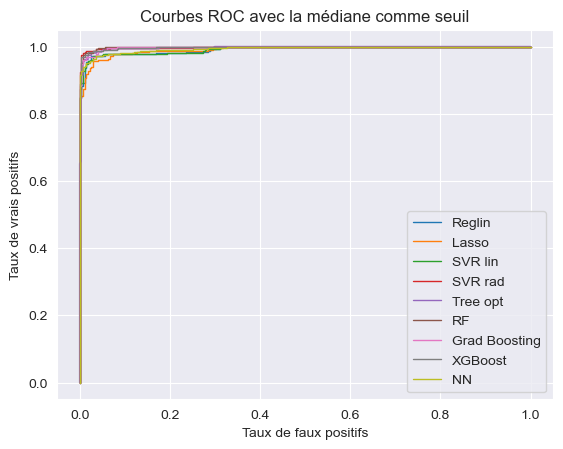

In [ ]:
plt.xlabel('Taux de faux positifs')
plt.ylabel('Taux de vrais positifs')
plt.title("Courbes ROC avec la médiane comme seuil")
plt.legend(loc = "best")
plt.show()

In [ ]:
%%capture
listMethod = [["Reglin", reglin],
              ["Lasso", regLassOpt],
              ["SVR lin", svr_linear_optimal],
              ["SVR rad", svr_radial_optimal],
              ["Tree opt", tree],
              ["RF", rfOpt],
              ["Grad Boosting", gbmOpt],
              ["XGBoost", xgb_opt],
              ["NN", nnetOpt]]

mean_co2 = np.mean(data_log['Value_co2_emissions_kt_by_country'])

for method in enumerate(listMethod):
    probas = method[1][1].fit(X_train, Y_train).predict(X_test)
    y_test_binary = (Y_test > mean_co2).astype(int)
    y_pred_binary = (probas > mean_co2).astype(int)
    fpr, tpr, thresholds = roc_curve(y_test_binary, probas)
    plt.plot(fpr, tpr, lw = 1, label = method[1][0])

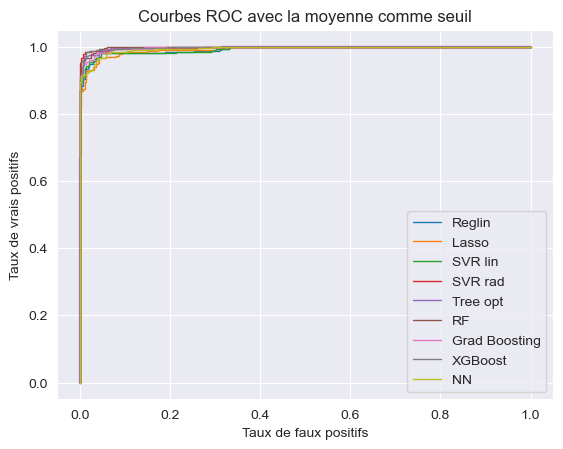

In [ ]:
plt.xlabel('Taux de faux positifs')
plt.ylabel('Taux de vrais positifs')
plt.title("Courbes ROC avec la moyenne comme seuil")
plt.legend(loc="best")
plt.show()

Ces graphes traduisent la meilleur efficacité des algorithmes de Random_forest,boosting et de reseaux de neurones. Les performances des algorithmes de regression linéaire sont très proches les unes des autres donc la sélection de variable n'a pas eu trop d'impact dans la précision des prédictions. Pour confirmer ces résultats, traçons à présent le graphe comparatif des MSE des différentes méthodes et le graphe comparatif des temps de calcul.

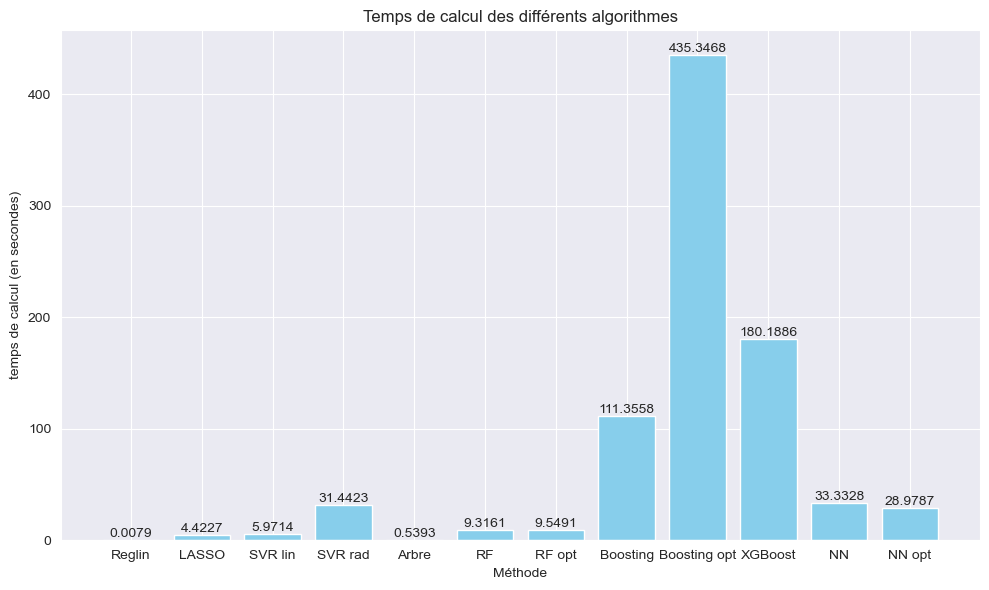

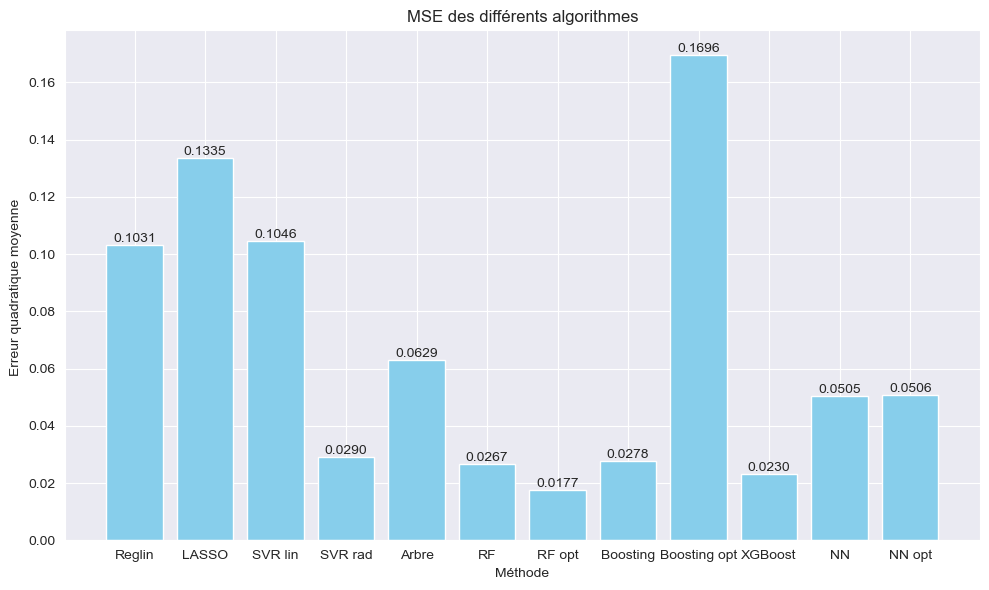

In [ ]:
# Graphe comparatif des temps de calcul et des MSE
def plot_performances(perf_info, y_label, titre):
    methods, values = zip(*perf_info)
    plt.figure(figsize = (10, 6))
    bars = plt.bar(methods, values, color = 'skyblue')
    plt.ylabel(y_label)
    plt.xlabel('Méthode')
    plt.title(titre)
    for bar, value in zip(bars, values):
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height(), f'{value:.4f}', ha = 'center', va = 'bottom')
    plt.tight_layout()
    plt.show()

plot_performances(temps_list, 'temps de calcul (en secondes)', 'Temps de calcul des différents algorithmes')
plot_performances(MSE_list, 'Erreur quadratique moyenne ', 'MSE des différents algorithmes')

Il est effectivement clair que la SVR, le Random forest et le boosting sont les trois méthodes les plus efficaces pour la prédiction du CO2 avec nos variables explicatives du jeu de données Kaggle. Cependant le boosting et la SVR sont de loin les méthodes les plus longues à exécuter pour la prédiction donc un compromis devra être trouvé selon le besoin entre les performances de nos modèles et le temps de calcul. Le compromis idéal semble être le random forest qui a un temps d'exécution relativement court comparativement à ses bonnes performances.

# **4- Interprétation et confirmation des observations de l'analyse exploratoire**

Nous obtenons donc à l'aide des différentes méthodes de modélisation des résultats qui confirment ceux obtenus lors de l'analyse exploratoire.

Les variables liées à la Longitude où aux énergies low carbon sont redondantes par rapport aux informations données par les autres variables explicatives de notre jeu de données. Nous avons déterminé notamment grâce aux arbres de décision que les variables Energy_from renewables et Energy_from nuclear étaient des variables clés dans la prédiction de la variable CO2 car de fortes valeurs pour ces deux variables sont associées à de fortes émissions de CO2 et le contraire est aussi vrai. Nous avons dégagé l'importance des variables Land Area et Density dans le cadre des modèles linéaires : il semble que les émissions de CO2 soient fortement liées à la taille du pays et la densité de sa population ce qui est aussi très cohérent avec la réalité démographique et les besoins de consommation des populations.

Nous avons appris à travers ces différents algorithmes à manipuler des modèles linéaires et non linéaires. La meilleure précision sur les prédictions a été optenue en optimisant le modèle du Random_forest, et la moins bonne avec l'arbre de décision. Nous remarquons que nous obtenons les meilleurs résultats à l'aide d'algorithmes d'agrégations comme le Boosting ou Random_forest, ou des algorithmes opaques comme les réseaux de neurones.
Cependant, bien qu'obtenant plus de 99% de précision sur ces trois algorithmes, ils sont difficilement interprétables. Nos modèles de régression linéaires avec et sans sélection de variables, ou d'arbre de décision, sont davantage interprétables. Ils nous ont permis de déduire davantage d'informations concrètes sur les variables et obtiennent des résultats satisifaisants, de l'ordre de 98% de précision. La sélection de variables nous a aidé à deduire que certaines variables comme la variable Longitude, ou la variable Low carbon energy ont un apport limité voire négligeable dans la prédiction de la variable CO2.

Cependant, nos résultats ont été obtenues sur un jeu de données tronqué puisqu'il disposait de nombreuses valeurs manquantes. Nous aurions déjà pu appliquer l'algorithme d'arbre de décision et de Boosting (gradient Boosting ou XGBoost) sur les données avec valeurs manquantes puisque ces algorithmes y sont tolérants.

Mais nous allons plutôt concentrer notre étude sur la détermination d'algorithmes d'imputation de valeursm manquantes sur nos modèles les plus performants tels que le Random_forest.
Nous allons donc à présent appliquer un algorithme de complétion aux valeurs manqantes à l'aide des librairies suivantes.

# **5- Application d'un algorithme de complétions aux valeurs manquantes sur les modèles les plus performants**

## Imputation moyenne

## Imputation simple des valeurs manquantes

In [ ]:
data3NA = dataNA.iloc[:,2:].copy()

data3NA=data3NA.drop('Electricity from fossil fuels (TWh)', axis=1)

data3NA_imputed = SimpleImputer().fit_transform(data3NA)
data3NA_imputed=pd.DataFrame(data3NA_imputed, columns=data3NA.columns)

# Appliquer la transformation logarithmique uniquement sur les colonnes quantitatives
log_columns = [
    'Electricity from nuclear (TWh)',
    'Electricity from renewables (TWh)',
    'Value_co2_emissions_kt_by_country',
    'Low-carbon electricity (% electricity)',
    'Primary energy consumption per capita (kWh/person)',
    'Energy intensity level of primary energy (MJ/$2017 PPP GDP)',
    'gdp_per_capita',
    'Land Area(Km2)',
    r'Density\n(P/Km2)'
]

for col in log_columns:
    data3NA_imputed[col] = np.log(data3NA_imputed[col] + 1)

# Séparer les données en ensembles d'entraînement et de test
X = data3NA_imputed.drop(columns=['Value_co2_emissions_kt_by_country'])
y = data3NA_imputed['Value_co2_emissions_kt_by_country']

XnaImp_train,XnaImp_test,Yb_train,Yb_test = train_test_split(X, y, test_size=0.2, random_state=11)

scaler = StandardScaler()
scaler.fit(X_train)
Xr_train = scaler.transform(XnaImp_train)
# Meme transformation sur le test
Xr_test = scaler.transform(XnaImp_test)

# Créer de nouveaux DataFrames avec les données transformées et les mêmes noms de colonnes que l'original
Xr_train_scaled = pd.DataFrame(Xr_train, columns=X_train.columns)
Xr_test_scaled = pd.DataFrame(Xr_test, columns=X_train.columns)


# Prédiction avec données imputées
#forest = RandomForestRegressor(n_estimators=500)
#rfFit = forest.fit(X_train_scaled, y_train)

# Erreur de prévision sur le test
#erreur_avec_trous_imputes = 1 - rfFit.score(X_test_scaled, y_test)

#print("Erreur de prévision avec trous imputés :", erreur_avec_trous_imputes)

Rappelons d'abord que nous obtenions une erreur quadratique moyenne (MSE) d'environ 0.03 pour nos meilleurs algorithmes de prédiction et un R² de 0.995 au maximum. Nous verrons si nous retrouvons de meilleurs résultats après imputation.

In [ ]:
def Random_forest(X_train,X_test,Y_train,Y_test):
  # Entraîner le modèle de forêt aléatoire
  rf_reg = RandomForestRegressor(n_estimators=500, max_depth=None,
                                  min_samples_split=2, min_samples_leaf=1,
                                  max_features=1.0, max_leaf_nodes=None,
                                  bootstrap=True, oob_score=True)
  rf_fit = rf_reg.fit(X_train, Y_train)


  # Prévoir sur l'ensemble de test
  ypred = rf_fit.predict(X_test)

  # Calculer les métriques de performance
  print("Erreur Out of bag :", 1 - rf_fit.oob_score_)
  print("Score R2 associé à la prédiction random forest :", r2_score(Y_test, ypred))
  print("MSE :", mean_squared_error(ypred, Y_test))

Random_forest(Xr_train_scaled,Xr_test_scaled,Yb_train,Yb_test)

Erreur Out of bag : 0.03703583986156023
Score R2 associé à la prédiction random forest : 0.9718664965227807
MSE : 0.1682128591821002


In [ ]:
def GradientBoosting(X_train,X_test,Y_train,Y_test):
  tps0=time.perf_counter()
  param=[{"n_estimators":[200, 250, 300,400,500]}]
  gbm= GridSearchCV(GradientBoostingRegressor(),param,cv=10)
  gbmOpt=gbm.fit(X_train, Y_train)
  # paramètre optimal
  tps1=(time.perf_counter()-tps0)
  print("Temps boosting = %f, Meilleur taux = %f, Meilleur paramètre = %s" % (tps1,
                          1. - gbmOpt.best_score_,gbmOpt.best_params_))

  # erreur de prévision sur le test
  1-gbmOpt.score(X_test,Y_test)

  # prévision de l'échantillon test
  y_chap = gbmOpt.predict(X_test)
  # matrice de confusion
  print("Score R2 associé à la prédiction boosting : ",r2_score(Y_test,y_chap)) #ou MSE
  print("MSE=",mean_squared_error(y_chap,Y_test))
GradientBoosting(Xr_train_scaled,Xr_test_scaled,Yb_train,Yb_test)

Temps boosting = 84.591834, Meilleur taux = 0.040309, Meilleur paramètre = {'n_estimators': 500}
Score R2 associé à la prédiction boosting :  0.9670906704308115
MSE= 0.19676797186250675


Par imputation simple, c'est-à-dire en attribuant la moyenne pour remplacer les valeurs manquantes, nous retrouvons un MSE de 0.35 et un R² de 0.94 avec Random_Forest. Pour l'algorithme de gradient boosting on retrouve 0.19 de MSE et 0.968 de R². Nous obtenons ainsi des résultats inférieurs avec l'imputaton simple comparé aux résultats obtenus sans imputation des valeurs manquantes.


## Imputation par K-plus proches voisins (KNN)

In [ ]:
from sklearn.impute import  KNNImputer



knn_imputer = KNNImputer(n_neighbors=5)
data3_kNN = knn_imputer.fit_transform(data3NA)
data3_kNN=pd.DataFrame(data3_kNN, columns=data3NA.columns)

log_columns = [

    'Electricity from nuclear (TWh)',
    'Electricity from renewables (TWh)',
    'Value_co2_emissions_kt_by_country',
    'Low-carbon electricity (% electricity)',
    'Primary energy consumption per capita (kWh/person)',
    'Energy intensity level of primary energy (MJ/$2017 PPP GDP)',
    'gdp_per_capita',
    'Land Area(Km2)',
    r'Density\n(P/Km2)'
]

for col in log_columns:
    data3_kNN[col] = np.log(data3_kNN[col] + 1)

# Séparer les données en ensembles d'entraînement et de test
X = data3_kNN.drop(columns=['Value_co2_emissions_kt_by_country'])
y = data3_kNN['Value_co2_emissions_kt_by_country']

XnaImp_train,XnaImp_test,Yb_train,Yb_test = train_test_split(X, y, test_size=0.2, random_state=11)

scaler = StandardScaler()
scaler.fit(X_train)
Xr_train = scaler.transform(XnaImp_train)
# Meme transformation sur le test
Xr_test = scaler.transform(XnaImp_test)

# Créer de nouveaux DataFrames avec les données transformées et les mêmes noms de colonnes que l'original
Xr_train_scaled = pd.DataFrame(Xr_train_scaled, columns=X_train.columns)
Xr_test_scaled = pd.DataFrame(Xr_test_scaled, columns=X_train.columns)

In [ ]:
Random_forest(Xr_train_scaled,Xr_test_scaled,Yb_train,Yb_test)

Erreur Out of bag : 0.007649262699738091
Score R2 associé à la prédiction random forest : 0.9925193342837967
MSE : 0.044760410443082654


In [ ]:
GradientBoosting(Xr_train_scaled,Xr_test_scaled,Yb_train,Yb_test)

Temps boosting = 84.214214, Meilleur taux = 0.008980, Meilleur paramètre = {'n_estimators': 500}
Score R2 associé à la prédiction boosting :  0.9903452523539624
MSE= 0.057768985242179466


In [ ]:
print(MSE_list)


[('Reglin', 0.10307169484896203), ('LASSO', 0.1335439959038499), ('SVR linear', 0.10458156425542159), ('SVR linear', 0.028952309796290043), ('Arbre', 0.060236015712295296), ('Random forest', 0.027463273179557893), ('Random forest optimisé', 0.018101793732400933), ('Grad Boosting', 0.02781027675625678), ('Grad Boosting optimisé', 0.17429598979745994), ('XGBoost', 0.023025629088205598), ('NN', 0.0646281746864718), ('NN optimisé', 0.05754887975595092)]


Ainsi, l'imputation des valeurs manquantes par K-plus proches voisins nous permet d'obtenir des résultats sensiblement similaires à ceux que nous avions obtenu en retirant les valeurs manquantes. Il peut être intéressant de faire varier la valeur de K pour déterminer le K optimal afin d'optimiser les performances d'imputation des valeurs manquantes et donc de prédiction de l'algorithme. L'algorithme fonctionne en introduisant une notion de distance et de voisinnage sur les lignes, pour attribuer aux valeurs manquantes la moyenne des valeurs de ses K-plus proches voisins. Une autre piste d'amélioration de cet algorithme serait de chercher à optimiser les poids que l'on donne quand on calcule la moyenne à attribuer sur les valeurs manquantes à l'aide des K plus proches voisins. Cela reviendrait alors à appliquer l'algorithme LOESS (local regression).

## Imputation par missforest

In [ ]:
estimator_rf = ExtraTreesRegressor(n_estimators=20, random_state=0)
data3_rf = IterativeImputer(estimator=estimator_rf, random_state=0, max_iter=300,tol=4e-2).fit_transform(data3NA)
data3_rf=pd.DataFrame(data3_rf, columns=data3NA.columns)

log_columns = [
    'Electricity from nuclear (TWh)',
    'Electricity from renewables (TWh)',
    'Value_co2_emissions_kt_by_country',
    'Low-carbon electricity (% electricity)',
    'Primary energy consumption per capita (kWh/person)',
    'Energy intensity level of primary energy (MJ/$2017 PPP GDP)',
    'gdp_per_capita',
    'Land Area(Km2)',
    r'Density\n(P/Km2)'
]

for col in log_columns:
    data3_rf[col] = np.log(data3_rf[col] + 1)

# Séparer les données en ensembles d'entraînement et de test
X = data3_rf.drop(columns=['Value_co2_emissions_kt_by_country'])
y = data3_rf['Value_co2_emissions_kt_by_country']

XnaImp_train,XnaImp_test,Yb_train,Yb_test = train_test_split(X, y, test_size=0.2, random_state=11)

scaler = StandardScaler()
scaler.fit(X_train)
Xr_train = scaler.transform(XnaImp_train)
# Meme transformation sur le test
Xr_test = scaler.transform(XnaImp_test)

# Créer de nouveaux DataFrames avec les données transformées et les mêmes noms de colonnes que l'original
Xr_train_scaled = pd.DataFrame(Xr_train_scaled, columns=X_train.columns)
Xr_test_scaled = pd.DataFrame(Xr_test_scaled, columns=X_train.columns)

In [ ]:
Random_forest(Xr_train_scaled,Xr_test_scaled,Yb_train,Yb_test)

Erreur Out of bag : 0.012255156542164136
Score R2 associé à la prédiction random forest : 0.9952476484131408
MSE : 0.02699843845321744


In [ ]:
GradientBoosting(Xr_train_scaled,Xr_test_scaled,Yb_train,Yb_test) # en vrai ca apporte rien le boosting

Temps boosting = 83.705636, Meilleur taux = 0.015487, Meilleur paramètre = {'n_estimators': 400}
Score R2 associé à la prédiction boosting :  0.9884500568836699
MSE= 0.06561602664808026


A present, nous imputons les valeurs manquantes à l'aide de la méthode Missforest. Cette méthode complète les valeurs manquantes en ajustant une forêt aléatoire pour prédire les valeurs observées à partir des observations déjà présentes dans le jeu de données. Nous obtenons de bien meilleurs résultats avec cette méthode de complétion de valeurs manquantes qu'avec la première méthode que nous avons utilisé, qui rempli uniquement les valeurs par la moyenne. Nous retrouvons ainsi un MSE de 0.018 pour nos prédictions Random_forest et de 0.03 pour nos prédictions Boosting. De même, le R² est autour de 0.995-0.997 pour nos deux méthodes, ce qui montre que la complétion de valeurs manquantes avec cet algorithme est efficace pour obtenir de meilleurs résultats. Ceci était prévisible puisque MissForest est très performant pour imputer des valeurs par arbres de décison sur les données manquantes. Un tel modèle couplé à un algorithme de complétion de valeurs manquantes semble donc être l'association idéale pour prédire avec précision le Co2 émis par n'importe quel pays, même si les données concernant le pays sont incomplètes.

# Conclusion

En résumé, l'imputation de valeurs manquantes nous permet d'améliorer quelque peu nos performances de prédiction. C'est l'algorithme missforest qui nous permet d'obtenir les meilleurs performances et de dépasser les performances des modèles prédictifs précédents. Sur notre jeu de données, les modèles Random_forest, Boosting et SVR sont les plus efficaces pour prédire la variable traduisant les valeurs de CO2. Nos autres algorithmes de modélisation notamment les algorithmes de regression nous ont permis de confirmer les tendances que nous retrouvions dans l'analyse descriptive et l'importance clé de certaines variables dans l'évaluation du CO2, comme les variables Energy from renewables ou Land Area.

Nous aurions pu affiner encore plus nos résultats et notre étude comparative des performances entre les différents algorithmes en réitérant un très grand nombre de fois le découpage aléatoire que nous effectuons sur le jeu de données pour chaque méthode en appliquant la validation croisée Monte-Carlo.

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, LabelEncoder, OneHotEncoder, PolynomialFeatures
from sklearn.decomposition import PCA
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.linear_model import LinearRegression, LogisticRegression, Ridge, Lasso, ElasticNet
from sklearn.svm import SVC, SVR
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor, GradientBoostingClassifier, GradientBoostingRegressor, AdaBoostClassifier, AdaBoostRegressor
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report, mean_squared_error, r2_score
import seaborn as sns
import matplotlib.pyplot as plt

# BOITE A OUTILS

# Importation de données
df = pd.read_csv('data.csv')

# Exploration des données
df.head()
df.info()
df.describe()
df.isnull().sum()
df.duplicated().sum()
df.nunique()

# Manipulation de tables
# Ajout d'une colonne
df['new_column'] = df['existing_column'] * 2

# Suppression d'une colonne
df = df.drop('unnecessary_column', axis=1)

# Agrégation de données
df_grouped = df.groupby('category').agg({'value': ['mean', 'sum', 'max']})

# Fusion de tables
df2 = pd.read_csv('data2.csv')
df_merged = pd.merge(df, df2, on='common_column', how='inner')

# Jointure de tables
df_concatenated = pd.concat([df, df2], axis=0)

# Tri des données
df_sorted = df.sort_values(by='value', ascending=False)

# Filtrage des données
df_filtered = df[df['value'] > 100]

# Nettoyage des données
df = df.drop_duplicates()
df = df.dropna()

# Imputation des valeurs manquantes
imputer = SimpleImputer(strategy='mean')
df.iloc[:, :] = imputer.fit_transform(df)

# Encodage des variables catégorielles
label_encoder = LabelEncoder()
df['category'] = label_encoder.fit_transform(df['category'])

one_hot_encoder = OneHotEncoder()
encoded = one_hot_encoder.fit_transform(df[['category']]).toarray()

# Normalisation des données
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df)

min_max_scaler = MinMaxScaler()
df_minmax = min_max_scaler.fit_transform(df)

robust_scaler = RobustScaler()
df_robust = robust_scaler.fit_transform(df)

# Séparation des données en features et target
X = df.drop('target', axis=1)
y = df['target']

# Séparation en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Réduction de dimensionnalité avec PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_train)

# Régression Linéaire
lr = LinearRegression()
lr.fit(X_train, y_train)
y_pred_lr = lr.predict(X_test)

# Régression Logistique
logr = LogisticRegression()
logr.fit(X_train, y_train)
y_pred_logr = logr.predict(X_test)

# SVM Classification
svc = SVC()
svc.fit(X_train, y_train)
y_pred_svc = svc.predict(X_test)

# SVM Régression
svr = SVR()
svr.fit(X_train, y_train)
y_pred_svr = svr.predict(X_test)

# Arbre de Décision Classification
dtc = DecisionTreeClassifier()
dtc.fit(X_train, y_train)
y_pred_dtc = dtc.predict(X_test)

# Arbre de Décision Régression
dtr = DecisionTreeRegressor()
dtr.fit(X_train, y_train)
y_pred_dtr = dtr.predict(X_test)

# Forêt Aléatoire Classification
rfc = RandomForestClassifier()
rfc.fit(X_train, y_train)
y_pred_rfc = rfc.predict(X_test)

# Forêt Aléatoire Régression
rfr = RandomForestRegressor()
rfr.fit(X_train, y_train)
y_pred_rfr = rfr.predict(X_test)

# Gradient Boosting Classification
gbc = GradientBoostingClassifier()
gbc.fit(X_train, y_train)
y_pred_gbc = gbc.predict(X_test)

# Gradient Boosting Régression
gbr = GradientBoostingRegressor()
gbr.fit(X_train, y_train)
y_pred_gbr = gbr.predict(X_test)

# AdaBoost Classification
abc = AdaBoostClassifier()
abc.fit(X_train, y_train)
y_pred_abc = abc.predict(X_test)

# AdaBoost Régression
abr = AdaBoostRegressor()
abr.fit(X_train, y_train)
y_pred_abr = abr.predict(X_test)

# KNN Classification
knn_c = KNeighborsClassifier()
knn_c.fit(X_train, y_train)
y_pred_knn_c = knn_c.predict(X_test)

# KNN Régression
knn_r = KNeighborsRegressor()
knn_r.fit(X_train, y_train)
y_pred_knn_r = knn_r.predict(X_test)

# Naive Bayes
gnb = GaussianNB()
gnb.fit(X_train, y_train)
y_pred_gnb = gnb.predict(X_test)

# Évaluation des modèles
accuracy = accuracy_score(y_test, y_pred_rfc)
precision = precision_score(y_test, y_pred_rfc, average='weighted')
recall = recall_score(y_test, y_pred_rfc, average='weighted')
f1 = f1_score(y_test, y_pred_rfc, average='weighted')
conf_matrix = confusion_matrix(y_test, y_pred_rfc)
report = classification_report(y_test, y_pred_rfc)

# Évaluation des modèles de régression
mse = mean_squared_error(y_test, y_pred_rfr)
r2 = r2_score(y_test, y_pred_rfr)

# Cross-Validation
cv_scores = cross_val_score(rfc, X, y, cv=5)

# Grid Search
grid = GridSearchCV(estimator=rfc, param_grid={'n_estimators': [50, 100], 'max_depth': [None, 10]}, cv=5)
grid.fit(X_train, y_train)

# Visualisation des données
sns.pairplot(df)
plt.figure(figsize=(10, 6))
sns.heatmap(df.corr(), annot=True, cmap='coolwarm')
plt.show()

# Histogramme
plt.hist(df['value'], bins=20)
plt.title('Histogramme des valeurs')
plt.show()

# Boîte à moustaches
sns.boxplot(x='category', y='value', data=df)
plt.show()

# Diagramme en barres
sns.barplot(x='category', y='value', data=df)
plt.show()

# Nuage de points
sns.scatterplot(x='feature1', y='feature2', hue='category', data=df)
plt.show()

In [ ]:
###GESTIONS DETABLES
mport pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, LabelEncoder, OneHotEncoder, PolynomialFeatures
from sklearn.decomposition import PCA
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.linear_model import LinearRegression, LogisticRegression, Ridge, Lasso, ElasticNet
from sklearn.svm import SVC, SVR
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor, GradientBoostingClassifier, GradientBoostingRegressor, AdaBoostClassifier, AdaBoostRegressor
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report, mean_squared_error, r2_score
import seaborn as sns
import matplotlib.pyplot as plt

# Importation de données Excel
df = pd.read_excel('data.xlsx')

# Vérification de la structure des données
if df.columns.str.contains('Unnamed').any():
    # Gestion de tableaux flattened
df = pd.melt(df)

# Exploration des données
df.head()
df.info()
df.describe()
df.isnull().sum()
df.duplicated().sum()
df.nunique()

# Manipulation de tables
# Ajout d'une colonne
df['new_column'] = df['existing_column'] * 2

# Suppression d'une colonne
df = df.drop('unnecessary_column', axis=1)

# Agrégation de données
df_grouped = df.groupby('category').agg({'value': ['mean', 'sum', 'max']})

# Fusion de tables
df2 = pd.read_excel('data2.xlsx')
df_merged = pd.merge(df, df2, on='common_column', how='inner')

# Jointure de tables
df_concatenated = pd.concat([df, df2], axis=0)

# Tri des données
df_sorted = df.sort_values(by='value', ascending=False)

# Filtrage des données
df_filtered = df[df['value'] > 100]

# Nettoyage des données
df = df.drop_duplicates()
df = df.dropna()

# Imputation des valeurs manquantes
imputer = SimpleImputer(strategy='mean')
df.iloc[:, :] = imputer.fit_transform(df)

# Encodage des variables catégorielles
label_encoder = LabelEncoder()
df['category'] = label_encoder.fit_transform(df['category'])

one_hot_encoder = OneHotEncoder()
encoded = one_hot_encoder.fit_transform(df[['category']]).toarray()

# Normalisation des données
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df)

min_max_scaler = MinMaxScaler()
df_minmax = min_max_scaler.fit_transform(df)

robust_scaler = RobustScaler()
df_robust = robust_scaler.fit_transform(df)

# Séparation des données en features et target
X = df.drop('target', axis=1)
y = df['target']

# Séparation en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Réduction de dimensionnalité avec PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_train)

# Régression Linéaire
lr = LinearRegression()
lr.fit(X_train, y_train)
y_pred_lr = lr.predict(X_test)

# Régression Logistique
logr = LogisticRegression()
logr.fit(X_train, y_train)
y_pred_logr = logr.predict(X_test)

# SVM Classification
svc = SVC()
svc.fit(X_train, y_train)
y_pred_svc = svc.predict(X_test)

# SVM Régression
svr = SVR()
svr.fit(X_train, y_train)
y_pred_svr = svr.predict(X_test)

# Arbre de Décision Classification
dtc = DecisionTreeClassifier()
dtc.fit(X_train, y_train)
y_pred_dtc = dtc.predict(X_test)

# Arbre de Décision Régression
dtr = DecisionTreeRegressor()
dtr.fit(X_train, y_train)
y_pred_dtr = dtr.predict(X_test)

# Forêt Aléatoire Classification
rfc = RandomForestClassifier()
rfc.fit(X_train, y_train)
y_pred_rfc = rfc.predict(X_test)

# Forêt Aléatoire Régression
rfr = RandomForestRegressor()
rfr.fit(X_train, y_train)
y_pred_rfr = rfr.predict(X_test)

# Gradient Boosting Classification
gbc = GradientBoostingClassifier()
gbc.fit(X_train, y_train)
y_pred_gbc = gbc.predict(X_test)

# Gradient Boosting Régression
gbr = GradientBoostingRegressor()
gbr.fit(X_train, y_train)
y_pred_gbr = gbr.predict(X_test)

# AdaBoost Classification
abc = AdaBoostClassifier()
abc.fit(X_train, y_train)
y_pred_abc = abc.predict(X_test)

# AdaBoost Régression
abr = AdaBoostRegressor()
abr.fit(X_train, y_train)
y_pred_abr = abr.predict(X_test)

# KNN Classification
knn_c = KNeighborsClassifier()
knn_c.fit(X_train, y_train)
y_pred_knn_c = knn_c.predict(X_test)

# KNN Régression
knn_r = KNeighborsRegressor()
knn_r.fit(X_train, y_train)
y_pred_knn_r = knn_r.predict(X_test)

# Naive Bayes
gnb = GaussianNB()
gnb.fit(X_train, y_train)
y_pred_gnb = gnb.predict(X_test)

# Évaluation des modèles
accuracy = accuracy_score(y_test, y_pred_rfc)
precision = precision_score(y_test, y_pred_rfc, average='weighted')
recall = recall_score(y_test, y_pred_rfc, average='weighted')
f1 = f1_score(y_test, y_pred_rfc, average='weighted')
conf_matrix = confusion_matrix(y_test, y_pred_rfc)
report = classification_report(y_test, y_pred_rfc)

# Évaluation des modèles de régression
mse = mean_squared_error(y_test, y_pred_rfr)
r2 = r2_score(y_test, y_pred_rfr)

# Cross-Validation
cv_scores = cross_val_score(rfc, X, y, cv=5)

# Grid Search
grid = GridSearchCV(estimator=rfc, param_grid={'n_estimators': [50, 100], 'max_depth': [None, 10]}, cv=5)
grid.fit(X_train, y_train)

# Visualisation des données
sns.pairplot(df)
plt.figure(figsize=(10, 6))
sns.heatmap(df.corr(), annot=True, cmap='coolwarm')
plt.show()

# Histogramme
plt.hist(df['value'], bins=20)
plt.title('Histogramme des valeurs')
plt.show()

# Boîte à moustaches
sns.boxplot(x='category', y='value', data=df)
plt.show()

# Diagramme en barres
sns.barplot(x='category', y='value', data=df)
plt.show()

# Nuage de points
sns.scatterplot(x='feature1', y='feature2', hue='category', data=df)
plt.show()

# librairie vscode
#Ctrl + Shift + P → Terminal: New Terminal

#bash
#Copier
#Modifier
#python -m pip install numpy